In [1]:
import os
import sys
import numpy as np
from sklearn.decomposition import PCA


sys.path.insert(1, os.getenv("MOMAPS_HOME"))
from src.common.lib.utils import load_config_file
from src.datasets.dataset_spd import DatasetSPD
from src.common.lib.embeddings_utils import load_embeddings
import src.common.lib.synthetic_multiplexing as synthetic_multiplexing

from matplotlib import cm
import matplotlib.pyplot as plt

from sklearn.metrics import precision_recall_curve, average_precision_score, roc_curve, auc, RocCurveDisplay, \
    balanced_accuracy_score, roc_auc_score, classification_report, confusion_matrix, multilabel_confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import train_test_split, StratifiedKFold, cross_val_score
import matplotlib
from collections import defaultdict, Counter

from sklearn.preprocessing import label_binarize
from sklearn.preprocessing import OneHotEncoder

from sklearn.base import clone
from sklearn.svm import SVC

%matplotlib inline
%load_ext autoreload 
%autoreload 2





/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/labs/hornsteinla

MOMAPS_HOME: /home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps


# utils

In [2]:
model_scorer = 'roc_auc_ovr_weighted'

def fit_and_plot_multiclass_cv_auc_roc_curves(estimator, cv_k_fold, X, y, n_classes,
                                              class_names, colors, sample_weight=None, title="", minimal_legend=False):
    """
    For every class, plot a curve per fold.
    A total of (n_classes * n_folds) AUC ROC curves are presented in the plot
    :param estimator:
    :param cv_k_fold:
    :param X:
    :param y:
    :param n_classes:
    :param title:
    :return:
    """

    tprs, aucs = [], []
    mean_fpr = np.linspace(0, 1, 100)
    _tpr, _fpr, _roc_auc = dict(), dict(), dict()
    _roc_auc2 = defaultdict(list)
    fig, ax = plt.subplots(figsize=(5, 5))
        

    for i, (train_fold, test_fold) in enumerate(cv_k_fold.split(X, y)):
        estimator_copy = clone(estimator)
        # -------- -------- -------- -------- -------- --------
        # Train a model on the train set
        estimator_copy.fit(X[train_fold], y[train_fold])
        # Get the true labels (classes)
        # Binarize labels in a one-vs-all fashion
        if n_classes == 2:
            print("n_classes =  2, therefore using one hot encoder")
            ohe = OneHotEncoder()
            y_true = ohe.fit_transform(y[test_fold].reshape(-1,1)).toarray()
        else:
            print("Using label binarize")
            y_true = label_binarize(y[test_fold], classes=class_names)
        # -------- -------- -------- -------- -------- --------
        # Validate on test set
        y_proba = estimator_copy.predict_proba(X[test_fold])
        
        print(y_true.shape, y_proba.shape)
        # -------- -------- -------- -------- -------- --------
        # For every class, plot a curve per fold (n_class * n_folds)
        for j, class_color, class_name in zip(range(n_classes), colors, class_names):

            # calculate AUC ROC - generate TPR and FPR curves
            _fpr[j], _tpr[j], _ = roc_curve(y_true[:, j],
                                          y_proba[:, j],
                                          #sample_weight=sample_weight,
                                          drop_intermediate=True)

            _roc_auc[j] = auc(_fpr[j], _tpr[j])
            _roc_auc2[class_name].append(_roc_auc[j])

            viz = RocCurveDisplay(fpr=_fpr[j], tpr=_tpr[j], roc_auc=_roc_auc[j], estimator_name=class_name)
            # Set a legend for each fold and each class
            viz.plot(ax=ax, name=class_name + ' fold {}'.format(i + 1), alpha=0.8, lw=1.8, linestyle=':',
                         color=class_color)

            interp_tpr = np.interp(mean_fpr, viz.fpr, viz.tpr)
            interp_tpr[0] = 0.0
            tprs.append(interp_tpr)
            aucs.append(viz.roc_auc)
        # -------- -------- -------- -------- -------- --------

    ax.plot([0, 1], [0, 1], linestyle='--', lw=2, color='dimgray', label='Chance', alpha=.5)

    mean_tpr = np.mean(tprs, axis=0)
    mean_tpr[-1] = 1.0
    mean_auc = auc(mean_fpr, mean_tpr)
    std_auc = np.std(aucs)
    ax.plot(mean_fpr, mean_tpr, color='black',
            label=r'Mean ROC (AUC = %0.2f $\pm$ %0.2f)' % (mean_auc, std_auc),
            lw=2, alpha=1.0)

    std_tpr = np.std(tprs, axis=0)
    tprs_upper = np.minimum(mean_tpr + std_tpr, 1)
    tprs_lower = np.maximum(mean_tpr - std_tpr, 0)
    ax.fill_between(mean_fpr, tprs_lower, tprs_upper, color='grey', alpha=.2,
                    label=r'$\pm$ 1 std. dev.')

    ax.set(xlim=[-0.01, 1.05], ylim=[-0.01, 1.05])

    plt.title(title, color='black', fontsize=20)
    plt.xlabel('False Positive Rate (%)', fontsize=20, color='black')
    plt.ylabel('True Positive Rate (%)', fontsize=20, color='black')

    ax.legend(loc="lower right", prop={"size": 14}, bbox_to_anchor=(1.5, 1.5))

    plt.show()
    # plt.savefig(os.path.join(MAIN_FOLDER, 'figures', 'multiclass', 'AUC_ROC_per_class_training.png'), bbox_inches='tight',
    #             dpi=1200)
    plt.close()
    return np.asarray(aucs)

def plot_conf_matrix(clf, X_test, y_test, normalize='true'):
    from sklearn.metrics import ConfusionMatrixDisplay, multilabel_confusion_matrix, confusion_matrix

    unique_labels = np.unique(clf.classes_)
    print(unique_labels)

    predictions = clf.predict(X_test)
    conf_matrix = confusion_matrix(y_true=y_test, y_pred=predictions, labels=unique_labels, normalize=normalize)

    import seaborn as sns

    if normalize is None:
        sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=unique_labels, yticklabels=unique_labels)
    else:
        sns.heatmap(conf_matrix, annot=True, fmt='.2%', cmap='Blues', xticklabels=unique_labels, yticklabels=unique_labels)
    plt.show()

def validate_classifier(model, X, y, default_model_scorer, class_names, colors, sample_weight=None, title='', show_plot=False):
    """
    Perform full evaluation for a multi-class classifier on a given X and y

    :param model: sklearn Estimator (classifier)
    :param X: features matrix in a numpy matrix
    :param y: true labels in a numpy array (multi-class)
    :param default_model_scorer: string, sklearn.metric
    :param class_names: list of strings
    :param sample_weight: list of real numbers
    :param title: text
    :param show_plot: Boolean
    :return:

    """

    print("Validating - " + str(title) + "\n\n------------------")

    # -------- -------- -------- -------- -------- --------
    # Infer the probabilities for every class
    y_pred_prob = model.predict_proba(X)
    print(f"y_pred_prob.shape = {y_pred_prob.shape}")

    # Infer binary label to be used in classification_report()
    # by default, samples are classified to whichever class has the greatest probability (max)
    # y_pred_label = np.argmax(y_pred_prob, axis=1)  # nancy test
    y_pred = model.predict(X)
    print(f"y_pred shape: {y_pred.shape}")
    # -------- -------- -------- -------- -------- --------

    print("\nBalanced accuracy score: " + str(balanced_accuracy_score(y_true=y, y_pred=y_pred, #sample_weight=sample_weight,
                            adjusted=False)) + ". \nBalanced accuracy score (adjusted): " + str(balanced_accuracy_score(y_true=y,
                                                                                                                        y_pred=y_pred,
                                                                                                                        #sample_weight=sample_weight,
                            adjusted=True)))
    # -------- -------- -------- -------- -------- --------
    macro_roc_auc_ovo = roc_auc_score(y, y_pred_prob, multi_class="ovo",
                                      average="macro")
    weighted_roc_auc_ovo = roc_auc_score(y, y_pred_prob, multi_class="ovo",
                                         average="weighted")

    macro_roc_auc_ovr = roc_auc_score(y, y_pred_prob, multi_class="ovr",
                                      average="macro" #, sample_weight=sample_weight
                                      )
    weighted_roc_auc_ovr = roc_auc_score(y, y_pred_prob, multi_class="ovr",
                                         average="weighted" #, sample_weight=sample_weight
    )
    print("\n\nOne-vs-One ROC AUC scores:\n{:.6f} (macro),\n{:.6f} "
          "(weighted by prevalence)"
          .format(macro_roc_auc_ovo, weighted_roc_auc_ovo))
    print("\n\nOne-vs-Rest ROC AUC scores:\n{:.6f} (macro),\n{:.6f} "
          "(weighted by prevalence)"
          .format(macro_roc_auc_ovr, weighted_roc_auc_ovr))
    # -------- -------- -------- -------- -------- --------
    # ROC AUC curves for each class (one-vs-rest)
    _roc_auc_scores = plot_multiclass_area_under_curves(y_true=y, y_proba=y_pred_prob, n_classes=len(class_names),
                                                        class_names=class_names, colors=colors)#, sample_weight=sample_weight)

    print("\nHELDOUT SET - AUC ROC scores of each class: " + str(_roc_auc_scores))
    # -------- -------- -------- -------- -------- --------
    print("'nHELDOUT SET - Classification Report: \n" + str(
        classification_report(y_true=y, y_pred=y_pred, target_names=class_names)))#, sample_weight=sample_weight)))
    # -------- -------- -------- -------- -------- --------
    print("HELDOUT SET - Multilabel Confusion Matrix: \n" + str(
        multilabel_confusion_matrix(y_true=y, y_pred=y_pred, labels=class_names)))#, sample_weight=sample_weight)))
    # -------- -------- -------- -------- -------- --------
    matplotlib.rcParams.update({'font.size': 8})
    plot_conf_matrix(model, X, y)
    # fig = plt.figure(figsize=(4, 4))
    # conf_mat = multilabel_confusion_matrix(y, y_pred)
    # ConfusionMatrixDisplay(conf_mat, display_labels=class_names)
    # plt.title('Confusion matrix "one vs. rest"', fontsize=20, color='black')
    # plt.show(block=True)
    # plt.savefig(os.path.join(MAIN_FOLDER, 'figures', 'multiclass', 'ovr_confusion_matrix_all_classes_heldout.png'),bbox_inches='tight',dpi=1200)
    plt.close()
    # -------- -------- -------- -------- -------- --------
    cnf_matrix = confusion_matrix(y_true=y, y_pred=y_pred, #sample_weight=sample_weight,
                                  labels=class_names)
    print("\nHELDOUT SET - One-vs-rest Confusion Matrix:\n" + str(cnf_matrix))

    FP = cnf_matrix.sum(axis=0) - np.diag(cnf_matrix)
    FN = cnf_matrix.sum(axis=1) - np.diag(cnf_matrix)
    TP = np.diag(cnf_matrix)
    TN = cnf_matrix.sum() - (FP + FN + TP)

    FP = FP.astype(float)
    FN = FN.astype(float)
    TP = TP.astype(float)
    TN = TN.astype(float)

    TPR = TP / (TP + FN)
    print("Sensitivity, hit rate, recall, or true positive rate: " + str(TPR))

    TNR = TN / (TN + FP)
    print("Specificity or true negative rate: " + str(TNR))

    PPV = TP / (TP + FP)
    print("Precision or positive predictive value: " + str(PPV))

    NPV = TN / (TN + FN)
    print("Negative predictive value: " + str(NPV))

    FPR = FP / (FP + TN)
    print("Fall out or false positive rate: " + str(FPR))

    FNR = FN / (TP + FN)
    print("False negative rate: " + str(FNR))

    FDR = FP / (TP + FP)
    print("False discovery rate: " + str(FDR))

    ACC = (TP + TN) / (TP + FP + FN + TN)
    print("Overall accuracy: " + str(ACC))

    # -------- -------- -------- -------- -------- --------
    test_score = model.score(X, y)#, sample_weight=sample_weight)

    print(
        "Performance score " + str(default_model_scorer) + " on the held-out test-set (25%): " + str(test_score))

    return test_score




def plot_multiclass_area_under_curves(y_true, y_proba, n_classes, class_names, colors):#, sample_weight):
    """
    Study the output of a multi-class classifier.
    One curve can be drawn per class/label and consider precision-recall and roc curves for each class.

    Note: it is necessary to binarize y_true, and y_proba should be class probabilities (using "predict_proba()").

    :param y_true: numpy
    :param y_proba: numpy
    :param n_classes: int

    :return: roc_auc
    """

    # Binarize labels in a one-vs-all fashion
    y = label_binarize(y_true, classes=class_names)

    # ROC curve
    tpr, fpr = dict(), dict()

    # ROC score
    roc_auc = dict()

    # precision recall curve
    precision = dict()
    recall = dict()
    # precision score
    precision_score = dict()

    # colors = cycle(['deepskyblue', 'orangered', 'seagreen'])
    fig = plt.figure(figsize=(5, 5))

    for i in range(n_classes):
        # calculate AUC ROC - generate TPR and FPR curves
        fpr[i], tpr[i], _ = roc_curve(y[:, i], y_proba[:, i])#, sample_weight=sample_weight)
        roc_auc[i] = auc(fpr[i], tpr[i])
        # calculate precision-recall
        precision[i], recall[i], _ = precision_recall_curve(y_true=y[:, i], probas_pred=y_proba[:, i])#,sample_weight=sample_weight)
        precision_score[i] = average_precision_score(y_true=y[:, i], y_score=y_proba[:, i], average="weighted")

    # ----------------------------------------------------------------
    # Compute micro-average ROC curve and ROC area
    fpr["micro"], tpr["micro"], _ = roc_curve(y.ravel(), y_proba.ravel())#, sample_weight=sample_weight)
    roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

    # ----------------------------------------------------------------
    # aggregate all false positive rates
    all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

    # interpolate all ROC curves at this points
    mean_tpr = np.zeros_like(all_fpr)
    for i in range(n_classes):
        mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])

    # average it and compute AUC
    mean_tpr /= n_classes

    fpr["macro"] = all_fpr
    tpr["macro"] = mean_tpr
    roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

    # ----------------------------------------------------------------
    # Draw ROC curves for all classes
    for i, color, name in zip(range(n_classes), colors, class_names):
        plt.plot(fpr[i], tpr[i], color=color, lw=1.4,
                 label='{0} (AUC = {1:0.2f})'
                       ''.format(name, roc_auc[i]))

    plt.plot([0, 1], [0, 1], 'k--', lw=1)
    plt.xlim([-0.05, 1.0])
    plt.ylim([0.0, 1.05])
    ax = fig.gca()
    ax.tick_params(axis='both', which='major', labelsize=14)
    plt.xlabel('False Positive Rate', fontsize=20)
    plt.ylabel('True Positive Rate', fontsize=20)
    plt.title("ROC multi-class prediction in held-out data", fontsize=20, color='black')
    plt.legend(loc="best", prop={'size': 14})
    plt.show(block=True)
    # plt.savefig(os.path.join(MAIN_FOLDER, 'figures', 'multiclass', 'AUC_ROC_per_class_heldout.png'), bbox_inches='tight', dpi=1200)
    plt.close()

    # ----------------------------------------------------------------
    # Draw Precision-Recall curves
    fig = plt.figure(figsize=(5, 5))
    for i, color, name in zip(range(n_classes), colors, class_names):
        plt.plot(recall[i], precision[i], color=color, lw=1.4, label=' {0} (weighted avg. precision = {1:0.2f})'
                                                                     ''.format(name, precision_score[i]))

    ax = fig.gca()
    ax.tick_params(axis='both', which='major', labelsize=14)
    plt.xlabel("Recall", fontsize=20)
    plt.ylabel("Precision", fontsize=20)

    plt.legend(loc="best", prop={'size': 14})
    plt.suptitle("Precision-Recall curves in held-out data", fontsize=20, color='black')
    plt.show(block=True)
    # plt.savefig(os.path.join(MAIN_FOLDER, 'figures', 'multiclass', 'precision_recall_curves_per_class_heldout.png'), bbox_inches='tight',
    #             dpi=1200)
    plt.close()

    # ----------------------------------------------------------------
    # Plot all ROC curves (EXTENDED PLOT..)
    # ----------------------------------------------------------------
    fig = plt.figure(figsize=(5, 5))

    plt.plot(fpr["micro"], tpr["micro"],
             label='micro-average ROC curve (area = {0:0.2f})'
                   ''.format(roc_auc["micro"]),
             color='deeppink', linestyle=':', linewidth=1.4)

    plt.plot(fpr["macro"], tpr["macro"],
             label='macro-average ROC curve (area = {0:0.2f})'
                   ''.format(roc_auc["macro"]),
             color='navy', linestyle=':', linewidth=1.4)

    for i, color, name in zip(range(n_classes), colors, class_names):
        plt.plot(fpr[i], tpr[i], color=color, lw=1.4,
                 label='ROC curve of class {0} (area = {1:0.2f})'
                       ''.format(name, roc_auc[i]))

    plt.plot([0, 1], [0, 1], 'k--', lw=2)
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])

    ax1 = fig.gca()
    ax1.tick_params(axis='both', which='major', labelsize=14)

    plt.xlabel('False Positive Rate', fontsize=20)
    plt.ylabel('True Positive Rate', fontsize=20)
    plt.title("ROC multi-class prediction in held-out data", fontsize=20, color='black')
    plt.legend(loc="best", prop={'size': 14})

    plt.show(block=True)
    # plt.savefig(os.path.join(MAIN_FOLDER, 'figures', 'multiclass', 'extension_AUC_ROC_per_class_heldout.png'), bbox_inches='tight',
    #             dpi=1200)
    plt.close()

    return roc_auc

def val_classifier(clf, X, y, unique_labels):
    validate_classifier(clf, X, y, 'roc_auc_ovr_weighted',
                        unique_labels, sample_weight=None, colors=plt.cm.get_cmap('Set1', len(unique_labels)).colors,
                        title='Validate classifier', show_plot=True)

def fit_eval(clf, X_train, y_train, X_test, y_test, cv=5, random_state=1, partial_fit=False, partial_fit_n_iterations=300):
    from sklearn.model_selection import train_test_split, StratifiedKFold
    
    clf_clone = clone(clf)
    
    y_train = y_train.reshape(-1,)
    y_test = y_test.reshape(-1,)
    
    # X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.2, stratify=y, random_state=random_state, shuffle=True)
    print(f"X_train shape {X_train.shape}, X_test shape: {X_test.shape}, y_train shape: {y_train.shape}, y_test shape: {y_test.shape}")

    
    unique_labels = np.unique(y_train)

    skf = StratifiedKFold(n_splits=cv, random_state=random_state, shuffle=True)
    result = fit_and_plot_multiclass_cv_auc_roc_curves(clf_clone, skf, X_train, y_train,
                                                        n_classes=len(unique_labels),
                                                        class_names=unique_labels,
                                                        colors=plt.cm.get_cmap('Set1', len(unique_labels)).colors,
                                                        title='ROC multi-class one-vs-rest in training')

    print("\n\nTraining dataset (80%): K-Fold Cross Validation score: " + str(model_scorer) + " " + str(
        result) + " Mean: " + str(result.mean()))
    

    clf_clone = clone(clf)
    if not partial_fit:
        clf_clone = clf_clone.fit(X_train, y_train)
    else:
        for i in range(partial_fit_n_iterations):
            print(f"Partial fit iteration No. {i}/{partial_fit_n_iterations}")
            clf_clone = clf_clone.partial_fit(X_train, y_train, np.unique(y_train))
    if len(unique_labels) > 2:
        val_classifier(clf_clone, X_test, y_test, unique_labels)
    else:
        y_pred = clf_clone.predict(X_test_fix)
        print("'nHELDOUT SET - Classification Report: \n" + str(
            classification_report(y_true=y_test, y_pred=y_pred, target_names=unique_labels)))#, sample_weight=sample_weight)))
        # -------- -------- -------- -------- -------- --------
        print("HELDOUT SET - Multilabel Confusion Matrix: \n" + str(
            multilabel_confusion_matrix(y_true=y_test, y_pred=y_pred, labels=unique_labels)))#, sample_weight=sample_weight)))
        # -------- -------- -------- -------- -------- --------
        matplotlib.rcParams.update({'font.size': 8})
        plot_conf_matrix(clf_clone, X_test, y_test)
        plt.close()
        
    return clf_clone
    



# Configs

In [29]:
config_path_model = "./src/models/neuroself/configs/model_config/TLNeuroselfB78NoDSModelConfig"
config_path_data = "./src/datasets/configs/embeddings_data_config/EmbeddingsB5VQBothDatasetConfig"

# Load data

In [30]:
config_model = load_config_file(config_path_model, 'model')
config_data = load_config_file(config_path_data, 'data', config_model.CONFIGS_USED_FOLDER)

In [31]:
config_data.SAMPLE_PCT

1

In [32]:
config_data.INPUT_FOLDERS

['/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/batch5_16bit_no_downsample']

In [33]:
config_data.EMBEDDINGS_LAYER

'vqvec_both'

In [1]:
embeddings, labels = load_embeddings(embeddings_type='all', config_model=config_model, config_data=config_data)

NameError: name 'load_embeddings' is not defined

In [ ]:
embeddings_raw = embeddings.copy()

In [ ]:
embeddings_raw.shape

(249378, 64, 25, 25)

---

# Multiplex

In [ ]:
print(embeddings.shape)

In [ ]:
embeddings_train, embeddings_test, labels_train, labels_test = train_test_split(embeddings_raw, labels, test_size=.2, stratify=labels, random_state=config_data.SEED, shuffle=True)
print(f"embeddings_train shape {embeddings_train.shape}, embeddings_test shape: {embeddings_test.shape}, labels_train shape: {labels_train.shape}, y_test shape: {labels_test.shape}")

In [ ]:
df = synthetic_multiplexing.__embeddings_to_df(embeddings_train, labels_train.reshape(-1,), dataset_conf=config_data)
embeddings, y, unique_groups = synthetic_multiplexing.__get_multiplexed_embeddings(df, random_state=config_data.SEED)


2023-09-07 12:49:01 INFO [SM] Common markers: {'PURA', 'GM130', 'mitotracker', 'NONO', 'FUS', 'G3BP1', 'Phalloidin', 'PSD95', 'NEMO', 'Calreticulin', 'NCL', 'PML', 'LAMP1', 'TDP43', 'FMRP', 'ANXA11', 'CD41', 'SQSTM1', 'TOMM20', 'TIA1', 'CLTC', 'SCNA', 'DCP1A', 'KIF5A', 'PEX14'}
2023-09-07 12:49:01 INFO Pheno: FUSHeterozygous_Untreated
2023-09-07 12:49:01 INFO Detected 121 subgroups
2023-09-07 12:49:01 INFO 1/121
2023-09-07 12:49:01 INFO [1/121] Shape: (4982, 3)
2023-09-07 12:49:01 INFO 2/121
2023-09-07 12:49:01 INFO [2/121] Shape: (4957, 3)
2023-09-07 12:49:01 INFO 3/121
2023-09-07 12:49:01 INFO [3/121] Shape: (4932, 3)
2023-09-07 12:49:01 INFO 4/121
2023-09-07 12:49:01 INFO [4/121] Shape: (4907, 3)
2023-09-07 12:49:01 INFO 5/121
2023-09-07 12:49:01 INFO [5/121] Shape: (4882, 3)
2023-09-07 12:49:01 INFO 6/121
2023-09-07 12:49:01 INFO [6/121] Shape: (4857, 3)
2023-09-07 12:49:01 INFO 7/121
2023-09-07 12:49:01 INFO [7/121] Shape: (4832, 3)
2023-09-07 12:49:01 INFO 8/121
2023-09-07 12:49:

In [ ]:
np.save("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_embeddings_b5_fix_vqvec_both", embeddings)
np.save("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_labels_b5_fix_vqvec_both", y)

In [5]:
embeddings = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_embeddings_b6_fix_vqvec1.npy")
y = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_labels_b6_fix_vqvec1.npy")

In [3]:
embeddings9 = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_embeddings_b9_fix_vqvec1.npy")
y9 = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_labels_b9_fix_vqvec1.npy")
embeddings9.shape, y9.shape

((7644, 1000000), (7644, 1))

In [4]:
embeddings6 = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_embeddings_b6_fix_vqvec1.npy")
y6 = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_labels_b6_fix_vqvec1.npy")
embeddings6.shape, y6.shape

((7912, 1000000), (7912, 1))

In [5]:
embeddings5 = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_embeddings_b5_fix_vqvec1.npy")
y5 = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_labels_b5_fix_vqvec1.npy")
embeddings5.shape, y5.shape

((4772, 1000000), (4772, 1))

In [56]:
embeddings.shape

(2320, 40000)

In [ ]:
df_test = synthetic_multiplexing.__embeddings_to_df(embeddings_test, labels_test.reshape(-1,), dataset_conf=config_data)
embeddings_test, labels_test, unique_groups = synthetic_multiplexing.__get_multiplexed_embeddings(df_test, random_state=config_data.SEED)
print(embeddings_test.shape, labels_test.shape)

2023-09-07 12:51:02 INFO [SM] Common markers: {'PURA', 'GM130', 'mitotracker', 'NONO', 'FUS', 'G3BP1', 'Phalloidin', 'PSD95', 'Calreticulin', 'NEMO', 'NCL', 'PML', 'LAMP1', 'TDP43', 'FMRP', 'ANXA11', 'CD41', 'SQSTM1', 'TOMM20', 'TIA1', 'SCNA', 'CLTC', 'DCP1A', 'KIF5A', 'PEX14'}
2023-09-07 12:51:02 INFO Pheno: FUSHeterozygous_Untreated
2023-09-07 12:51:02 INFO Detected 30 subgroups
2023-09-07 12:51:02 INFO 1/30
2023-09-07 12:51:02 INFO [1/30] Shape: (1247, 3)
2023-09-07 12:51:02 INFO 2/30
2023-09-07 12:51:02 INFO [2/30] Shape: (1222, 3)
2023-09-07 12:51:02 INFO 3/30
2023-09-07 12:51:02 INFO [3/30] Shape: (1197, 3)
2023-09-07 12:51:02 INFO 4/30
2023-09-07 12:51:02 INFO [4/30] Shape: (1172, 3)
2023-09-07 12:51:02 INFO 5/30
2023-09-07 12:51:02 INFO [5/30] Shape: (1147, 3)
2023-09-07 12:51:02 INFO 6/30
2023-09-07 12:51:02 INFO [6/30] Shape: (1122, 3)
2023-09-07 12:51:02 INFO 7/30
2023-09-07 12:51:02 INFO [7/30] Shape: (1097, 3)
2023-09-07 12:51:02 INFO 8/30
2023-09-07 12:51:02 INFO [8/30] S

2023-09-07 12:51:02 INFO 14/30
2023-09-07 12:51:02 INFO [14/30] Shape: (922, 3)
2023-09-07 12:51:02 INFO 15/30
2023-09-07 12:51:02 INFO [15/30] Shape: (897, 3)
2023-09-07 12:51:02 INFO 16/30
2023-09-07 12:51:02 INFO [16/30] Shape: (872, 3)
2023-09-07 12:51:02 INFO 17/30
2023-09-07 12:51:02 INFO [17/30] Shape: (847, 3)
2023-09-07 12:51:02 INFO 18/30
2023-09-07 12:51:02 INFO [18/30] Shape: (822, 3)
2023-09-07 12:51:02 INFO 19/30
2023-09-07 12:51:02 INFO [19/30] Shape: (797, 3)
2023-09-07 12:51:02 INFO 20/30
2023-09-07 12:51:02 INFO [20/30] Shape: (772, 3)
2023-09-07 12:51:02 INFO 21/30
2023-09-07 12:51:02 INFO [21/30] Shape: (747, 3)
2023-09-07 12:51:02 INFO 22/30
2023-09-07 12:51:02 INFO [22/30] Shape: (722, 3)
2023-09-07 12:51:02 INFO 23/30
2023-09-07 12:51:02 INFO [23/30] Shape: (697, 3)
2023-09-07 12:51:02 INFO 24/30
2023-09-07 12:51:02 INFO [24/30] Shape: (672, 3)
2023-09-07 12:51:02 INFO 25/30
2023-09-07 12:51:02 INFO [25/30] Shape: (647, 3)
2023-09-07 12:51:02 INFO 26/30
2023-09-0

(1192, 1000000) (1192, 1)


In [ ]:
np.save("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_embeddings_b5_fix_vqvec_both_test", embeddings_test)
np.save("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_labels_b5_fix_vqvec_both_test", labels_test)

In [6]:
embeddings_test = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_embeddings_b6_fix_vqvec1_test.npy")
labels_test = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_labels_b6_fix_vqvec1_test.npy")

In [ ]:
embeddings.shape, embeddings_test.shape

In [6]:
embeddings9_test = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_embeddings_b9_fix_vqvec1_test.npy")
labels9_test = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_labels_b9_fix_vqvec1_test.npy")
embeddings9_test.shape, labels9_test.shape

((1908, 1000000), (1908, 1))

In [7]:
embeddings6_test = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_embeddings_b6_fix_vqvec1_test.npy")
labels6_test = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_labels_b6_fix_vqvec1_test.npy")
embeddings6_test.shape, labels6_test.shape

((1977, 1000000), (1977, 1))

In [8]:
embeddings5_test = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_embeddings_b5_fix_vqvec1_test.npy")
labels5_test = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_labels_b5_fix_vqvec1_test.npy")
embeddings5_test.shape, labels5_test.shape

((1192, 1000000), (1192, 1))

# Dim reduction

In [ ]:

from sklearn.manifold import MDS
from umap import UMAP

# reducer = UMAP(n_components=1000, random_state=1, verbose=True).fit(embeddings_train.reshape(embeddings_train.shape[0],-1))
# X = reducer.transform(embeddings_train.reshape(embeddings_train.shape[0],-1))
# X_test = reducer.transform(embeddings_test.reshape(embeddings_test.shape[0],-1))



reducer = UMAP(n_components=1000, random_state=1, verbose=True).fit(embeddings)
X = reducer.transform(embeddings)
X_test = reducer.transform(embeddings_test)

In [ ]:

from sklearn.preprocessing import StandardScaler

scaler = StandardScaler().fit(embeddings)
embeddings_scaled = scaler.transform(embeddings)
embeddings_test_scaled = scaler.transform(embeddings_test)

embeddings_scaled.shape, embeddings_test_scaled.shape 


from sklearn.decomposition import PCA

reducer = PCA(n_components=1000, random_state=1).fit(embeddings_scaled)
X = reducer.transform(embeddings_scaled)
X_test = reducer.transform(embeddings_test_scaled)

print(X.shape, X_test.shape)
print(reducer.explained_variance_ratio_, sum(reducer.explained_variance_ratio_))

In [ ]:

from sklearn.preprocessing import StandardScaler

scaler = StandardScaler().fit(embeddings9)
embeddings9_scaled = scaler.transform(embeddings9)
embeddings9_test_scaled = scaler.transform(embeddings9_test)



from sklearn.decomposition import PCA

reducer = PCA(n_components=1000, random_state=1).fit(embeddings9_scaled)
X9 = reducer.transform(embeddings9_scaled)
X9_test = reducer.transform(embeddings9_test_scaled)

print(X9.shape, X9_test.shape)
print(reducer.explained_variance_ratio_, sum(reducer.explained_variance_ratio_))

In [10]:

print(X9.shape, X9_test.shape)
print(reducer.explained_variance_ratio_, sum(reducer.explained_variance_ratio_))

(7644, 1000) (1908, 1000)
[0.00294297 0.00238895 0.00148316 0.00105619 0.00075332 0.00073984
 0.0006908  0.00068477 0.00066946 0.0006474  0.0006365  0.00062999
 0.00062409 0.0006121  0.00060712 0.0005941  0.00059321 0.00058629
 0.00058285 0.00057131 0.00056903 0.00055735 0.00054645 0.00054152
 0.0005386  0.00053371 0.00053081 0.00052827 0.00052502 0.00051774
 0.00051439 0.00051144 0.00050782 0.00050447 0.00049971 0.00049907
 0.00049277 0.00049182 0.00048747 0.00048502 0.00048193 0.00047806
 0.00047688 0.00047351 0.00046836 0.00046676 0.00046387 0.00046247
 0.00046076 0.00045912 0.00045478 0.00045276 0.00045037 0.0004474
 0.00044519 0.00044456 0.00044173 0.00043905 0.00043739 0.0004344
 0.00043296 0.00043056 0.00042836 0.00042615 0.00042453 0.00042
 0.00041856 0.0004157  0.00041366 0.00041008 0.0004078  0.00040558
 0.00040374 0.00040305 0.00040176 0.00039885 0.00039741 0.00039686
 0.00039353 0.00039264 0.00039015 0.00038847 0.00038739 0.00038545
 0.00038382 0.00038299 0.00038051 0.00038

In [ ]:
# plt.scatter(X[:,0], X[:,1])
# plt.scatter(X_test[:,0], X_test[:,1])

In [11]:
embeddings5_scaled = scaler.transform(embeddings5)
embeddings5_test_scaled = scaler.transform(embeddings5_test)

X5 = reducer.transform(embeddings5_scaled)
X5_test = reducer.transform(embeddings5_test_scaled)

In [12]:
embeddings6_scaled = scaler.transform(embeddings6)
embeddings6_test_scaled = scaler.transform(embeddings6_test)

X6 = reducer.transform(embeddings6_scaled)
X6_test = reducer.transform(embeddings6_test_scaled)

In [13]:
print("Done")

Done


---

In [80]:
_, embeddings_test2, _, labels_test2 = train_test_split(embeddings, y, test_size=.2, stratify=y, random_state=config_data.SEED, shuffle=True)
print(f"embeddings_test2.shape: {embeddings_test2.shape}")

embeddings_test2.shape: (1529, 1000000)


In [73]:
np.unique(labels_train)

array(['WT_Untreated_FMRP', 'WT_stress_FMRP'], dtype='<U17')

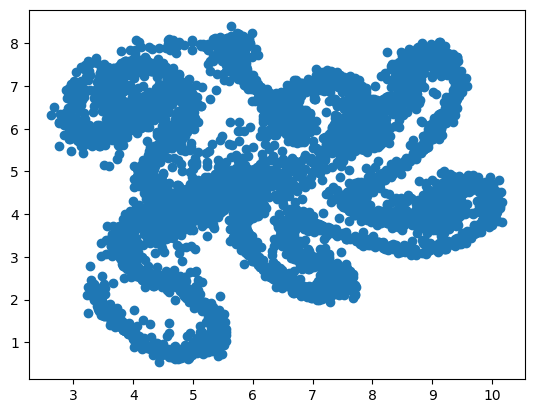

In [71]:
# vq1

plt.scatter(X[:,0], X[:,1])

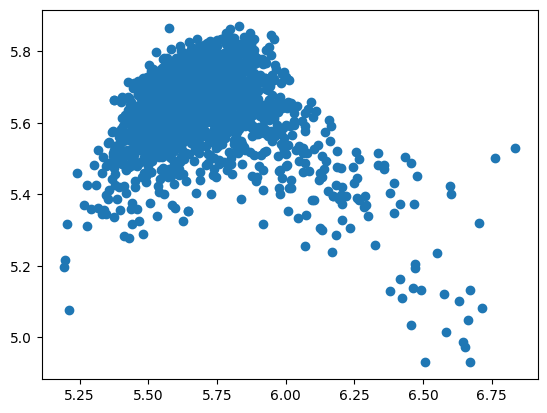

In [72]:
# vq1

plt.scatter(X_test[:,0], X_test[:,1])

FMRP only:

VQ1

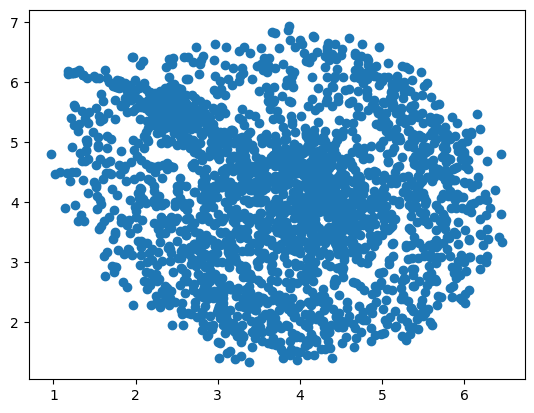

In [63]:
plt.scatter(X[:,0], X[:,1])

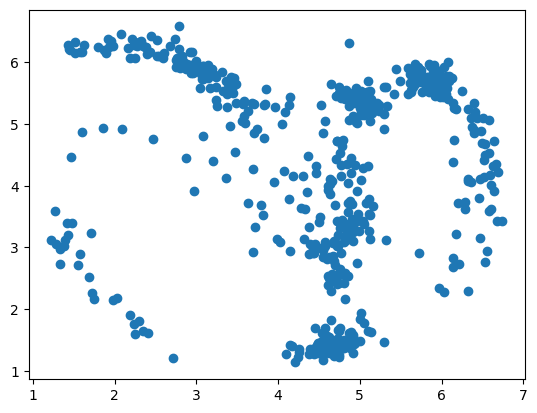

In [64]:
plt.scatter(X_test[:,0], X_test[:,1])

VQ2

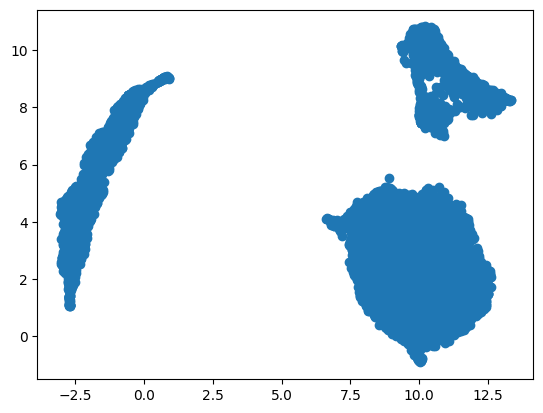

In [43]:
plt.scatter(X[:,0], X[:,1])

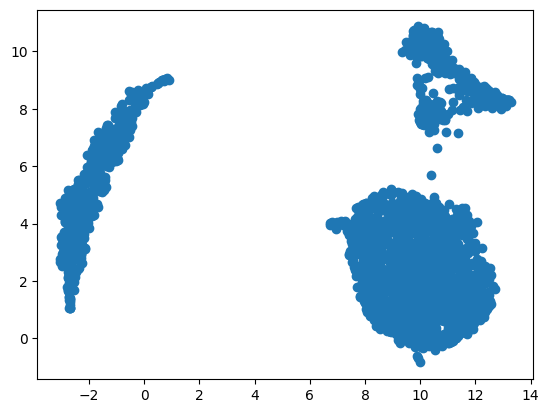

In [44]:
plt.scatter(X_test[:,0], X_test[:,1])

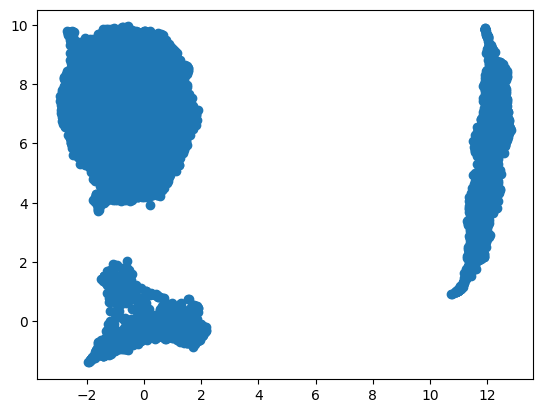

In [38]:
plt.scatter(X[:,0], X[:,1])

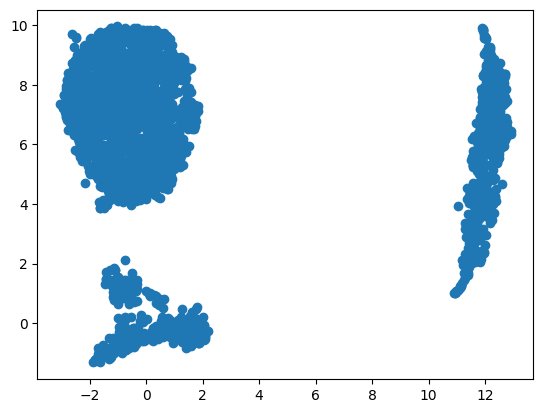

In [39]:
plt.scatter(X_test[:,0], X_test[:,1])

---

In [ ]:
embeddings_merged = np.vstack([embeddings, embeddings_test])
y_merged = np.vstack([y, labels_test])
embeddings_merged.shape, y_merged.shape

In [ ]:

from sklearn.manifold import MDS
from umap import UMAP

reducer = UMAP(n_components=2, random_state=1).fit(embeddings_merged)


In [21]:
X = reducer.embedding_
X.shape

(9552, 2)

In [52]:

from sklearn.manifold import MDS
from umap import UMAP

reducer = UMAP(n_components=2, random_state=1).fit(embeddings.reshape(embeddings.shape[0], -1))


In [53]:
X = reducer.embedding_#reducer.transform(embeddings.reshape(embeddings.shape[0], -1))
X.shape

(7644, 2)

In [54]:
np.save("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/sm_embeddings_b9_fix2_vqvec1_umap2", X)

In [55]:

from sklearn.manifold import MDS
from umap import UMAP

X_test = reducer.transform(embeddings_test.reshape(embeddings_test.shape[0], -1))
X_test.shape

(1908, 2)

In [56]:
np.save("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/sm_embeddings_b9_fix2_vqvec1_test_umap2", X_test)

In [ ]:
embeddings.shape

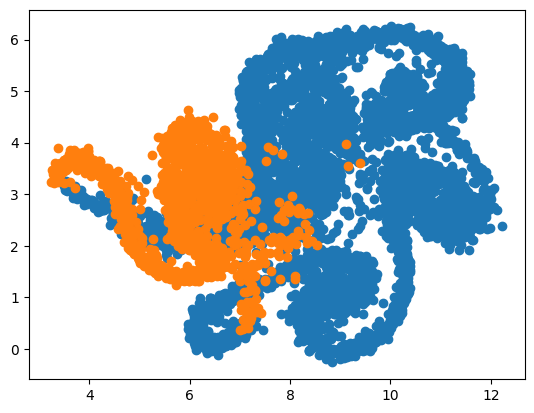

In [22]:
plt.scatter(X[:len(embeddings),0], X[:len(embeddings),1])
plt.scatter(X[len(embeddings):,0], X[len(embeddings):,1])


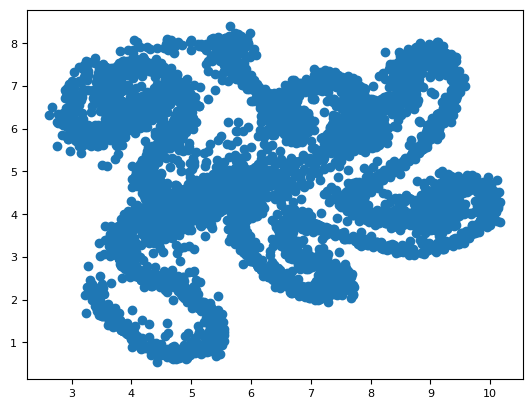

In [57]:
plt.scatter(X[:,0], X[:,1])

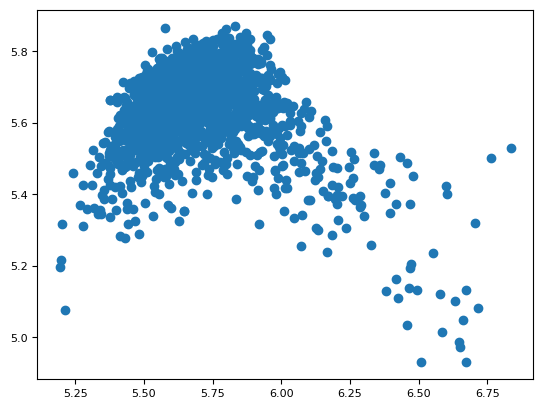

In [58]:
plt.scatter(X_test[:,0], X_test[:,1])

-------- 

#### Save to file

In [22]:
np.save("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/sm_embeddings_b4_vqvec1_umap100", X)

#### Load from file

In [8]:
X = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_embeddings_batch9_16bit_no_downsample_vqvec2_UMAP2.npy")
# X = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/sm_embeddings_b9_vqvec1_umap100.npy")
y = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_labels_batch9_16bit_no_downsample_vqvec2.npy")
# y = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/sm_labels_b9_vqvec1.npy")
X.shape, y.shape

((9553, 2), (9553, 1))

# Load processed data

In [3]:
X9_train = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/sm_embeddings_b9_fix_vqvec1_reduced.npy")
y9_train = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_labels_b9_fix_vqvec1.npy")

X9_test = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/sm_embeddings_b9_fix_vqvec1_test_reduced.npy")
y9_test = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_labels_b9_fix_vqvec1_test.npy")

X6_test = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/sm_embeddings_b6_fix_vqvec1_test_reduced.npy")
y6_test = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_labels_b6_fix_vqvec1_test.npy")

X5_test = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/sandbox/sm_embeddings_b5_fix_vqvec1_test_reduced.npy")
y5_test = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_labels_b5_fix_vqvec1_test.npy")


print(X9_train.shape, y9_train.shape, X9_test.shape, y9_test.shape)
print(X6_test.shape, y6_test.shape)
print(X5_test.shape, y5_test.shape)

(7644, 32, 7, 3, 3) (7644, 1) (1908, 32, 7, 3, 3) (1908, 1)
(1977, 32, 7, 3, 3) (1977, 1)
(1192, 32, 7, 3, 3) (1192, 1)


# Models

## Binary

In [27]:
y_binary = y.copy()
y_binary[np.where(y_binary == ['WT_stress', 'WT_Untreated', 'FUSRevertant_Untreated'])[0]] = 'WT'
y_binary[np.where(y_binary != ['WT'])[0]] = 'ALS'

np.unique(y_binary), y_binary.shape

(array(['ALS', 'WT'], dtype='<U25'), (4486, 1))

b4
RFC
X_train shape (3588, 100), X_test shape: (898, 100), y_train shape: (3588,), y_test shape: (898,)
n_classes =  2, therefore using one hot encoder
(718, 2) (718, 2)
n_classes =  2, therefore using one hot encoder
(718, 2) (718, 2)
n_classes =  2, therefore using one hot encoder
(718, 2) (718, 2)
n_classes =  2, therefore using one hot encoder
(717, 2) (717, 2)
n_classes =  2, therefore using one hot encoder
(717, 2) (717, 2)


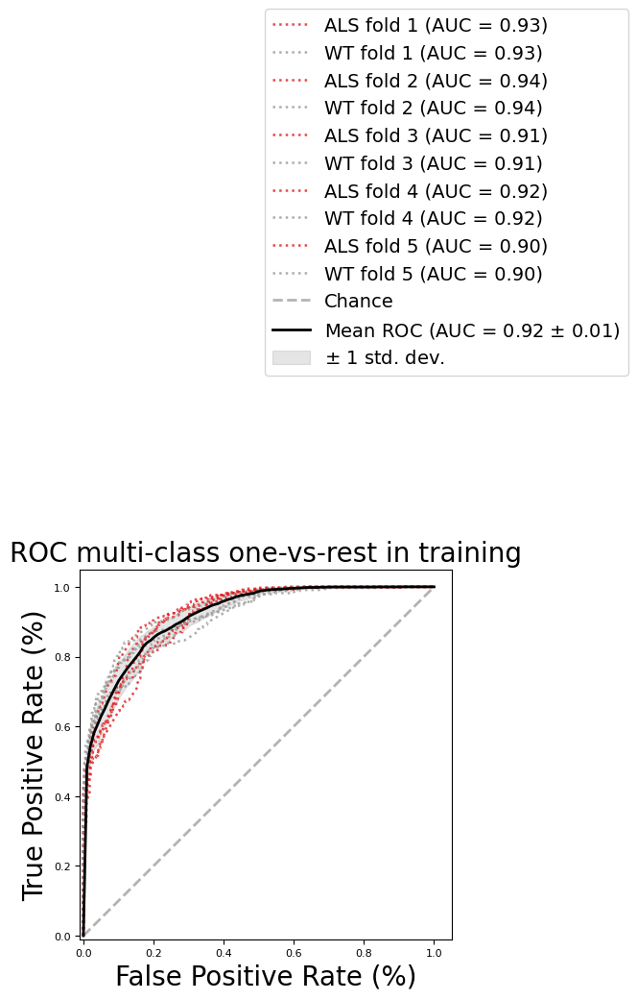



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.92600523 0.92600523 0.93682384 0.93682384 0.91004641 0.91004641
 0.91930058 0.91930058 0.90475669 0.90475669] Mean: 0.9193865481817289
'nHELDOUT SET - Classification Report: 
              precision    recall  f1-score   support

         ALS       0.77      0.92      0.84       482
          WT       0.88      0.68      0.77       416

    accuracy                           0.81       898
   macro avg       0.83      0.80      0.81       898
weighted avg       0.82      0.81      0.81       898

HELDOUT SET - Multilabel Confusion Matrix: 
[[[284 132]
  [ 37 445]]

 [[445  37]
  [132 284]]]
['ALS' 'WT']


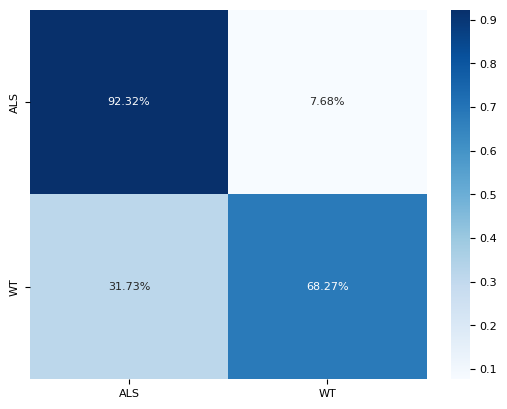

MLP
X_train shape (3588, 100), X_test shape: (898, 100), y_train shape: (3588,), y_test shape: (898,)
n_classes =  2, therefore using one hot encoder
(718, 2) (718, 2)
n_classes =  2, therefore using one hot encoder
(718, 2) (718, 2)
n_classes =  2, therefore using one hot encoder
(718, 2) (718, 2)
n_classes =  2, therefore using one hot encoder
(717, 2) (717, 2)
n_classes =  2, therefore using one hot encoder
(717, 2) (717, 2)


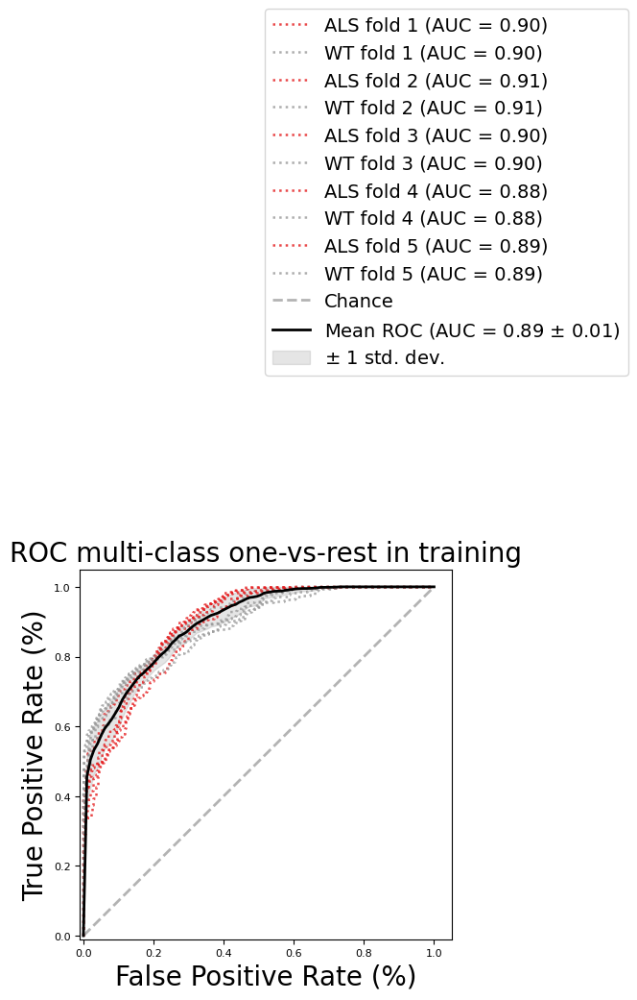



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.9030225  0.9030225  0.90921571 0.90921571 0.9006396  0.9006396
 0.87677985 0.87677985 0.89311532 0.89311532] Mean: 0.8965545955907401
'nHELDOUT SET - Classification Report: 
              precision    recall  f1-score   support

         ALS       0.79      0.86      0.82       482
          WT       0.82      0.73      0.77       416

    accuracy                           0.80       898
   macro avg       0.80      0.80      0.80       898
weighted avg       0.80      0.80      0.80       898

HELDOUT SET - Multilabel Confusion Matrix: 
[[[304 112]
  [ 67 415]]

 [[415  67]
  [112 304]]]
['ALS' 'WT']


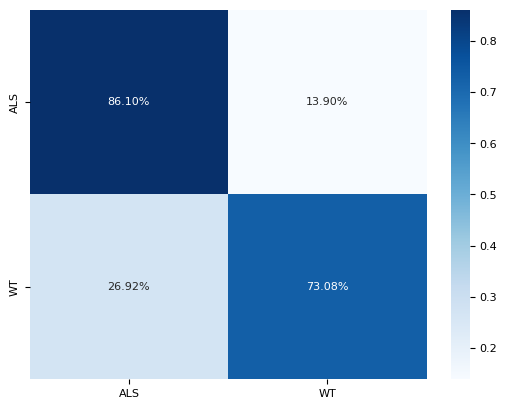

In [29]:
print("b4")
print("RFC")
fit_eval(rfc, X, y_binary.reshape(-1,))
print("MLP")
fit_eval(mlp, X, y_binary.reshape(-1,))

In [28]:
from sklearn.neural_network import MLPClassifier

mlp = MLPClassifier(hidden_layer_sizes=(20,), activation='relu', random_state=1, learning_rate='adaptive', max_iter=300)
# mlp.fit(X_train, y_train)

from sklearn.ensemble import RandomForestClassifier

rfc = RandomForestClassifier(n_estimators=10, max_depth=3, random_state=1)

RFC
X_train shape (7642, 100), X_test shape: (1911, 100), y_train shape: (7642,), y_test shape: (1911,)
n_classes =  2, therefore using one hot encoder
(1529, 2) (1529, 2)
n_classes =  2, therefore using one hot encoder
(1529, 2) (1529, 2)
n_classes =  2, therefore using one hot encoder
(1528, 2) (1528, 2)
n_classes =  2, therefore using one hot encoder
(1528, 2) (1528, 2)
n_classes =  2, therefore using one hot encoder
(1528, 2) (1528, 2)


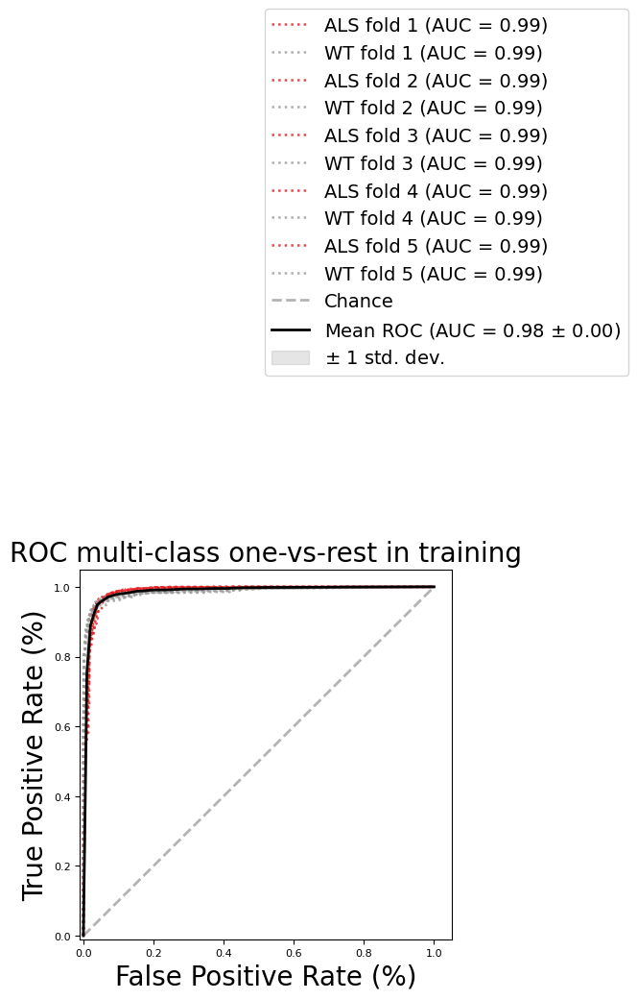



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.98610612 0.98610612 0.98681937 0.98681937 0.99109512 0.99109512
 0.98694857 0.98694857 0.98728645 0.98728645] Mean: 0.9876511258874521
'nHELDOUT SET - Classification Report: 
              precision    recall  f1-score   support

         ALS       0.95      0.99      0.97      1316
          WT       0.98      0.88      0.93       595

    accuracy                           0.96      1911
   macro avg       0.96      0.94      0.95      1911
weighted avg       0.96      0.96      0.96      1911

HELDOUT SET - Multilabel Confusion Matrix: 
[[[ 526   69]
  [  13 1303]]

 [[1303   13]
  [  69  526]]]
['ALS' 'WT']


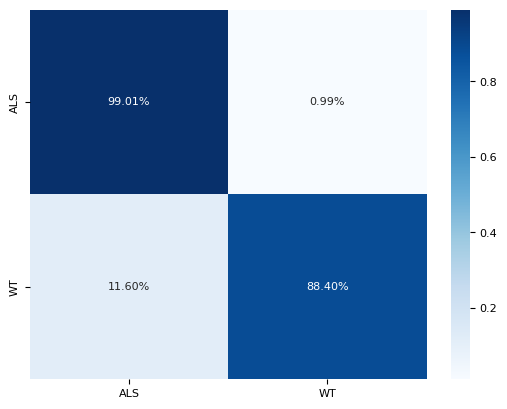

MLP
X_train shape (7642, 100), X_test shape: (1911, 100), y_train shape: (7642,), y_test shape: (1911,)
n_classes =  2, therefore using one hot encoder
(1529, 2) (1529, 2)
n_classes =  2, therefore using one hot encoder
(1529, 2) (1529, 2)
n_classes =  2, therefore using one hot encoder
(1528, 2) (1528, 2)
n_classes =  2, therefore using one hot encoder
(1528, 2) (1528, 2)
n_classes =  2, therefore using one hot encoder
(1528, 2) (1528, 2)


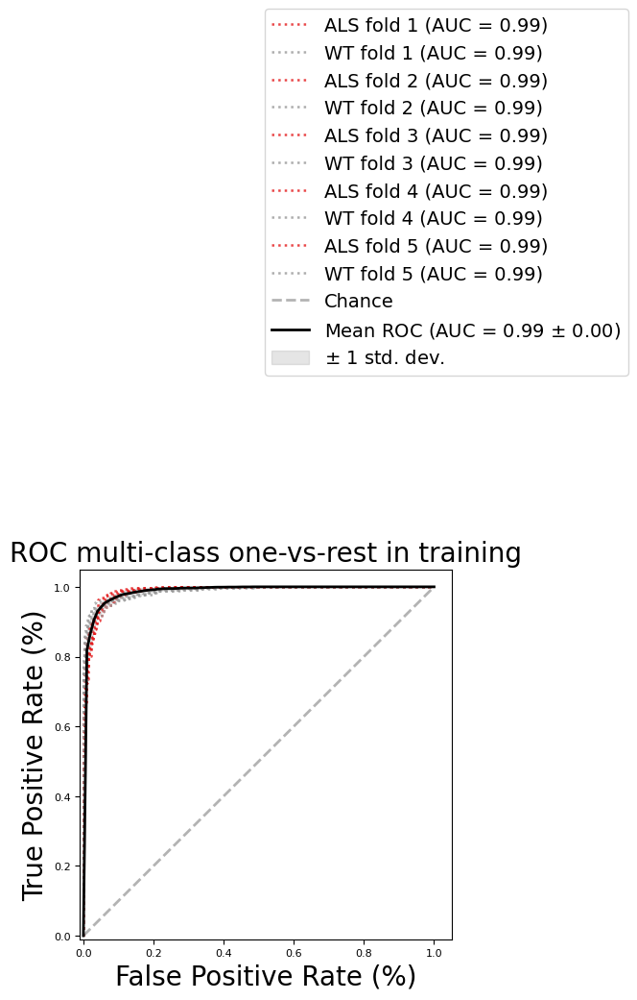



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.98838652 0.98838652 0.98653706 0.98653706 0.99274054 0.99274054
 0.98949768 0.98949768 0.98836007 0.98836007] Mean: 0.9891043756533952
'nHELDOUT SET - Classification Report: 
              precision    recall  f1-score   support

         ALS       0.96      0.97      0.97      1316
          WT       0.93      0.92      0.92       595

    accuracy                           0.95      1911
   macro avg       0.95      0.94      0.95      1911
weighted avg       0.95      0.95      0.95      1911

HELDOUT SET - Multilabel Confusion Matrix: 
[[[ 545   50]
  [  39 1277]]

 [[1277   39]
  [  50  545]]]
['ALS' 'WT']


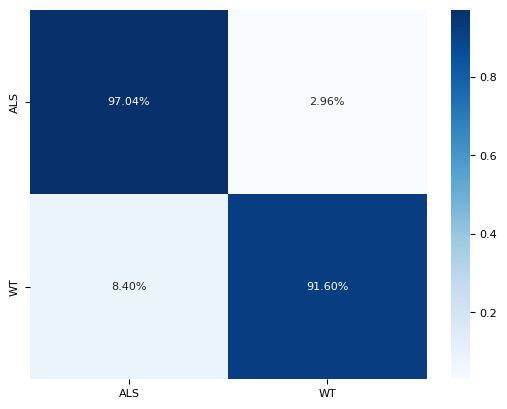

In [36]:
print("RFC")
fit_eval(rfc, X, y_binary.reshape(-1,))
print("MLP")
fit_eval(mlp, X, y_binary.reshape(-1,))

################## 2 UMAPS ##################
X_train shape (7642, 100), X_test shape: (1911, 100), y_train shape: (7642,), y_test shape: (1911,)
n_classes =  2, therefore using one hot encoder
(1529, 2) (1529, 2)
n_classes =  2, therefore using one hot encoder
(1529, 2) (1529, 2)
n_classes =  2, therefore using one hot encoder
(1528, 2) (1528, 2)
n_classes =  2, therefore using one hot encoder
(1528, 2) (1528, 2)
n_classes =  2, therefore using one hot encoder
(1528, 2) (1528, 2)


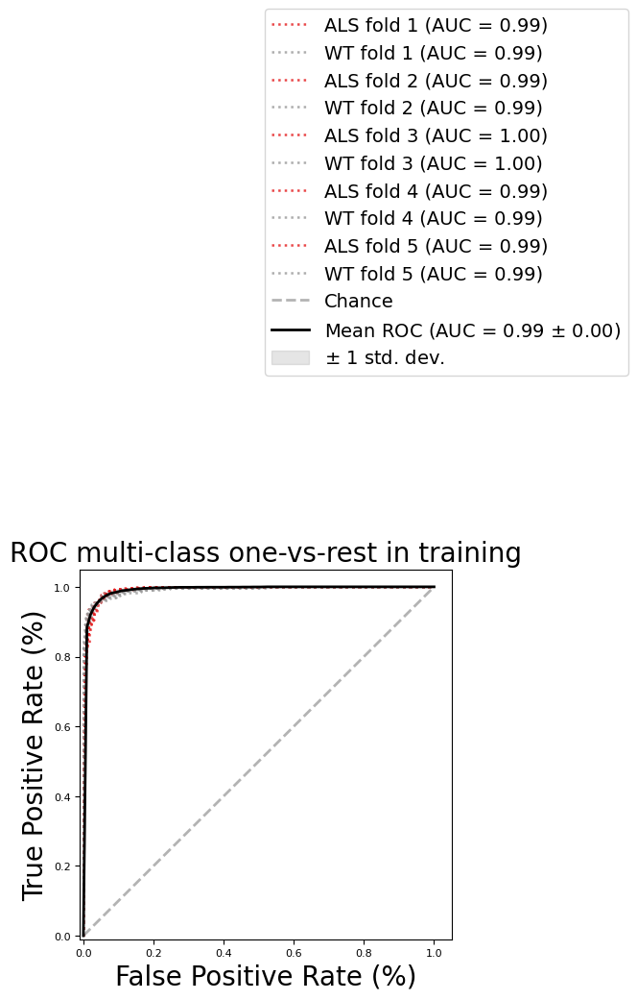



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.99267798 0.99267798 0.99296528 0.99296528 0.99512171 0.99512171
 0.99324836 0.99324836 0.9922907  0.9922907 ] Mean: 0.9932608057768016
'nHELDOUT SET - Classification Report: 
              precision    recall  f1-score   support

         ALS       0.96      0.98      0.97      1316
          WT       0.96      0.91      0.94       595

    accuracy                           0.96      1911
   macro avg       0.96      0.95      0.95      1911
weighted avg       0.96      0.96      0.96      1911

HELDOUT SET - Multilabel Confusion Matrix: 
[[[ 542   53]
  [  22 1294]]

 [[1294   22]
  [  53  542]]]
['ALS' 'WT']


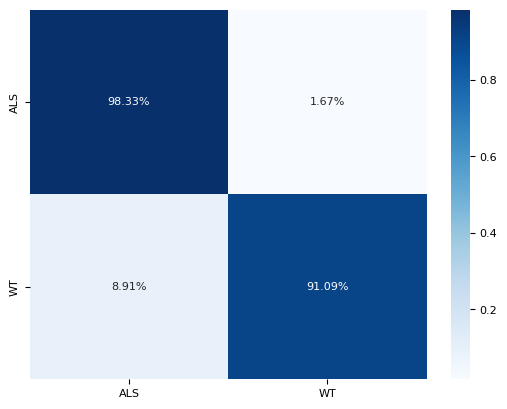

In [33]:
# X100 = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_embeddings_batch9_16bit_no_downsample_vqvec2_UMAP100.npy")



svc = SVC(kernel='rbf', random_state=1, probability=True)
fit_eval(svc, X, y_binary.reshape(-1,))

# print("################## 100 UMAPS ##################") # Might be worse since SVC isn't strong enough for 100 features?
# svc = SVC(kernel='rbf', random_state=1, probability=True)
# fit_eval(svc, X100, y_binary)

# print("!!!! MLP !!!")
# fit_eval(mlp, X100, y_binary)


# Multiclass

In [5]:
from sklearn.neural_network import MLPClassifier

#b9 b5 AE


mlp = MLPClassifier(hidden_layer_sizes=(100,), activation='relu', random_state=1, learning_rate='adaptive', max_iter=300)
fit_eval(mlp, X9_train.reshape(X9_train.shape[0], -1), y9_train.reshape(y9_train.shape[0], -1), X5_test.reshape(X5_test.shape[0], -1), y5_test.reshape(y5_test.shape[0], -1))

X_train shape (7644, 2016), X_test shape: (1192, 2016), y_train shape: (7644,), y_test shape: (1192,)
Using label binarize
(1529, 9) (1529, 9)
Using label binarize
(1529, 9) (1529, 9)
Using label binarize
(1529, 9) (1529, 9)


X_train shape (7644, 2016), X_test shape: (1977, 2016), y_train shape: (7644,), y_test shape: (1977,)
Using label binarize
(1529, 9) (1529, 9)
Using label binarize
(1529, 9) (1529, 9)
Using label binarize
(1529, 9) (1529, 9)
Using label binarize
(1529, 9) (1529, 9)
Using label binarize
(1528, 9) (1528, 9)


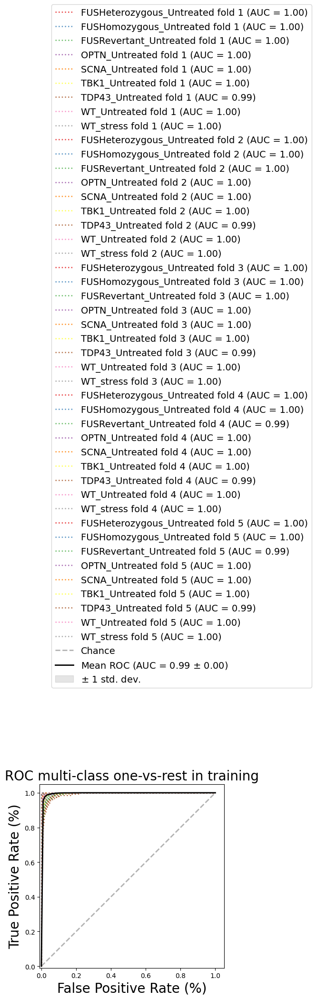



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.99992902 0.99995106 0.99594407 0.99846396 0.99942007 0.99750717
 0.9910079  0.99848349 0.99996468 0.9999454  0.99998165 0.99670208
 0.99802859 0.99989017 0.99853117 0.99344968 0.99882218 0.99991978
 0.9996287  0.99983787 0.99540741 0.99872788 0.99992893 0.99796394
 0.99476628 0.99823144 0.99988969 0.99982527 0.99987458 0.99470085
 0.99754022 0.99998062 0.99756986 0.99006947 0.99825712 0.99999499
 0.99997268 1.         0.99466857 0.99890657 0.99971961 0.99758287
 0.99392614 0.998486   0.99977279] Mean: 0.9980260540686495
Validating - Validate classifier

------------------
y_pred_prob.shape = (1977, 9)
y_pred shape: (1977,)

Balanced accuracy score: 0.7235330775803054. 
Balanced accuracy score (adjusted): 0.6889747122778437


One-vs-One ROC AUC scores:
0.973886 (macro),
0.972605 (weighted by prevalence)


One-vs-Rest ROC AUC scores:
0.972579 (macro),
0.970632 (weighted by prevalence)


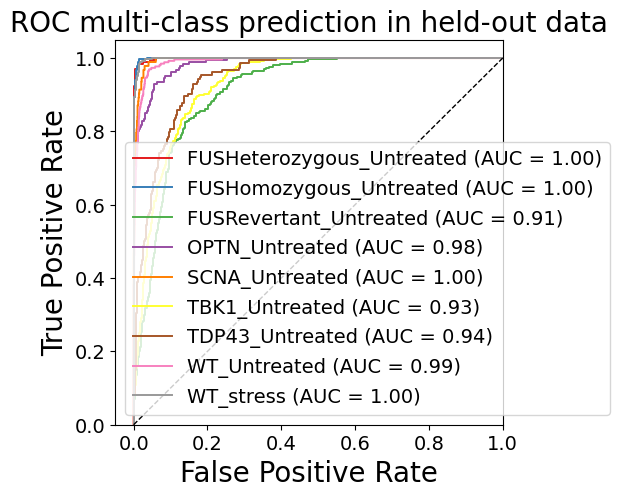

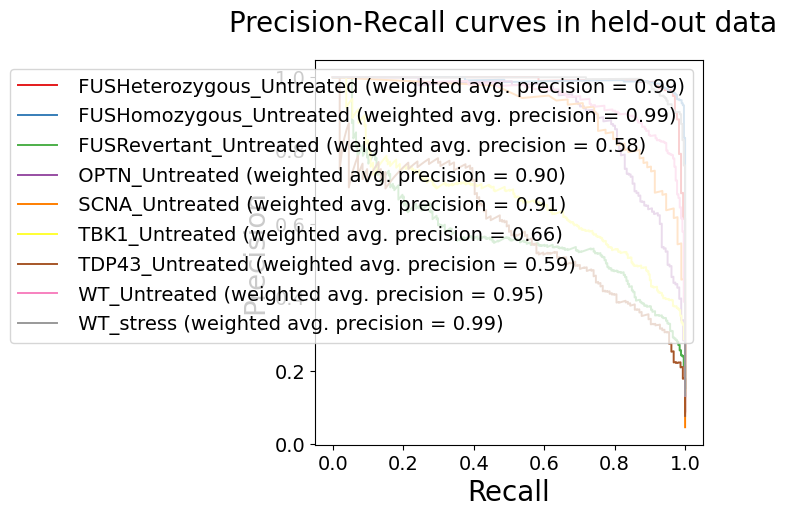

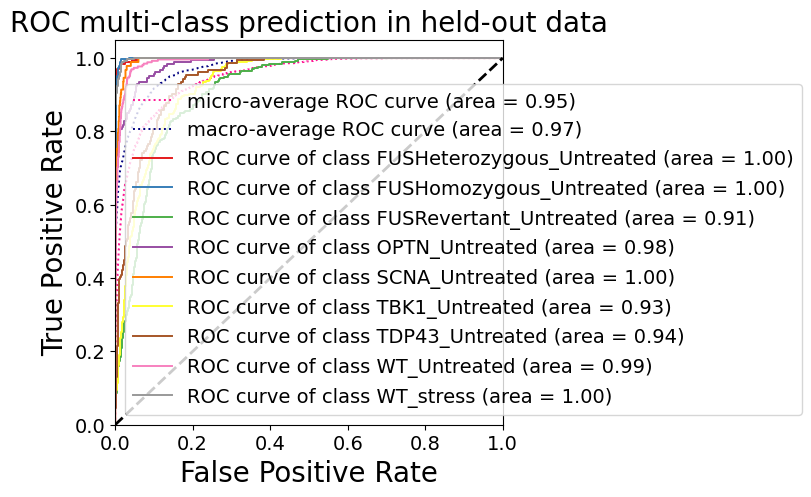


HELDOUT SET - AUC ROC scores of each class: {0: 0.9987375517475616, 1: 0.9986452795167836, 2: 0.9119440273099106, 3: 0.9847912488156616, 4: 0.9950517087870694, 5: 0.9298918480132503, 6: 0.944272677404877, 7: 0.9912658847617564, 8: 0.9986068654027889, 'micro': 0.9489199933018279, 'macro': 0.9727373888928936}
'nHELDOUT SET - Classification Report: 
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.96      0.95      0.96       173
  FUSHomozygous_Untreated       0.97      0.94      0.95       304
   FUSRevertant_Untreated       0.56      0.49      0.52       258
           OPTN_Untreated       0.98      0.60      0.74       181
           SCNA_Untreated       0.27      1.00      0.42        93
           TBK1_Untreated       0.81      0.10      0.18       289
          TDP43_Untreated       0.62      0.47      0.53       154
             WT_Untreated       0.66      0.98      0.79       262
                WT_stress       0.88      0.99

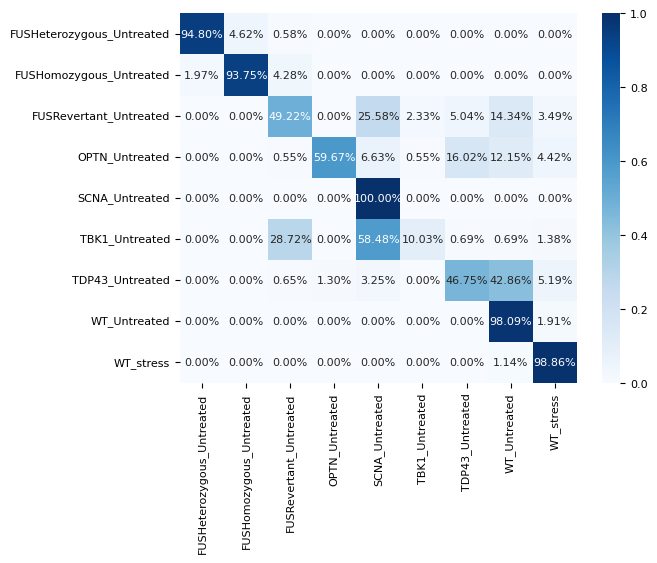


HELDOUT SET - One-vs-rest Confusion Matrix:
[[164   8   1   0   0   0   0   0   0]
 [  6 285  13   0   0   0   0   0   0]
 [  0   0 127   0  66   6  13  37   9]
 [  0   0   1 108  12   1  29  22   8]
 [  0   0   0   0  93   0   0   0   0]
 [  0   0  83   0 169  29   2   2   4]
 [  0   0   1   2   5   0  72  66   8]
 [  0   0   0   0   0   0   0 257   5]
 [  0   0   0   0   0   0   0   3 260]]
Sensitivity, hit rate, recall, or true positive rate: [0.94797688 0.9375     0.49224806 0.59668508 1.         0.10034602
 0.46753247 0.98091603 0.98859316]
Specificity or true negative rate: [0.99667406 0.99521817 0.94240838 0.99888641 0.86624204 0.99585308
 0.97586396 0.92419825 0.98016336]
Precision or positive predictive value: [0.96470588 0.97269625 0.5619469  0.98181818 0.26956522 0.80555556
 0.62068966 0.66408269 0.88435374]
Negative predictive value: [0.99501937 0.98871734 0.92518561 0.96089984 1.         0.86604843
 0.95593767 0.99685535 0.99821747]
Fall out or false positive rate: [0.003

MLPClassifier(learning_rate='adaptive', max_iter=300, random_state=1)

In [4]:
from sklearn.neural_network import MLPClassifier

#b9 b9 AE


mlp = MLPClassifier(hidden_layer_sizes=(100,), activation='relu', random_state=1, learning_rate='adaptive', max_iter=300)
fit_eval(mlp, X9_train.reshape(X9_train.shape[0], -1), y9_train.reshape(y9_train.shape[0], -1), X6_test.reshape(X6_test.shape[0], -1), y6_test.reshape(y6_test.shape[0], -1))

### Models

Proper train test split

#### PCA

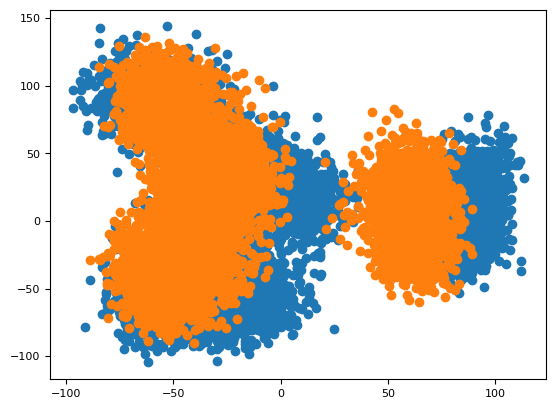

In [19]:
plt.scatter(X[:,0], X[:,1])
plt.scatter(X6[:,0], X6[:,1])

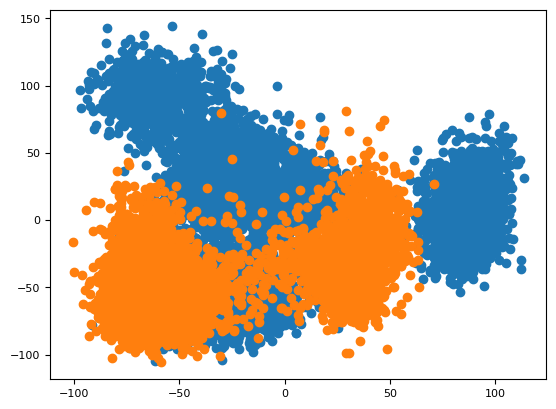

In [20]:
plt.scatter(X[:,0], X[:,1])
plt.scatter(X5[:,0], X5[:,1])

In [60]:
y_try = y.copy()
# y_try = np.where(y == 'FUSRevertant_Untreated', 'WT_Untreated', y_try)
scna_ind = np.where(y_try == 'SCNA_Untreated')[0]
y_try = np.delete(y_try, scna_ind, axis=0)
print(np.unique(y_try))
X_try = np.delete(X, scna_ind, axis=0)
print(X_try.shape)

labels6_try = labels6.copy()
# labels6_try = np.where(labels6 == 'FUSRevertant_Untreated', 'WT_Untreated', labels6_try)
scna6_ind = np.where(labels6_try == 'SCNA_Untreated')[0]
labels6_try = np.delete(labels6_try, scna6_ind, axis=0)
print(np.unique(labels6_try))
X6_try = np.delete(X6, scna6_ind, axis=0)
print(X6_try.shape)


['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated' 'WT_stress']
(7101, 1000)
['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated' 'WT_stress']
(9424, 1000)


In [61]:

labels5_try = labels5.copy()
# labels5_try = np.where(labels5 == 'FUSRevertant_Untreated', 'WT_Untreated', labels5_try)
scna5_ind = np.where(labels5_try == 'SCNA_Untreated')[0]
labels5_try = np.delete(labels5_try, scna5_ind, axis=0)
print(np.unique(labels5_try))
X5_try = np.delete(X5, scna5_ind, axis=0)
print(X5_try.shape)


['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated' 'WT_stress']
(5944, 1000)


In [62]:

labels_test_try = labels_test.copy()
# labels_test_try = np.where(labels_test == 'FUSRevertant_Untreated', 'WT_Untreated', labels_test_try)
scna_test_ind = np.where(labels_test_try == 'SCNA_Untreated')[0]
labels_test_try = np.delete(labels_test_try, scna_test_ind, axis=0)
print(np.unique(labels_test_try))
X_test_try = np.delete(X_test, scna_test_ind, axis=0)
print(X_test_try.shape)


['FUSHeterozygous_Untreated' 'FUSHomozygous_Untreated'
 'FUSRevertant_Untreated' 'OPTN_Untreated' 'TBK1_Untreated'
 'TDP43_Untreated' 'WT_Untreated' 'WT_stress']
(1773, 1000)


X_train shape (7101, 1000), X_test shape: (1773, 1000), y_train shape: (7101,), y_test shape: (1773,)
Using label binarize
(1421, 8) (1421, 8)
Using label binarize
(1420, 8) (1420, 8)
Using label binarize
(1420, 8) (1420, 8)
Using label binarize
(1420, 8) (1420, 8)
Using label binarize
(1420, 8) (1420, 8)


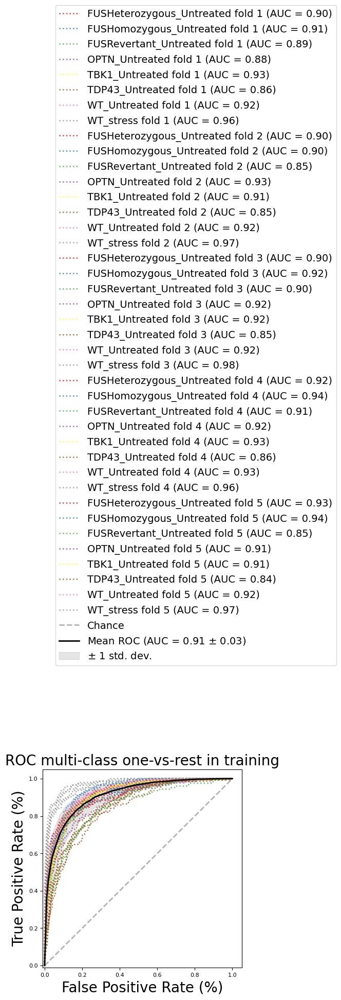



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.90000888 0.9114903  0.89126678 0.87774376 0.93161846 0.86344127
 0.9239622  0.96122096 0.90373625 0.89793102 0.85253674 0.92620839
 0.91263579 0.85093111 0.92049894 0.96629995 0.90224388 0.9191896
 0.89784093 0.91982774 0.9171739  0.84794152 0.92480814 0.97595161
 0.91741038 0.93833538 0.90724633 0.92015989 0.92578616 0.86279059
 0.93052534 0.95812652 0.92593821 0.93586458 0.84764788 0.90612688
 0.91091236 0.84467807 0.92166232 0.97295422] Mean: 0.9105668309256331
Validating - Validate classifier

------------------
y_pred_prob.shape = (1773, 8)
y_pred shape: (1773,)

Balanced accuracy score: 0.8899175727648687. 
Balanced accuracy score (adjusted): 0.8741915117312785


One-vs-One ROC AUC scores:
0.989903 (macro),
0.990533 (weighted by prevalence)


One-vs-Rest ROC AUC scores:
0.990369 (macro),
0.991305 (weighted by prevalence)


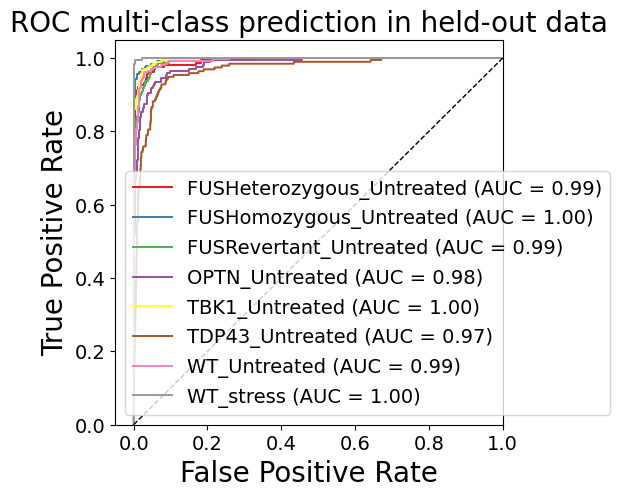

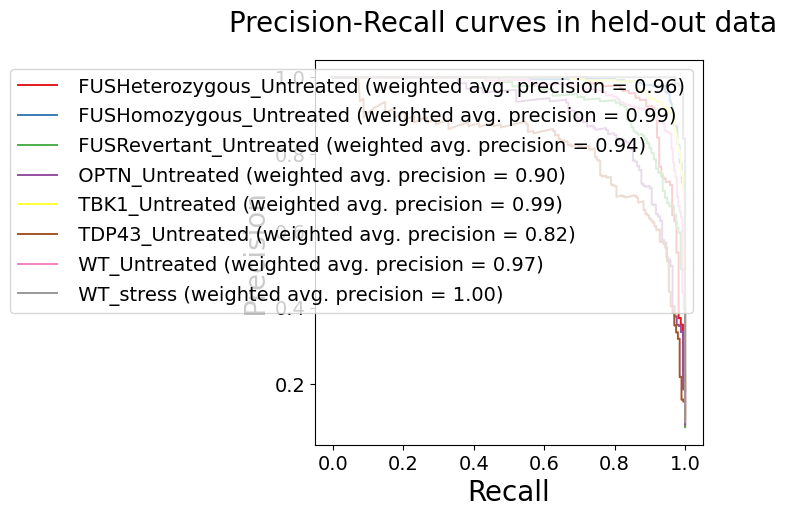

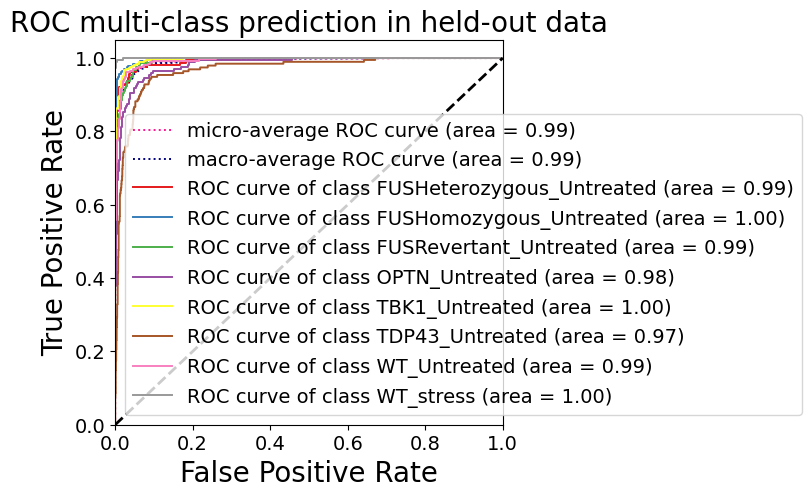


HELDOUT SET - AUC ROC scores of each class: {0: 0.9926037419502343, 1: 0.9972687795542511, 2: 0.9932718988459356, 3: 0.982945742153492, 4: 0.9960989059337694, 5: 0.9681729550550844, 6: 0.9927674162765113, 7: 0.9998247618513559, 'micro': 0.9917310176829016, 'macro': 0.9906096860083946}
'nHELDOUT SET - Classification Report: 
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.92      0.91      0.92       163
  FUSHomozygous_Untreated       0.96      0.94      0.95       321
   FUSRevertant_Untreated       0.85      0.86      0.85       157
           OPTN_Untreated       0.81      0.85      0.83       169
           TBK1_Untreated       0.92      0.94      0.93       331
          TDP43_Untreated       0.82      0.69      0.75       195
             WT_Untreated       0.88      0.93      0.91       258
                WT_stress       0.96      0.99      0.98       179

                 accuracy                           0.90      1773
 

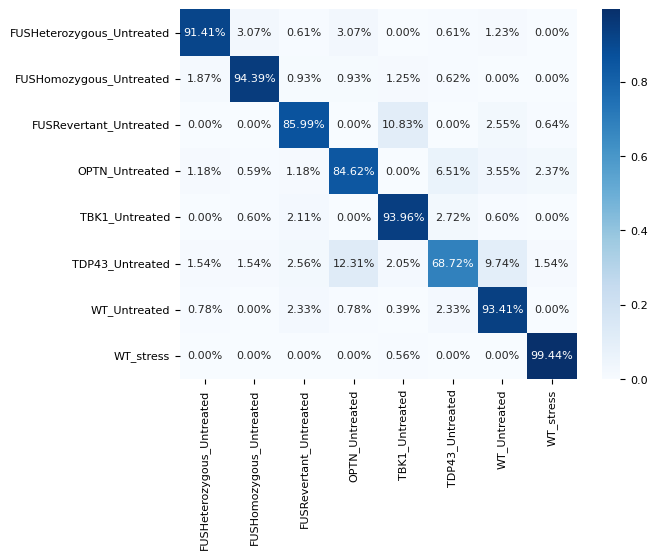


HELDOUT SET - One-vs-rest Confusion Matrix:
[[149   5   1   5   0   1   2   0]
 [  6 303   3   3   4   2   0   0]
 [  0   0 135   0  17   0   4   1]
 [  2   1   2 143   0  11   6   4]
 [  0   2   7   0 311   9   2   0]
 [  3   3   5  24   4 134  19   3]
 [  2   0   6   2   1   6 241   0]
 [  0   0   0   0   1   0   0 178]]
Sensitivity, hit rate, recall, or true positive rate: [0.91411043 0.94392523 0.85987261 0.84615385 0.93957704 0.68717949
 0.93410853 0.99441341]
Specificity or true negative rate: [0.99192547 0.99242424 0.98514851 0.97880299 0.98127601 0.98162231
 0.97821782 0.99498118]
Precision or positive predictive value: [0.91975309 0.96496815 0.8490566  0.8079096  0.92011834 0.82208589
 0.87956204 0.95698925]
Negative predictive value: [0.99130975 0.98766278 0.98636927 0.98370927 0.98606272 0.9621118
 0.98865911 0.99936988]
Fall out or false positive rate: [0.00807453 0.00757576 0.01485149 0.02119701 0.01872399 0.01837769
 0.02178218 0.00501882]
False negative rate: [0.0858895

In [63]:
from sklearn.neural_network import MLPClassifier

#b9 b9


mlp = MLPClassifier(hidden_layer_sizes=(50,), activation='relu', random_state=1, learning_rate='adaptive', max_iter=300)
fit_eval(mlp, X_try, y_try, X_test_try, labels_test_try)

X_train shape (7101, 1000), X_test shape: (5944, 1000), y_train shape: (7101,), y_test shape: (5944,)
Using label binarize
(1421, 8) (1421, 8)
Using label binarize
(1420, 8) (1420, 8)
Using label binarize
(1420, 8) (1420, 8)
Using label binarize
(1420, 8) (1420, 8)
Using label binarize
(1420, 8) (1420, 8)


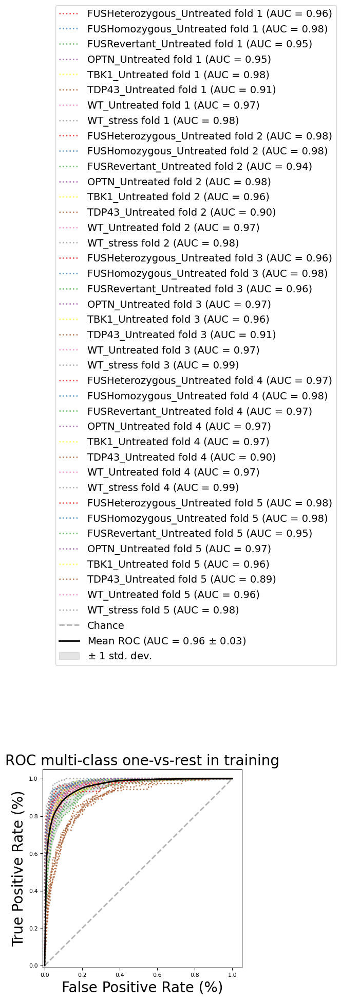



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.96095035 0.98233316 0.94814917 0.9540341  0.98239864 0.91284585
 0.96778737 0.98363406 0.97719991 0.97706354 0.94149125 0.97554979
 0.95962754 0.89933514 0.96709958 0.98383997 0.95829361 0.97858584
 0.95746409 0.97110363 0.96358736 0.9068256  0.97198028 0.98594006
 0.97432177 0.97629905 0.96861158 0.96554025 0.97163767 0.89811293
 0.96613338 0.99147183 0.97850574 0.98160868 0.9459305  0.96538849
 0.95970922 0.88914669 0.96410206 0.97980342] Mean: 0.9610860789057327
Validating - Validate classifier

------------------
y_pred_prob.shape = (5944, 8)
y_pred shape: (5944,)

Balanced accuracy score: 0.16611487581006457. 
Balanced accuracy score (adjusted): 0.04698842949721665


One-vs-One ROC AUC scores:
0.596744 (macro),
0.573038 (weighted by prevalence)


One-vs-Rest ROC AUC scores:
0.579988 (macro),
0.540830 (weighted by prevalence)


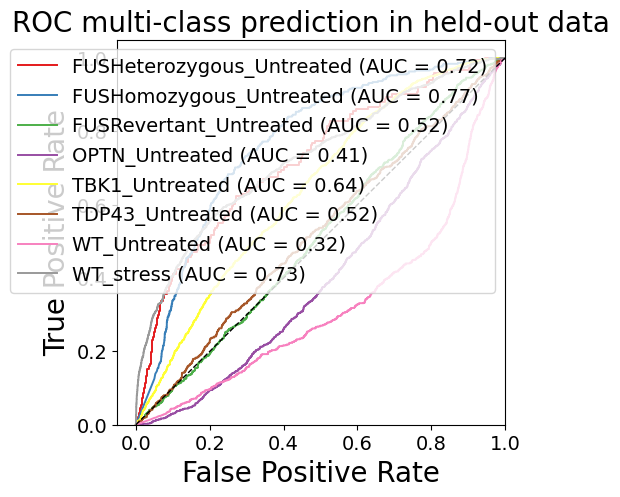

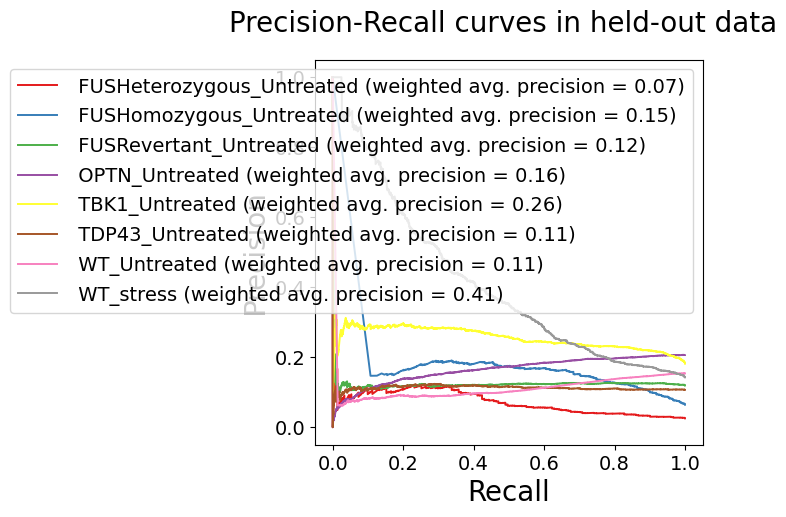

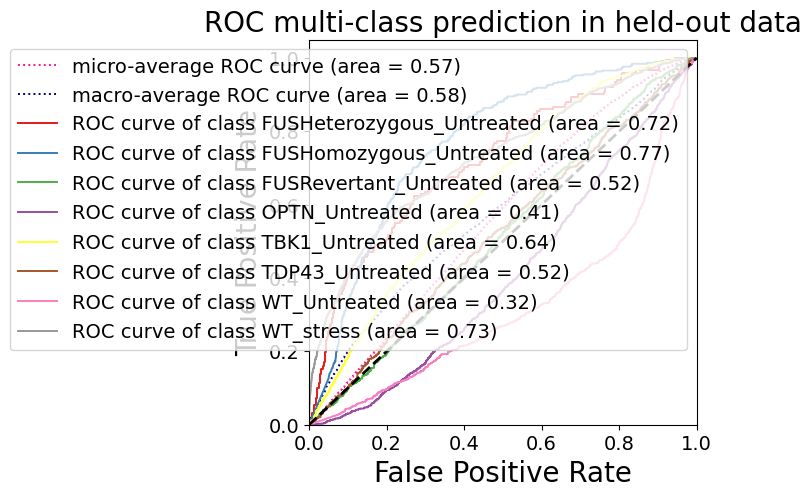


HELDOUT SET - AUC ROC scores of each class: {0: 0.7225047814043668, 1: 0.7690007078699702, 2: 0.5175989063921166, 3: 0.4111982708961618, 4: 0.644111587467746, 5: 0.5234317597661378, 6: 0.3245373492089041, 7: 0.7275215019877654, 'micro': 0.5656023971118764, 'macro': 0.5800848444997293}
'nHELDOUT SET - Classification Report: 
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.06      0.01      0.02       151
  FUSHomozygous_Untreated       0.16      0.66      0.26       382
   FUSRevertant_Untreated       0.12      0.11      0.11       710
           OPTN_Untreated       0.07      0.03      0.04      1226
           TBK1_Untreated       0.29      0.18      0.22      1079
          TDP43_Untreated       0.00      0.00      0.00       635
             WT_Untreated       0.09      0.24      0.13       914
                WT_stress       0.79      0.10      0.18       847

                 accuracy                           0.14      5944
 

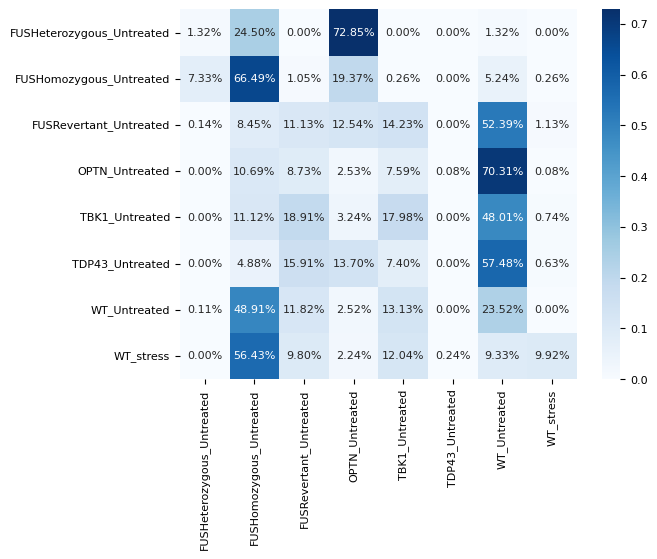


HELDOUT SET - One-vs-rest Confusion Matrix:
[[  2  37   0 110   0   0   2   0]
 [ 28 254   4  74   1   0  20   1]
 [  1  60  79  89 101   0 372   8]
 [  0 131 107  31  93   1 862   1]
 [  0 120 204  35 194   0 518   8]
 [  0  31 101  87  47   0 365   4]
 [  1 447 108  23 120   0 215   0]
 [  0 478  83  19 102   2  79  84]]
Sensitivity, hit rate, recall, or true positive rate: [0.01324503 0.66492147 0.11126761 0.02528548 0.17979611 0.
 0.23522976 0.09917355]
Specificity or true negative rate: [0.99482134 0.76555196 0.88402751 0.90737601 0.90462487 0.99943492
 0.55904573 0.99568374]
Precision or positive predictive value: [0.0625     0.16302953 0.11516035 0.06623932 0.29483283 0.
 0.08836827 0.79245283]
Negative predictive value: [0.97479702 0.97081623 0.87999239 0.78177502 0.83257662 0.89311564
 0.80091142 0.86930456]
Fall out or false positive rate: [0.00517866 0.23444804 0.11597249 0.09262399 0.09537513 0.00056508
 0.44095427 0.00431626]
False negative rate: [0.98675497 0.33507853 0.

In [64]:
from sklearn.neural_network import MLPClassifier

#b5 b9


mlp = MLPClassifier(hidden_layer_sizes=(200,), activation='relu', random_state=1, learning_rate='adaptive', max_iter=300)
fit_eval(mlp, X_try, y_try, X5_try, labels5_try)

X_train shape (7101, 1000), X_test shape: (9424, 1000), y_train shape: (7101,), y_test shape: (9424,)
Using label binarize
(1421, 8) (1421, 8)
Using label binarize
(1420, 8) (1420, 8)
Using label binarize
(1420, 8) (1420, 8)
Using label binarize
(1420, 8) (1420, 8)
Using label binarize
(1420, 8) (1420, 8)


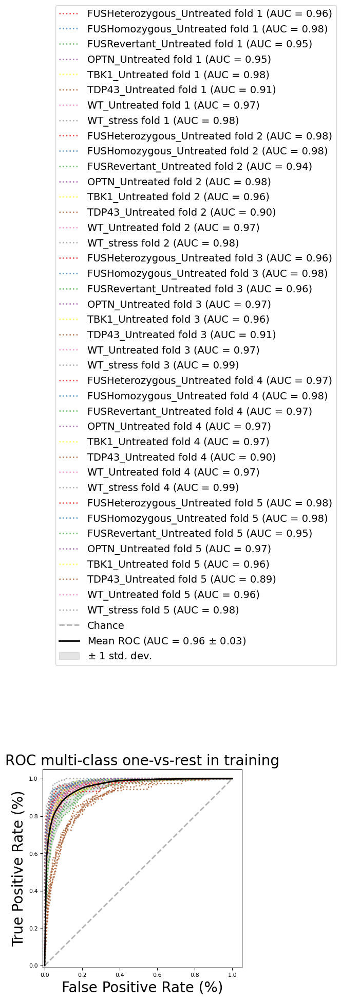



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.96095035 0.98233316 0.94814917 0.9540341  0.98239864 0.91284585
 0.96778737 0.98363406 0.97719991 0.97706354 0.94149125 0.97554979
 0.95962754 0.89933514 0.96709958 0.98383997 0.95829361 0.97858584
 0.95746409 0.97110363 0.96358736 0.9068256  0.97198028 0.98594006
 0.97432177 0.97629905 0.96861158 0.96554025 0.97163767 0.89811293
 0.96613338 0.99147183 0.97850574 0.98160868 0.9459305  0.96538849
 0.95970922 0.88914669 0.96410206 0.97980342] Mean: 0.9610860789057327
Validating - Validate classifier

------------------
y_pred_prob.shape = (9424, 8)
y_pred shape: (9424,)

Balanced accuracy score: 0.5585691766008621. 
Balanced accuracy score (adjusted): 0.4955076304009853


One-vs-One ROC AUC scores:
0.930799 (macro),
0.934517 (weighted by prevalence)


One-vs-Rest ROC AUC scores:
0.932763 (macro),
0.938726 (weighted by prevalence)


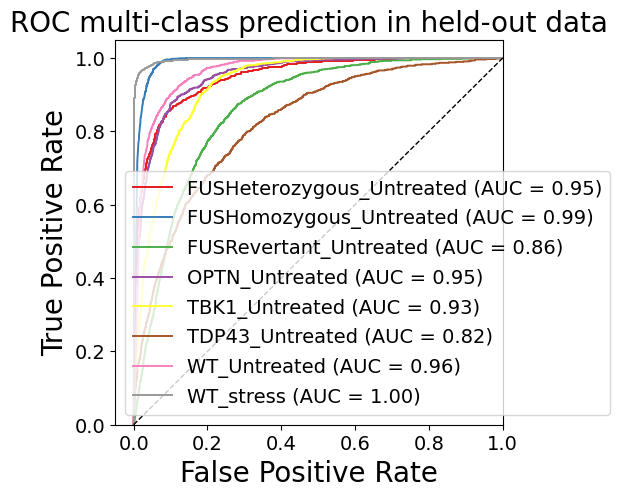

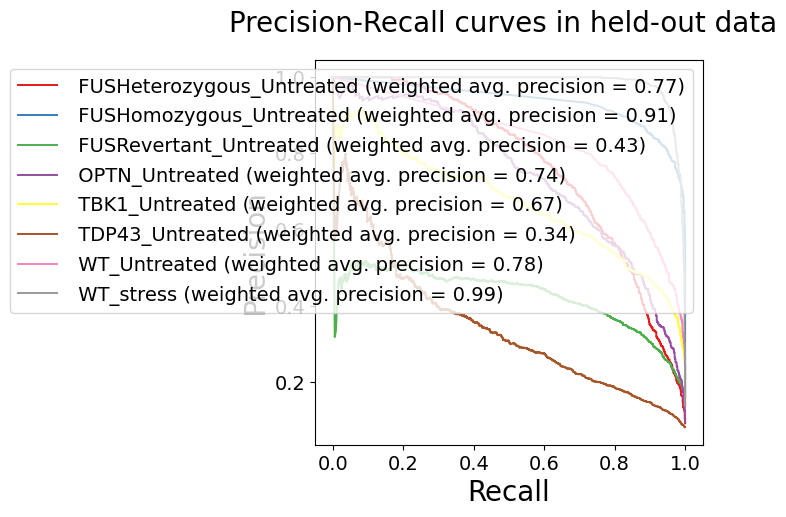

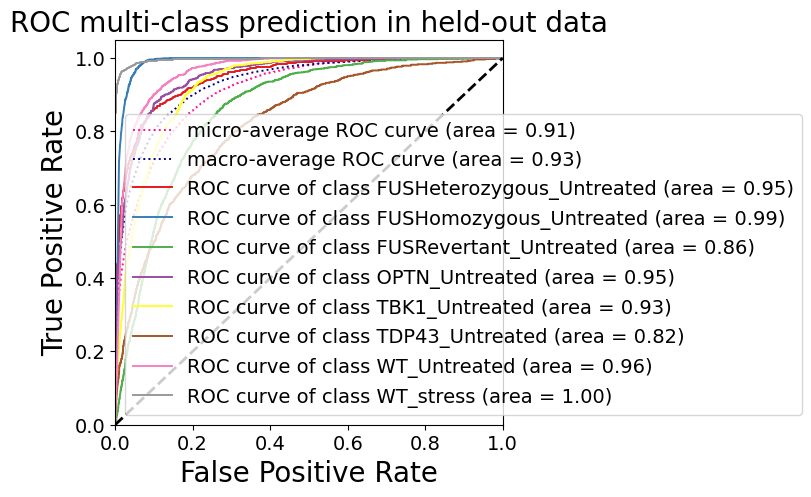


HELDOUT SET - AUC ROC scores of each class: {0: 0.9496828311510073, 1: 0.9882027006780022, 2: 0.8601654256315632, 3: 0.9528162540616495, 4: 0.9272952932493636, 5: 0.8232683438769355, 6: 0.9641343144550713, 7: 0.996541185037545, 'micro': 0.9129917121415456, 'macro': 0.9328349602556165}
'nHELDOUT SET - Classification Report: 
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.96      0.29      0.44       867
  FUSHomozygous_Untreated       0.67      1.00      0.80      1521
   FUSRevertant_Untreated       0.47      0.37      0.41      1291
           OPTN_Untreated       0.85      0.42      0.56       906
           TBK1_Untreated       0.78      0.23      0.35      1447
          TDP43_Untreated       0.43      0.25      0.31       769
             WT_Untreated       0.39      0.98      0.56      1309
                WT_stress       0.96      0.93      0.94      1314

                 accuracy                           0.60      9424
 

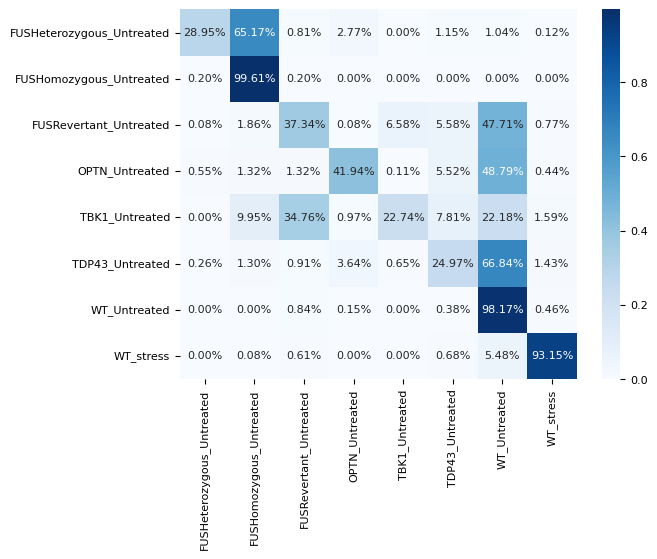


HELDOUT SET - One-vs-rest Confusion Matrix:
[[ 251  565    7   24    0   10    9    1]
 [   3 1515    3    0    0    0    0    0]
 [   1   24  482    1   85   72  616   10]
 [   5   12   12  380    1   50  442    4]
 [   0  144  503   14  329  113  321   23]
 [   2   10    7   28    5  192  514   11]
 [   0    0   11    2    0    5 1285    6]
 [   0    1    8    0    0    9   72 1224]]
Sensitivity, hit rate, recall, or true positive rate: [0.28950404 0.99605523 0.37335399 0.41942605 0.22736697 0.2496749
 0.98166539 0.93150685]
Specificity or true negative rate: [0.9987145  0.90434012 0.93225132 0.99189951 0.9885922  0.9700751
 0.75674677 0.99321825]
Precision or positive predictive value: [0.95801527 0.667107   0.46660213 0.84632517 0.78333333 0.42572062
 0.39429273 0.95699765]
Negative predictive value: [0.93276577 0.99916119 0.90358718 0.94139276 0.87583296 0.93569598
 0.99610706 0.98895028]
Fall out or false positive rate: [0.0012855  0.09565988 0.06774868 0.00810049 0.0114078  0.0

In [65]:
from sklearn.neural_network import MLPClassifier

#b6 b9


mlp = MLPClassifier(hidden_layer_sizes=(200,), activation='relu', random_state=1, learning_rate='adaptive', max_iter=300)
fit_eval(mlp, X_try, y_try, X6_try, labels6_try)

X_train shape (7644, 100), X_test shape: (5964, 100), y_train shape: (7644,), y_test shape: (5964,)
Using label binarize
(1529, 9) (1529, 9)
Using label binarize
(1529, 9) (1529, 9)
Using label binarize
(1529, 9) (1529, 9)
Using label binarize
(1529, 9) (1529, 9)
Using label binarize
(1528, 9) (1528, 9)


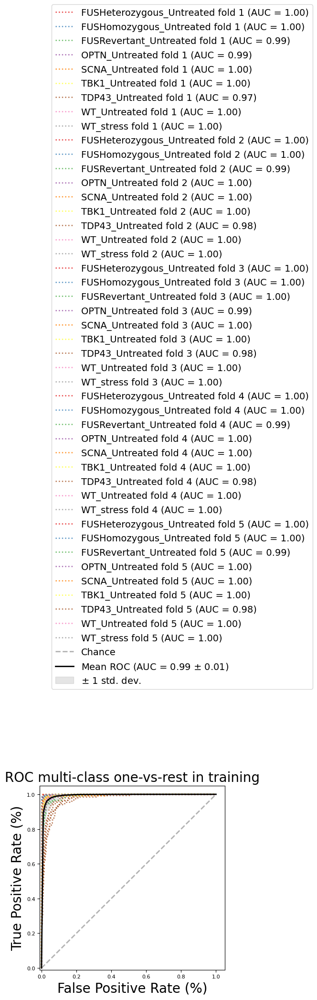



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.99840011 0.99949526 0.99423288 0.99457371 0.9976412  0.99832816
 0.97227669 0.99519283 0.99932391 0.99704867 0.99806059 0.99426399
 0.99504224 0.99918594 0.99569053 0.98155826 0.9961987  0.99986462
 0.99861853 0.99874275 0.99529915 0.99437313 0.99874015 0.99747134
 0.97896708 0.99597304 0.99957882 0.99919733 0.9994402  0.99178917
 0.9953602  0.9951641  0.99553977 0.9770482  0.99764437 0.99983955
 0.99940439 0.99951936 0.99176051 0.99551534 0.99775039 0.99672986
 0.98047488 0.99632104 0.99953043] Mean: 0.994937141988692
Validating - Validate classifier

------------------
y_pred_prob.shape = (5964, 9)
y_pred shape: (5964,)

Balanced accuracy score: 0.10180985087654619. 
Balanced accuracy score (adjusted): -0.01046391776388553


One-vs-One ROC AUC scores:
0.581981 (macro),
0.582021 (weighted by prevalence)


One-vs-Rest ROC AUC scores:
0.567127 (macro),
0.578019 (weighted by prevalence)


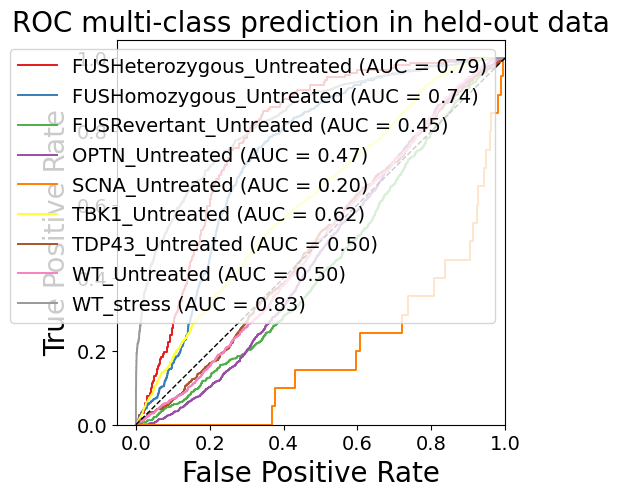

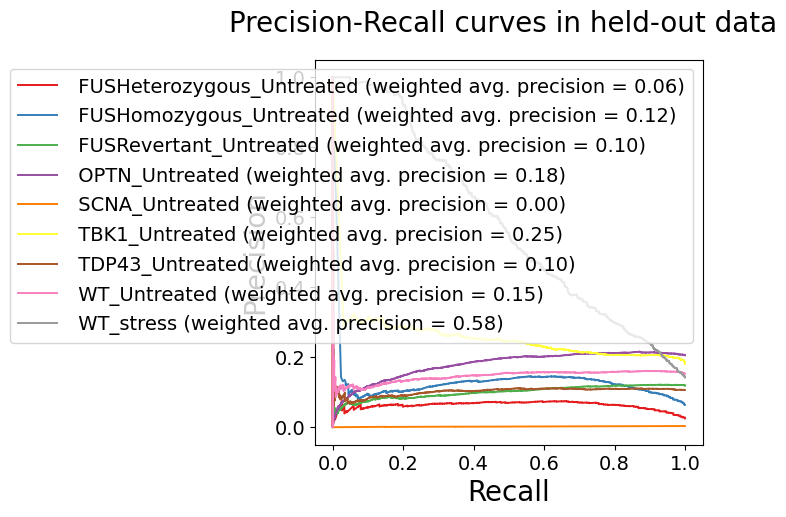

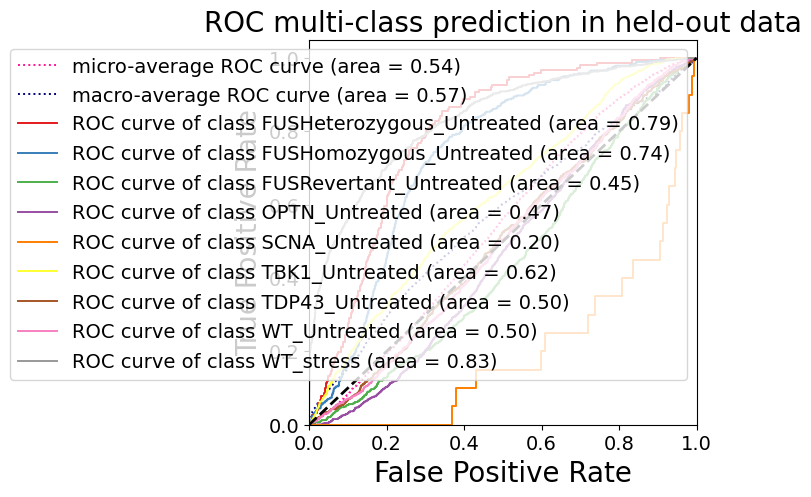


HELDOUT SET - AUC ROC scores of each class: {0: 0.7922753636232104, 1: 0.739260309408889, 2: 0.4454699839692897, 3: 0.4710950029507016, 4: 0.20354138627187077, 5: 0.6166251020932798, 6: 0.5020696441843249, 7: 0.4995931278029335, 8: 0.8342105244942489, 'micro': 0.5406093151239204, 'macro': 0.5672295162541642}
'nHELDOUT SET - Classification Report: 
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.06      0.03      0.04       151
  FUSHomozygous_Untreated       0.11      0.25      0.15       382
   FUSRevertant_Untreated       0.07      0.05      0.06       710
           OPTN_Untreated       0.00      0.00      0.00      1226
           SCNA_Untreated       0.00      0.15      0.00        20
           TBK1_Untreated       0.27      0.35      0.30      1079
          TDP43_Untreated       0.08      0.00      0.01       635
             WT_Untreated       0.13      0.01      0.01       914
                WT_stress       0.98      0.0

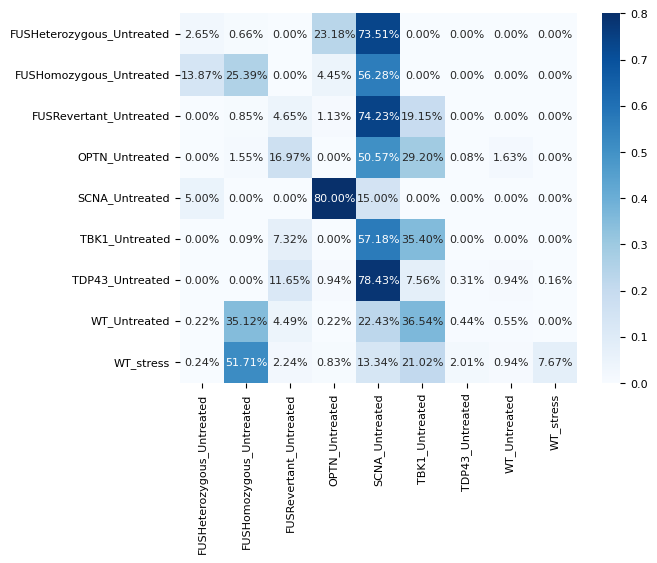


HELDOUT SET - One-vs-rest Confusion Matrix:
[[  4   1   0  35 111   0   0   0   0]
 [ 53  97   0  17 215   0   0   0   0]
 [  0   6  33   8 527 136   0   0   0]
 [  0  19 208   0 620 358   1  20   0]
 [  1   0   0  16   3   0   0   0   0]
 [  0   1  79   0 617 382   0   0   0]
 [  0   0  74   6 498  48   2   6   1]
 [  2 321  41   2 205 334   4   5   0]
 [  2 438  19   7 113 178  17   8  65]]
Sensitivity, hit rate, recall, or true positive rate: [0.02649007 0.2539267  0.04647887 0.         0.15       0.35403151
 0.00314961 0.00547046 0.07674144]
Specificity or true negative rate: [0.99002236 0.85919025 0.91987057 0.98079358 0.51110363 0.78423746
 0.99587165 0.99326733 0.99980457]
Precision or positive predictive value: [0.06451613 0.10985277 0.07268722 0.         0.00103128 0.26601671
 0.08333333 0.12820513 0.98484848]
Negative predictive value: [0.97509319 0.94390868 0.87713249 0.79124808 0.99443535 0.8460689
 0.89343434 0.84658228 0.86741268]
Fall out or false positive rate: [9.9776

In [15]:
from sklearn.neural_network import MLPClassifier

#b5 b9
mlp = MLPClassifier(hidden_layer_sizes=(20,), activation='relu', random_state=1, learning_rate='adaptive', max_iter=300)
fit_eval(mlp, X, y, X5, labels5)

In [15]:
X6_test.shape, X6.shape

((1977, 1000), (7912, 1000))

X_train shape (7644, 1000), X_test shape: (4772, 1000), y_train shape: (7644,), y_test shape: (4772,)


Using label binarize
(1529, 9) (1529, 9)
Using label binarize
(1529, 9) (1529, 9)
Using label binarize
(1529, 9) (1529, 9)
Using label binarize
(1529, 9) (1529, 9)
Using label binarize
(1528, 9) (1528, 9)


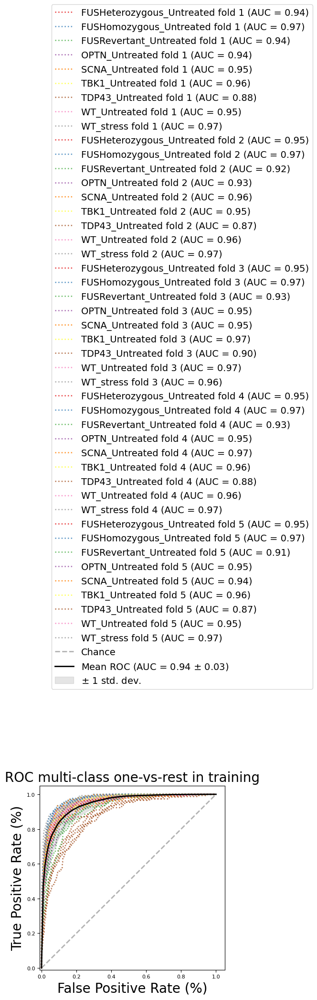



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.93513362 0.96690619 0.93979454 0.93903868 0.95193786 0.96424648
 0.8834832  0.9484495  0.97046388 0.95110245 0.96866664 0.92159941
 0.9282879  0.96143559 0.95492298 0.87400321 0.96481958 0.96557862
 0.95452336 0.97190154 0.93390883 0.94621215 0.95295904 0.96594071
 0.89976096 0.96675326 0.96355044 0.95111883 0.9737507  0.9347094
 0.94890155 0.97365939 0.95924439 0.87578903 0.95682437 0.96876254
 0.95366297 0.96732099 0.9086871  0.94992922 0.93744131 0.95518905
 0.86910369 0.94872315 0.96949837] Mean: 0.9455043703531468
Validating - Validate classifier

------------------
y_pred_prob.shape = (4772, 9)
y_pred shape: (4772,)

Balanced accuracy score: 0.11427787934257078. 
Balanced accuracy score (adjusted): 0.00356261426039213


One-vs-One ROC AUC scores:
0.554355 (macro),
0.564287 (weighted by prevalence)


One-vs-Rest ROC AUC scores:
0.558351 (macro),
0.555551 (weighted by prevalence)


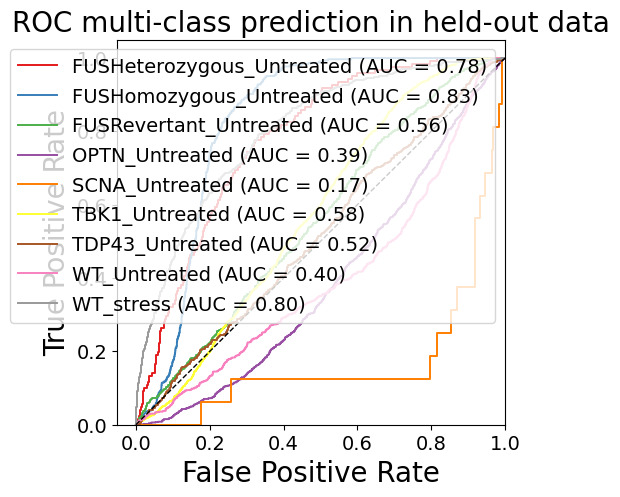

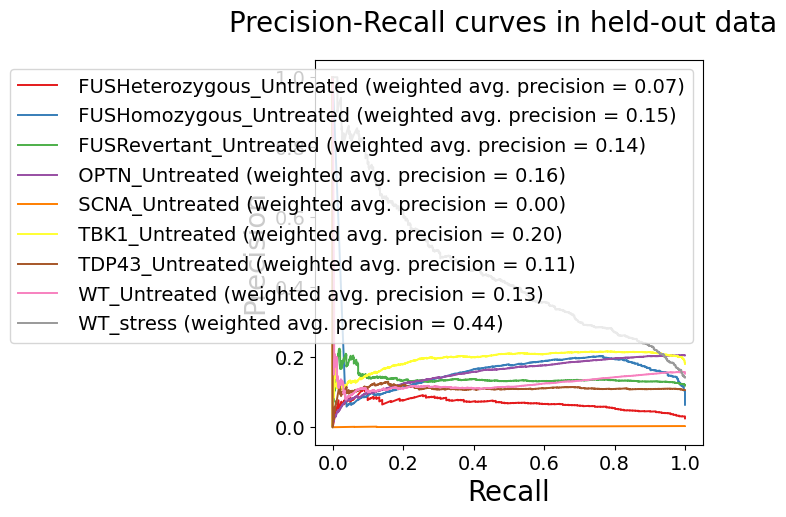

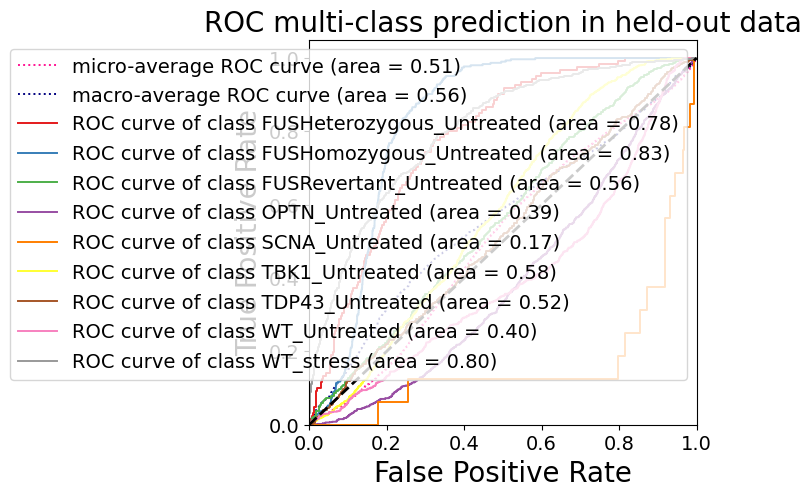


HELDOUT SET - AUC ROC scores of each class: {0: 0.7789900332462051, 1: 0.8268200697206782, 2: 0.5590651425202021, 3: 0.393011131304869, 4: 0.16847140454163165, 5: 0.5755461665995252, 6: 0.5196157908732328, 7: 0.40199395999486787, 8: 0.8016447553294049, 'micro': 0.5079088876270069, 'macro': 0.5584770777144321}
'nHELDOUT SET - Classification Report: 
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.07      0.02      0.03       121
  FUSHomozygous_Untreated       0.19      0.66      0.30       306
   FUSRevertant_Untreated       0.20      0.02      0.04       568
           OPTN_Untreated       0.01      0.00      0.00       981
           SCNA_Untreated       0.00      0.12      0.00        16
           TBK1_Untreated       0.12      0.01      0.02       863
          TDP43_Untreated       0.00      0.00      0.00       508
             WT_Untreated       0.11      0.18      0.14       731
                WT_stress       1.00      0.

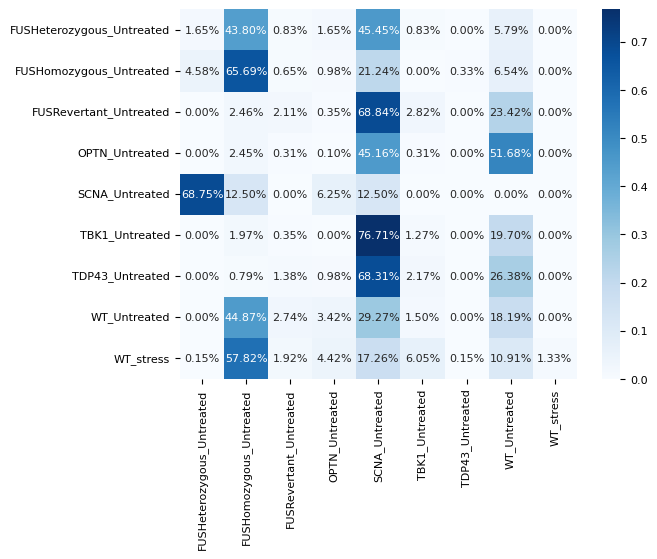


HELDOUT SET - One-vs-rest Confusion Matrix:
[[  2  53   1   2  55   1   0   7   0]
 [ 14 201   2   3  65   0   1  20   0]
 [  0  14  12   2 391  16   0 133   0]
 [  0  24   3   1 443   3   0 507   0]
 [ 11   2   0   1   2   0   0   0   0]
 [  0  17   3   0 662  11   0 170   0]
 [  0   4   7   5 347  11   0 134   0]
 [  0 328  20  25 214  11   0 133   0]
 [  1 392  13  30 117  41   1  74   9]]
Sensitivity, hit rate, recall, or true positive rate: [0.01652893 0.65686275 0.02112676 0.00101937 0.125      0.01274623
 0.         0.18194254 0.01327434]
Specificity or true negative rate: [0.9944098  0.81325571 0.98834443 0.98206278 0.5176619  0.97876695
 0.99953096 0.74140064 1.        ]
Precision or positive predictive value: [7.14285714e-02 1.94202899e-01 1.96721311e-01 1.44927536e-02
 8.71080139e-04 1.17021277e-01 0.00000000e+00 1.12903226e-01
 1.00000000e+00]
Negative predictive value: [0.97491568 0.9719026  0.88197835 0.79162237 0.99434572 0.81787088
 0.89350105 0.83361157 0.85954231]
Fa

/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/model_selection/_split.py:725: UserWarning: The least populated class in y has only 4 members, which is less than n_splits=5.
  warnings.warn(


Using label binarize
(239, 9) (239, 9)
Using label binarize
(239, 9) (239, 9)
Using label binarize
(238, 9) (238, 9)


/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/metrics/_ranking.py:1132: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  warnings.warn(


Using label binarize
(238, 9) (238, 9)
Using label binarize
(238, 9) (238, 9)


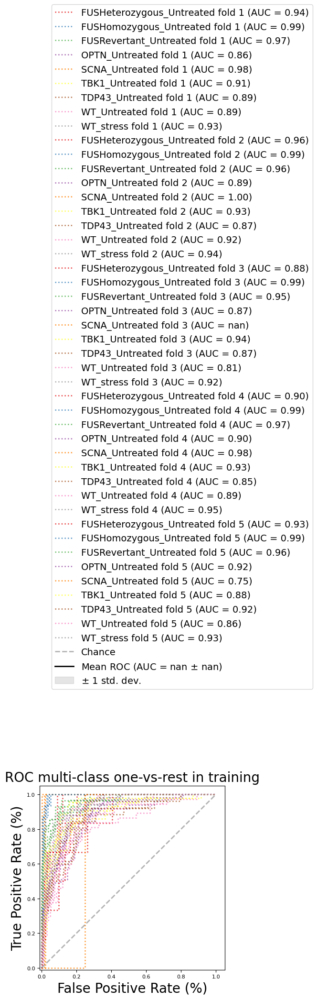



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.9434907  0.98878924 0.9661476  0.8556391  0.9789916  0.90519696
 0.88803738 0.89416644 0.93142037 0.95636624 0.99285714 0.9592775
 0.88839957 0.99579832 0.92857143 0.86542056 0.92052448 0.94189383
 0.8829023  0.99103139 0.95050322 0.86988446        nan 0.94001874
 0.87004695 0.80704585 0.91662971 0.89655172 0.98893871 0.96870748
 0.90114458 0.98312236 0.93261777 0.84724238 0.88572607 0.94997116
 0.93103448 0.99073244 0.96122449 0.91761149 0.75105485 0.87918903
 0.91781567 0.85781078 0.93238178] Mean: nan
Partial fit iteration No. 0/50
Partial fit iteration No. 1/50
Partial fit iteration No. 2/50
Partial fit iteration No. 3/50
Partial fit iteration No. 4/50
Partial fit iteration No. 5/50
Partial fit iteration No. 6/50
Partial fit iteration No. 7/50
Partial fit iteration No. 8/50
Partial fit iteration No. 9/50
Partial fit iteration No. 10/50
Partial fit iteration No. 11/50
Partial fit iteration No. 12/50
Par

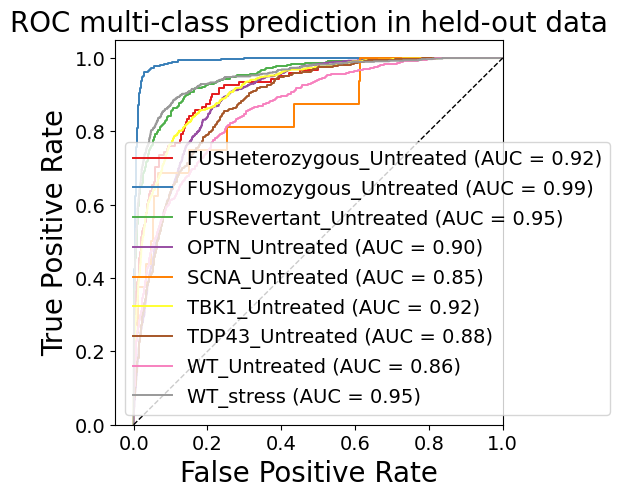

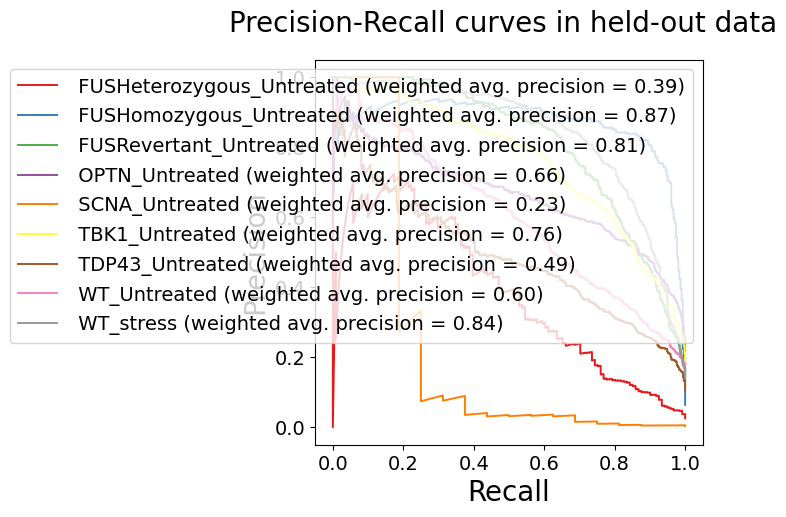

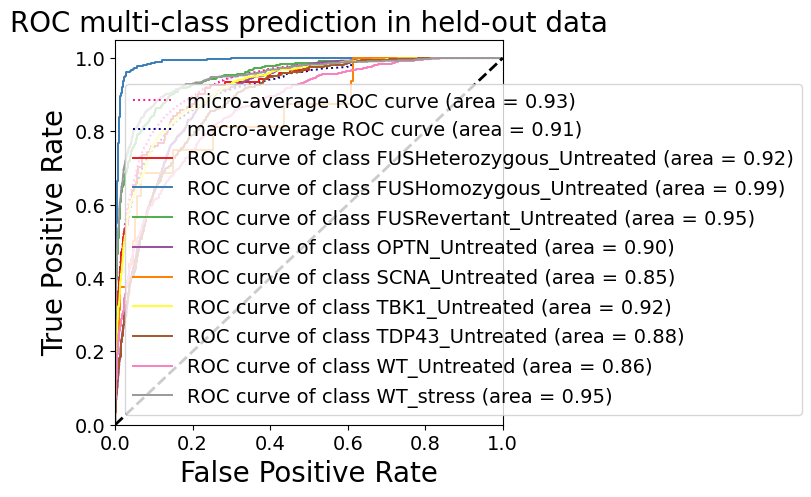


HELDOUT SET - AUC ROC scores of each class: {0: 0.9224515833260776, 1: 0.9911063694025154, 2: 0.9501526882512965, 3: 0.8955051007388871, 4: 0.8537505256518083, 5: 0.9192369452554301, 6: 0.8821164371925367, 7: 0.8639637965301622, 8: 0.9505301664569922, 'micro': 0.9325767574753259, 'macro': 0.9144158840274886}
'nHELDOUT SET - Classification Report: 
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.37      0.50      0.43       121
  FUSHomozygous_Untreated       0.87      0.75      0.80       306
   FUSRevertant_Untreated       0.69      0.74      0.72       568
           OPTN_Untreated       0.60      0.67      0.63       981
           SCNA_Untreated       0.75      0.19      0.30        16
           TBK1_Untreated       0.69      0.66      0.67       863
          TDP43_Untreated       0.48      0.45      0.46       508
             WT_Untreated       0.62      0.48      0.54       731
                WT_stress       0.70      0.8

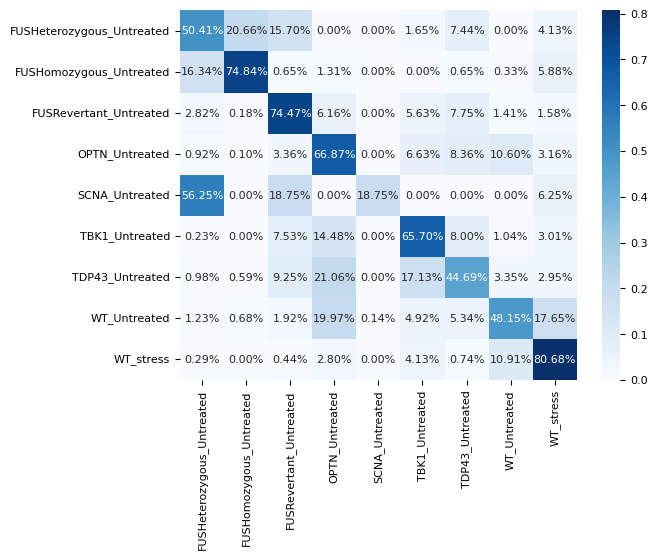


HELDOUT SET - One-vs-rest Confusion Matrix:
[[ 61  25  19   0   0   2   9   0   5]
 [ 50 229   2   4   0   0   2   1  18]
 [ 16   1 423  35   0  32  44   8   9]
 [  9   1  33 656   0  65  82 104  31]
 [  9   0   3   0   3   0   0   0   1]
 [  2   0  65 125   0 567  69   9  26]
 [  5   3  47 107   0  87 227  17  15]
 [  9   5  14 146   1  36  39 352 129]
 [  2   0   3  19   0  28   5  74 547]]
Sensitivity, hit rate, recall, or true positive rate: [0.50413223 0.74836601 0.74471831 0.6687054  0.1875     0.65701043
 0.44685039 0.48153215 0.80678466]
Specificity or true negative rate: [0.97806923 0.99216301 0.95575642 0.88499077 0.99978974 0.93604502
 0.94136961 0.94729027 0.94284319]
Precision or positive predictive value: [0.37423313 0.86742424 0.69458128 0.6007326  0.75       0.69400245
 0.47589099 0.62300885 0.70038412]
Negative predictive value: [0.98698199 0.98291925 0.96516935 0.91168478 0.99727349 0.92515803
 0.93457509 0.90991205 0.96717615]
Fall out or false positive rate: [0.021

MLPClassifier(hidden_layer_sizes=(20,), learning_rate='adaptive', max_iter=300,
              random_state=1)

In [30]:
from sklearn.neural_network import MLPClassifier

# X96 = np.vstack([X9, X6_test])
# y96 = np.vstack([y9, labels6_test])

mlp = MLPClassifier(hidden_layer_sizes=(20,), activation='relu', random_state=1, learning_rate='adaptive', max_iter=300)
mlp = fit_eval(mlp, X9, y9, X5, y5)
print('----------------------')
fit_eval(mlp, X5_test, labels5_test, X5, y5, partial_fit=True, partial_fit_n_iterations=50)

X_train shape (12416, 1000), X_test shape: (1192, 1000), y_train shape: (12416,), y_test shape: (1192,)


Using label binarize
(2484, 9) (2484, 9)
Using label binarize
(2483, 9) (2483, 9)
Using label binarize
(2483, 9) (2483, 9)
Using label binarize
(2483, 9) (2483, 9)
Using label binarize
(2483, 9) (2483, 9)


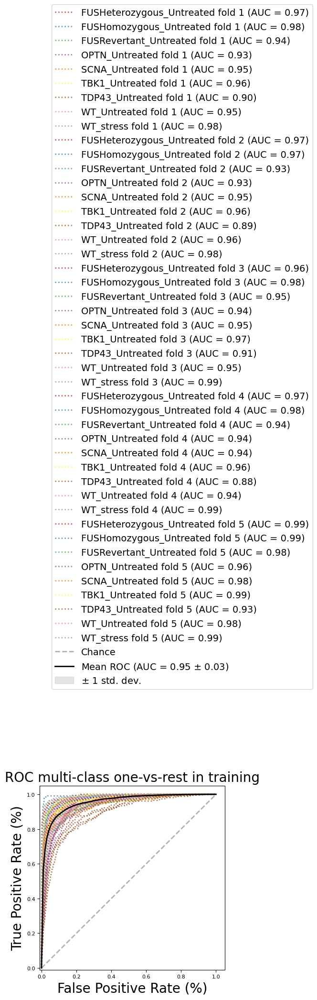



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.97080277 0.98157633 0.94312512 0.92655053 0.94883763 0.95709354
 0.89797809 0.94796686 0.98272378 0.97410071 0.97437985 0.933225
 0.92864204 0.95198867 0.95808744 0.8911445  0.95573328 0.98146495
 0.96499972 0.97564019 0.954056   0.93568976 0.95462282 0.96609394
 0.9057504  0.9473274  0.99032957 0.97148875 0.97500835 0.93559674
 0.93843225 0.93945442 0.96219535 0.88241546 0.94490949 0.98684454
 0.99022836 0.99485671 0.97935545 0.96062283 0.98444749 0.98541721
 0.92884244 0.97767227 0.99231277] Mean: 0.9562229285236117
Validating - Validate classifier

------------------
y_pred_prob.shape = (1192, 9)
y_pred shape: (1192,)

Balanced accuracy score: 0.7956260159949875. 
Balanced accuracy score (adjusted): 0.7700792679943609


One-vs-One ROC AUC scores:
0.974162 (macro),
0.976454 (weighted by prevalence)


One-vs-Rest ROC AUC scores:
0.975026 (macro),
0.972031 (weighted by prevalence)


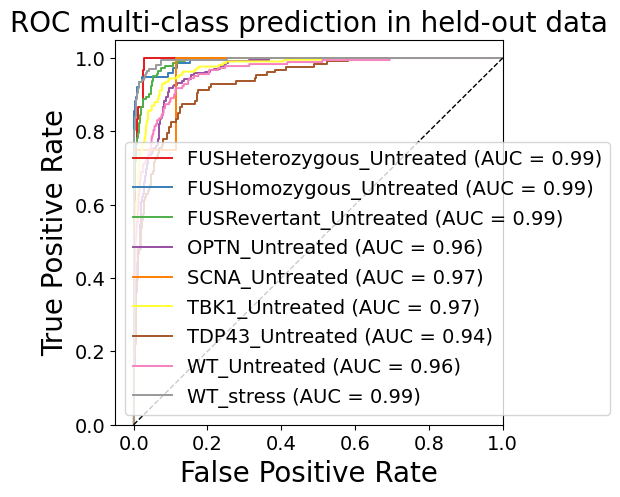

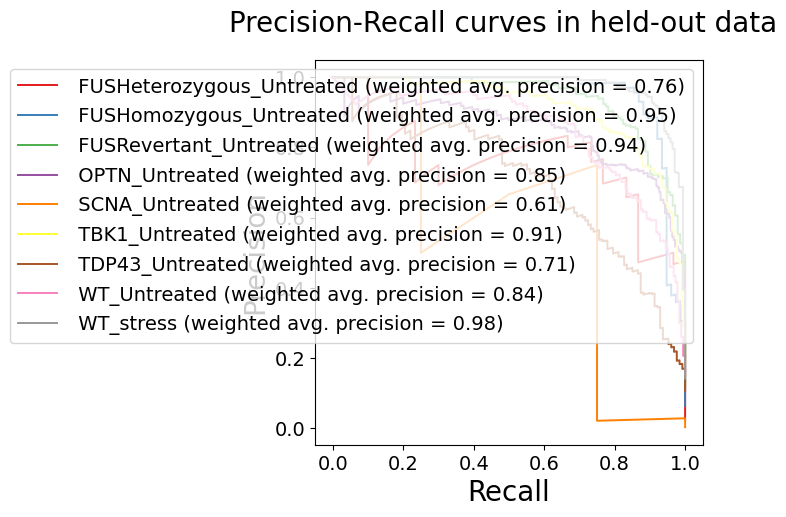

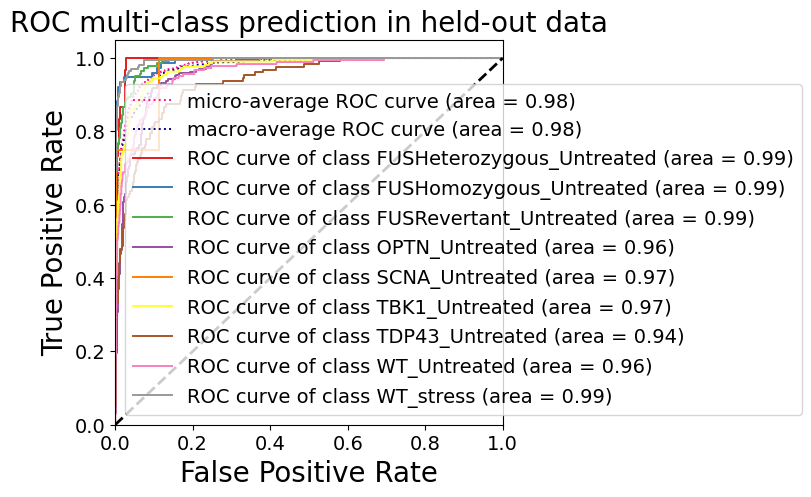


HELDOUT SET - AUC ROC scores of each class: {0: 0.9935742971887551, 1: 0.9927372193925674, 2: 0.9896042924211939, 3: 0.961610240717195, 4: 0.9711700336700336, 5: 0.9749497191863995, 6: 0.9360984806476655, 7: 0.9608414975602095, 8: 0.9946439003510964, 'micro': 0.9807425710694337, 'macro': 0.9753343784786224}
'nHELDOUT SET - Classification Report: 
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.72      0.77      0.74        30
  FUSHomozygous_Untreated       0.91      0.88      0.89        76
   FUSRevertant_Untreated       0.85      0.86      0.86       142
           OPTN_Untreated       0.75      0.80      0.77       245
           SCNA_Untreated       0.38      0.75      0.50         4
           TBK1_Untreated       0.81      0.86      0.83       216
          TDP43_Untreated       0.70      0.61      0.66       127
             WT_Untreated       0.76      0.74      0.75       183
                WT_stress       0.95      0.89

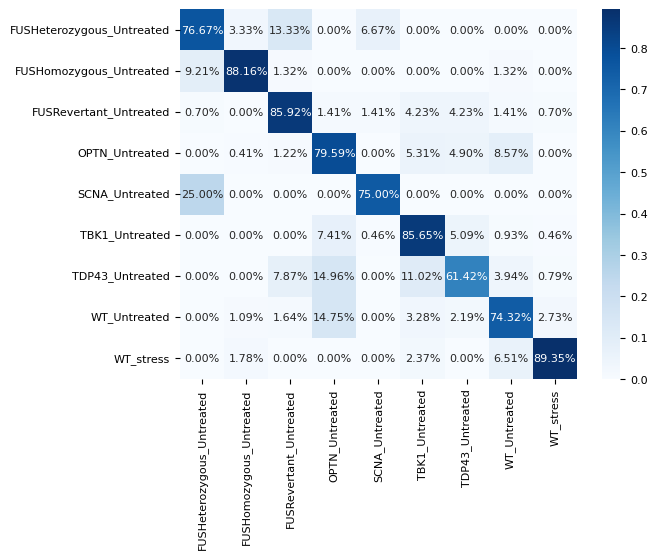


HELDOUT SET - One-vs-rest Confusion Matrix:
[[ 23   1   4   0   2   0   0   0   0]
 [  7  67   1   0   0   0   0   1   0]
 [  1   0 122   2   2   6   6   2   1]
 [  0   1   3 195   0  13  12  21   0]
 [  1   0   0   0   3   0   0   0   0]
 [  0   0   0  16   1 185  11   2   1]
 [  0   0  10  19   0  14  78   5   1]
 [  0   2   3  27   0   6   4 136   5]
 [  0   3   0   0   0   4   0  11 151]]
Sensitivity, hit rate, recall, or true positive rate: [0.76666667 0.88157895 0.85915493 0.79591837 0.75       0.85648148
 0.61417323 0.7431694  0.89349112]
Specificity or true negative rate: [0.99225473 0.9937276  0.98       0.93241816 0.99579125 0.95594262
 0.96901408 0.95837463 0.99217986]
Precision or positive predictive value: [0.71875    0.90540541 0.85314685 0.75289575 0.375      0.81140351
 0.7027027  0.76404494 0.94968553]
Negative predictive value: [0.99396552 0.99194991 0.98093422 0.94640943 0.99915541 0.96784232
 0.9546716  0.95364892 0.98257502]
Fall out or false positive rate: [0.007

In [20]:
from sklearn.neural_network import MLPClassifier

X95 = np.vstack([X9, X5])
y95 = np.vstack([y9, y5])

mlp = MLPClassifier(hidden_layer_sizes=(20,), activation='relu', random_state=1, learning_rate='adaptive', max_iter=300)
fit_eval(mlp, X95, y95, X5_test, labels5_test)

X_train shape (4772, 1000), X_test shape: (1192, 1000), y_train shape: (4772,), y_test shape: (1192,)
Using label binarize
(955, 9) (955, 9)
Using label binarize
(955, 9) (955, 9)
Using label binarize
(954, 9) (954, 9)
Using label binarize
(954, 9) (954, 9)
Using label binarize
(954, 9) (954, 9)


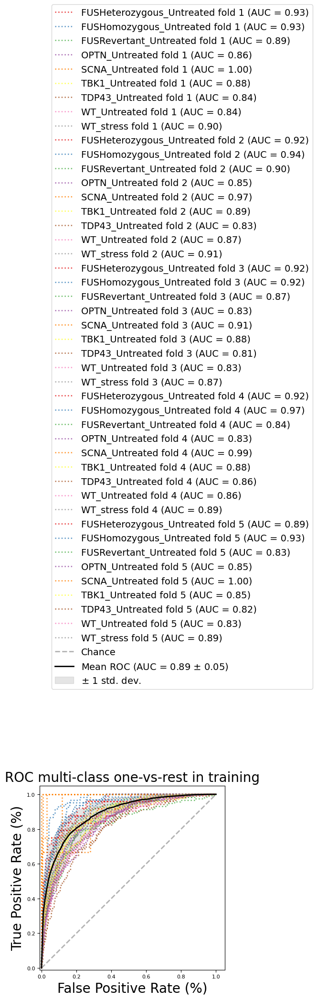



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.92576344 0.93291341 0.88625376 0.8635971  1.         0.87899849
 0.83807439 0.83518889 0.90141762 0.9179198  0.93625149 0.90141467
 0.8513182  0.96950578 0.88603389 0.82897731 0.87032867 0.91089384
 0.9187724  0.92280579 0.86836362 0.83117495 0.90711532 0.88056294
 0.81232164 0.82855096 0.87300683 0.91774194 0.9677822  0.83889933
 0.83165285 0.98808272 0.88256496 0.86326071 0.85675509 0.89017772
 0.89330197 0.93456391 0.82535505 0.85423173 0.99719593 0.84828255
 0.82041252 0.83333192 0.88807889] Mean: 0.8868710486463567
Validating - Validate classifier

------------------
y_pred_prob.shape = (1192, 9)
y_pred shape: (1192,)

Balanced accuracy score: 0.8323700339134193. 
Balanced accuracy score (adjusted): 0.8114162881525969


One-vs-One ROC AUC scores:
0.988549 (macro),
0.985976 (weighted by prevalence)


One-vs-Rest ROC AUC scores:
0.986067 (macro),
0.981722 (weighted by prevalence)


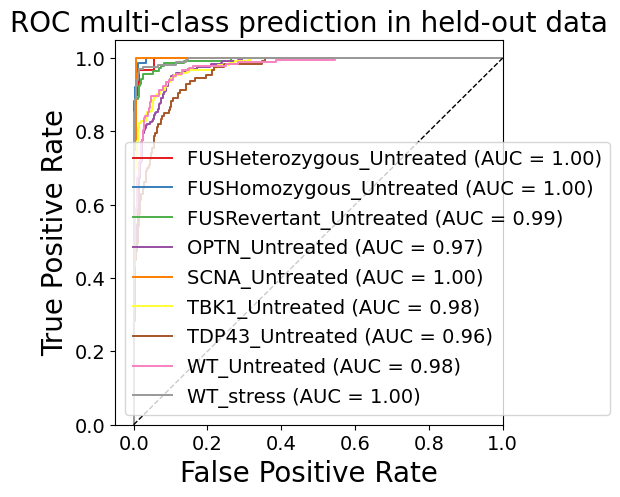

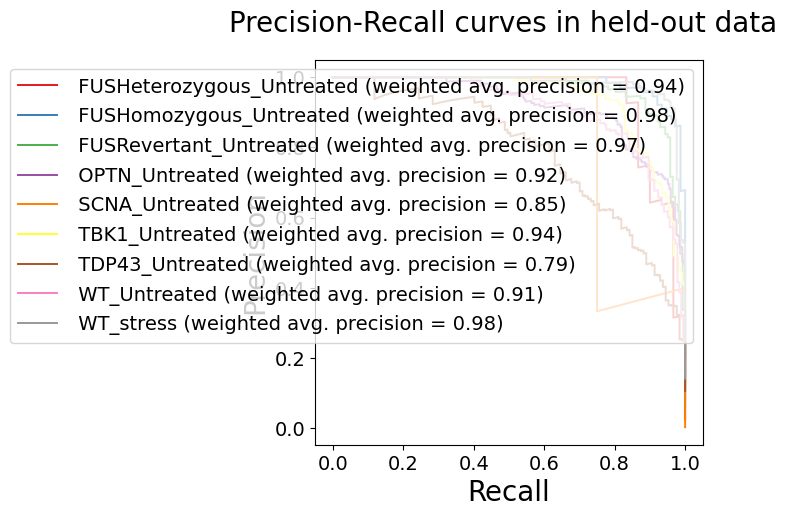

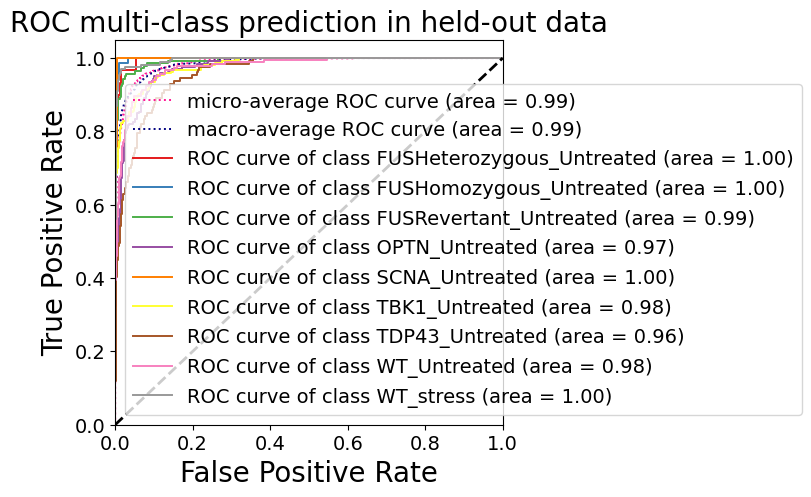


HELDOUT SET - AUC ROC scores of each class: {0: 0.9969879518072289, 1: 0.9987856064893417, 2: 0.9931656606304493, 3: 0.9749886860763313, 4: 0.9987373737373737, 5: 0.9797596007893139, 6: 0.9603267901371484, 7: 0.9761274215123994, 8: 0.9957255317056806, 'micro': 0.9859592033438808, 'macro': 0.9862633757353914}
'nHELDOUT SET - Classification Report: 
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.84      0.87      0.85        30
  FUSHomozygous_Untreated       0.85      0.99      0.91        76
   FUSRevertant_Untreated       0.94      0.86      0.90       142
           OPTN_Untreated       0.77      0.87      0.81       245
           SCNA_Untreated       0.75      0.75      0.75         4
           TBK1_Untreated       0.79      0.86      0.82       216
          TDP43_Untreated       0.73      0.65      0.68       127
             WT_Untreated       0.90      0.71      0.79       183
                WT_stress       0.95      0.9

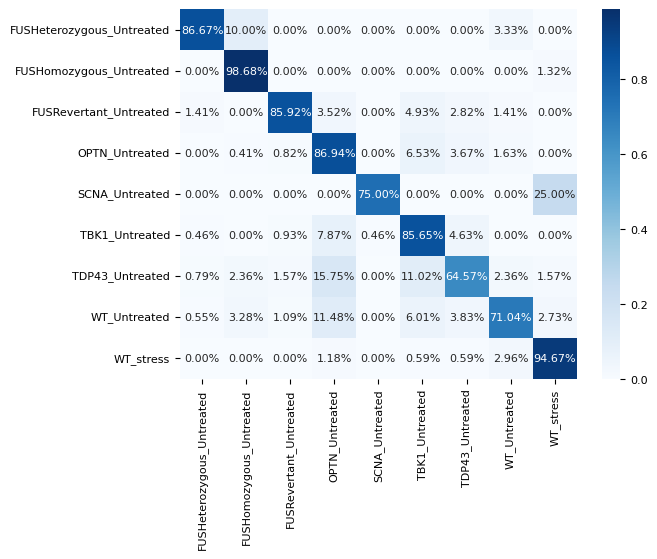


HELDOUT SET - One-vs-rest Confusion Matrix:
[[ 26   3   0   0   0   0   0   1   0]
 [  0  75   0   0   0   0   0   0   1]
 [  2   0 122   5   0   7   4   2   0]
 [  0   1   2 213   0  16   9   4   0]
 [  0   0   0   0   3   0   0   0   1]
 [  1   0   2  17   1 185  10   0   0]
 [  1   3   2  20   0  14  82   3   2]
 [  1   6   2  21   0  11   7 130   5]
 [  0   0   0   2   0   1   1   5 160]]
Sensitivity, hit rate, recall, or true positive rate: [0.86666667 0.98684211 0.85915493 0.86938776 0.75       0.85648148
 0.64566929 0.71038251 0.94674556]
Specificity or true negative rate: [0.99569707 0.98835125 0.99238095 0.9313622  0.99915825 0.94979508
 0.97089202 0.9851338  0.99120235]
Precision or positive predictive value: [0.83870968 0.85227273 0.93846154 0.76618705 0.75       0.79059829
 0.72566372 0.89655172 0.94674556]
Negative predictive value: [0.99655469 0.9990942  0.98116761 0.96498906 0.99915825 0.96764092
 0.95829472 0.94937918 0.99120235]
Fall out or false positive rate: [0.004

In [28]:
from sklearn.neural_network import MLPClassifier

mlp = MLPClassifier(hidden_layer_sizes=(20,), activation='relu', random_state=1, learning_rate='adaptive', max_iter=300)
fit_eval(mlp, X, y, X_test, labels_test)

---

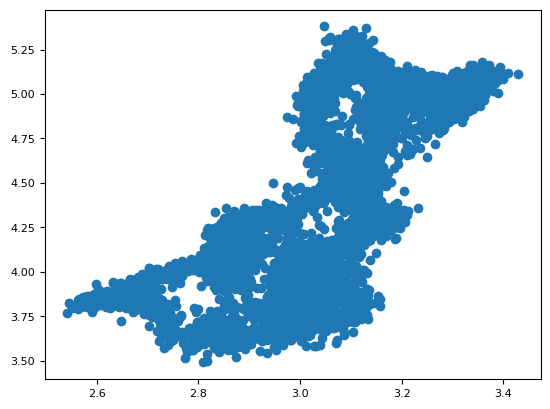

In [36]:
plt.scatter(X[:,0], X[:,1])

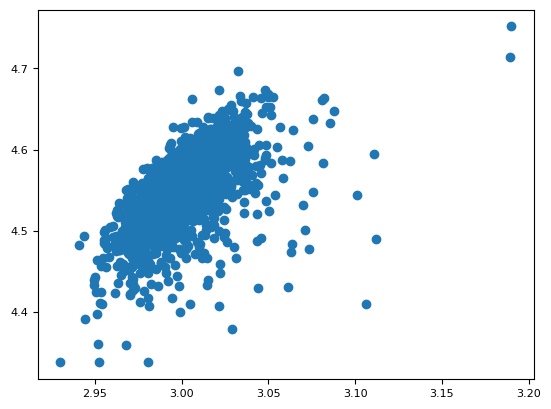

In [37]:
plt.scatter(X_test[:,0], X_test[:,1])

In [44]:
import pandas as pd
print(pd.Series(y.reshape(-1,)).value_counts())
print(pd.Series(labels_test.reshape(-1,)).value_counts())

TBK1_Untreated               1325
FUSHomozygous_Untreated      1285
WT_Untreated                 1032
TDP43_Untreated               780
WT_stress                     718
OPTN_Untreated                679
FUSHeterozygous_Untreated     655
FUSRevertant_Untreated        627
SCNA_Untreated                543
Name: count, dtype: int64
TBK1_Untreated               331
FUSHomozygous_Untreated      321
WT_Untreated                 258
TDP43_Untreated              195
WT_stress                    179
OPTN_Untreated               169
FUSHeterozygous_Untreated    163
FUSRevertant_Untreated       157
SCNA_Untreated               135
Name: count, dtype: int64


In [23]:
from sklearn.svm import SVC


svc = SVC(kernel='rbf', random_state=1, probability=True)

X_train shape (3588, 100), X_test shape: (898, 100), y_train shape: (3588,), y_test shape: (898,)
Using label binarize
(718, 9) (718, 9)
Using label binarize
(718, 9) (718, 9)
Using label binarize
(718, 9) (718, 9)
Using label binarize
(717, 9) (717, 9)
Using label binarize
(717, 9) (717, 9)


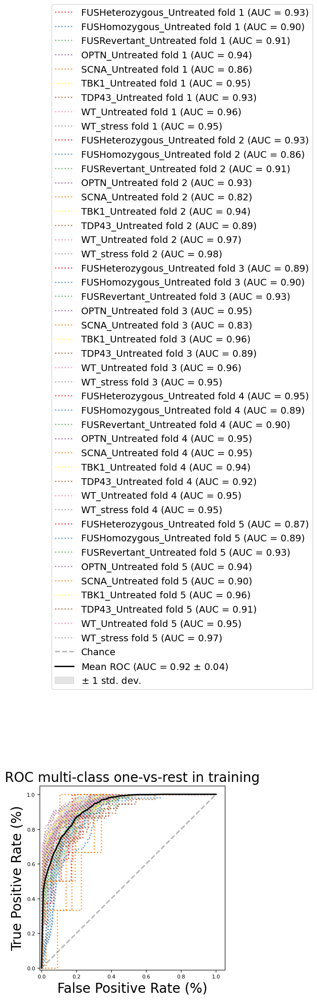



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.92975352 0.90392124 0.91233178 0.94164427 0.85920746 0.94908765
 0.9308251  0.96096195 0.95290118 0.93415493 0.85558902 0.91414337
 0.93373656 0.81585082 0.94415934 0.89058221 0.96884781 0.97551297
 0.88820423 0.89680946 0.93138219 0.95194699 0.82517483 0.95717932
 0.88673255 0.96288146 0.95425619 0.94534556 0.89366516 0.90247698
 0.95201867 0.94545455 0.93840777 0.92249603 0.95466013 0.95226149
 0.8711213  0.8930786  0.92816767 0.94278758 0.9        0.96390687
 0.9059221  0.95172076 0.96581103] Mean: 0.9234906802353079
Validating - Validate classifier

------------------

Balanced accuracy score: 0.4415027150297214. 
Balanced accuracy score (adjusted): 0.37169055440843657


One-vs-One ROC AUC scores:
0.915076 (macro),
0.934105 (weighted by prevalence)


One-vs-Rest ROC AUC scores:
0.935874 (macro),
0.950066 (weighted by prevalence)


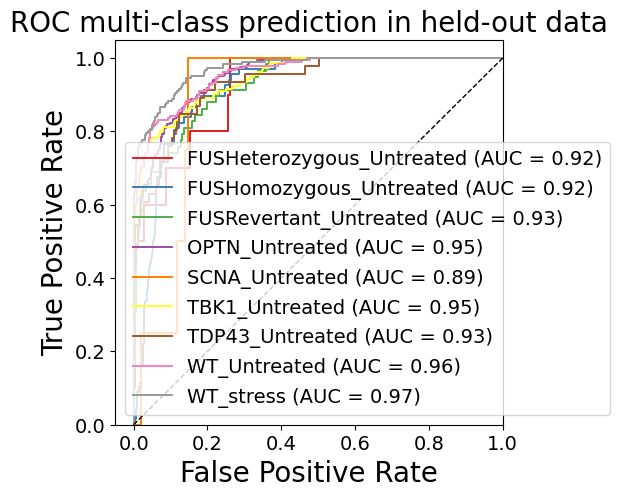

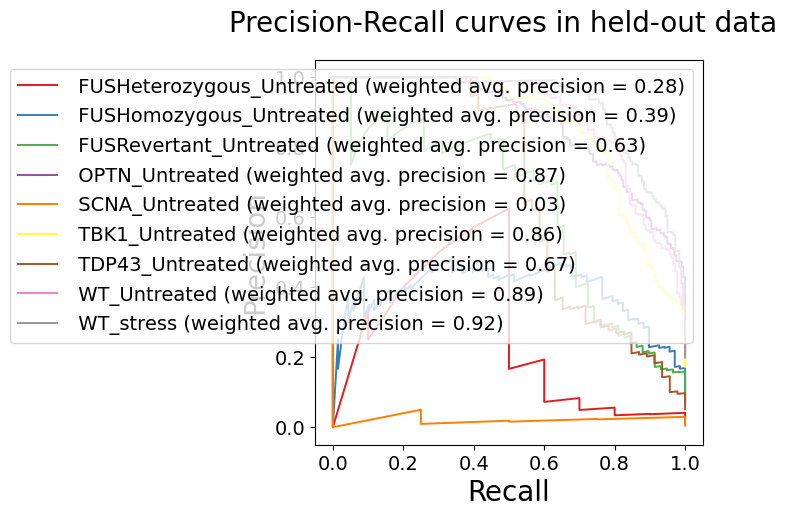

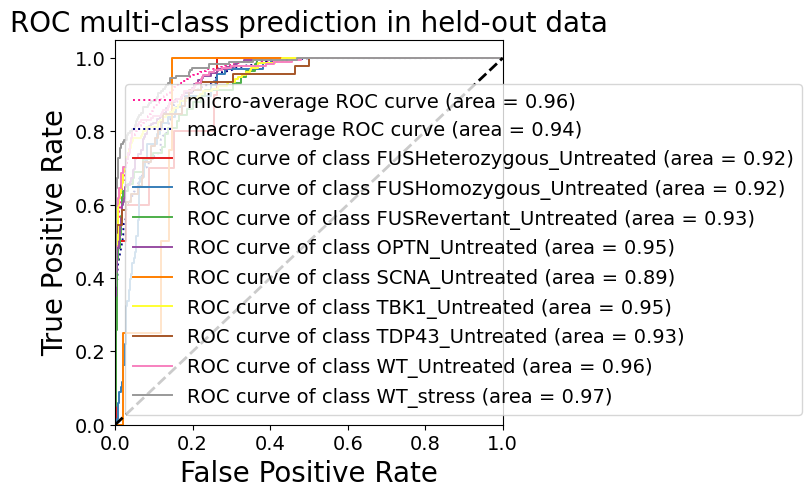


HELDOUT SET - AUC ROC scores of each class: {0: 0.9199324324324324, 1: 0.9194365698086464, 2: 0.9315065681444991, 3: 0.9504820238531715, 4: 0.8940156599552572, 5: 0.9469543698172188, 6: 0.9333792610736885, 7: 0.9565621098626715, 8: 0.9705973382853605, 'micro': 0.9612247707104629, 'macro': 0.9362781024143141}
'nHELDOUT SET - Classification Report: 
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.00      0.00      0.00        10
  FUSHomozygous_Untreated       0.38      0.47      0.42        68
   FUSRevertant_Untreated       1.00      0.03      0.07        58
           OPTN_Untreated       0.58      0.88      0.70       199
           SCNA_Untreated       0.00      0.00      0.00         4
           TBK1_Untreated       0.85      0.71      0.77       155
          TDP43_Untreated       1.00      0.30      0.47        46
             WT_Untreated       0.83      0.75      0.79       178
                WT_stress       0.73      0.8

/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter t

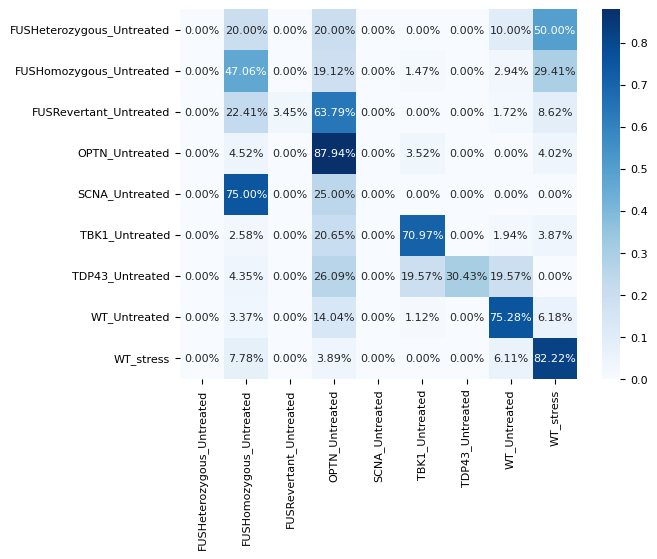


HELDOUT SET - One-vs-rest Confusion Matrix:
[[  0   2   0   2   0   0   0   1   5]
 [  0  32   0  13   0   1   0   2  20]
 [  0  13   2  37   0   0   0   1   5]
 [  0   9   0 175   0   7   0   0   8]
 [  0   3   0   1   0   0   0   0   0]
 [  0   4   0  32   0 110   0   3   6]
 [  0   2   0  12   0   9  14   9   0]
 [  0   6   0  25   0   2   0 134  11]
 [  0  14   0   7   0   0   0  11 148]]
Sensitivity, hit rate, recall, or true positive rate: [0.         0.47058824 0.03448276 0.87939698 0.         0.70967742
 0.30434783 0.75280899 0.82222222]
Specificity or true negative rate: [1.         0.93614458 1.         0.81545064 1.         0.97442799
 1.         0.9625     0.92339833]
Precision or positive predictive value: [       nan 0.37647059 1.         0.57565789        nan 0.85271318
 1.         0.83229814 0.72906404]
Negative predictive value: [0.98886414 0.95571956 0.9375     0.95959596 0.99554566 0.94148244
 0.9638009  0.94029851 0.95395683]
Fall out or false positive rate: [0.   

/tmp/ipykernel_230495/846425149.py:208: RuntimeWarning: invalid value encountered in divide
  PPV = TP / (TP + FP)
/tmp/ipykernel_230495/846425149.py:220: RuntimeWarning: invalid value encountered in divide
  FDR = FP / (TP + FP)


Performance score roc_auc_ovr_weighted on the held-out test-set (25%): 0.6848552338530067


In [24]:
print("b4")
fit_eval(svc, X, y)

In [30]:
from sklearn.neural_network import MLPClassifier

mlp = MLPClassifier(hidden_layer_sizes=(50,), activation='relu', random_state=1)


b4
MLPClassifier(hidden_layer_sizes=(50,), random_state=1)
X_train shape (3588, 100), X_test shape: (898, 100), y_train shape: (3588,), y_test shape: (898,)


/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


Using label binarize
(718, 9) (718, 9)


/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


Using label binarize
(718, 9) (718, 9)


/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:698: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")


Using label binarize
(718, 9) (718, 9)


/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


Using label binarize
(717, 9) (717, 9)


/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


Using label binarize
(717, 9) (717, 9)


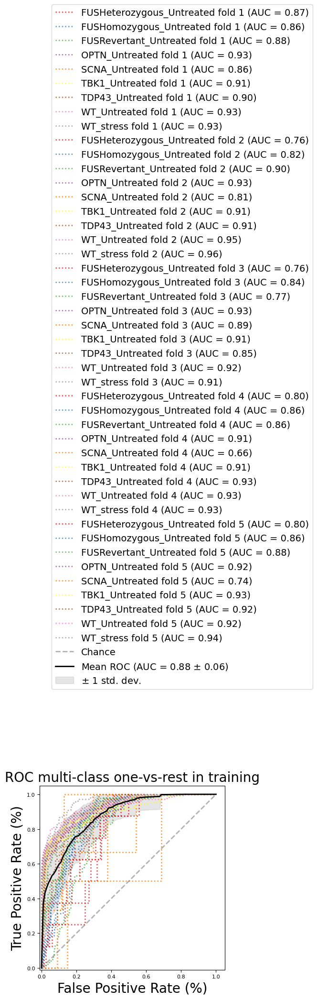



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.8681338  0.86392793 0.88476967 0.9265345  0.86013986 0.91017704
 0.89982934 0.92830595 0.92939412 0.7596831  0.82201026 0.90058877
 0.93132841 0.81165501 0.90588683 0.90848117 0.94514133 0.96169667
 0.7568662  0.83514614 0.77204553 0.92509085 0.88857809 0.90690507
 0.84863277 0.91549296 0.91265002 0.79795487 0.86338752 0.8649095
 0.90845563 0.65524476 0.90771365 0.93096184 0.92816901 0.93385205
 0.79795487 0.86472823 0.88180375 0.9220261  0.73706294 0.92824893
 0.92193959 0.92327006 0.9352579 ] Mean: 0.8773785012248131


/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


Validating - Validate classifier

------------------

Balanced accuracy score: 0.3781470288002283. 
Balanced accuracy score (adjusted): 0.3004154074002569


One-vs-One ROC AUC scores:
0.875658 (macro),
0.909604 (weighted by prevalence)


One-vs-Rest ROC AUC scores:
0.915782 (macro),
0.931087 (weighted by prevalence)


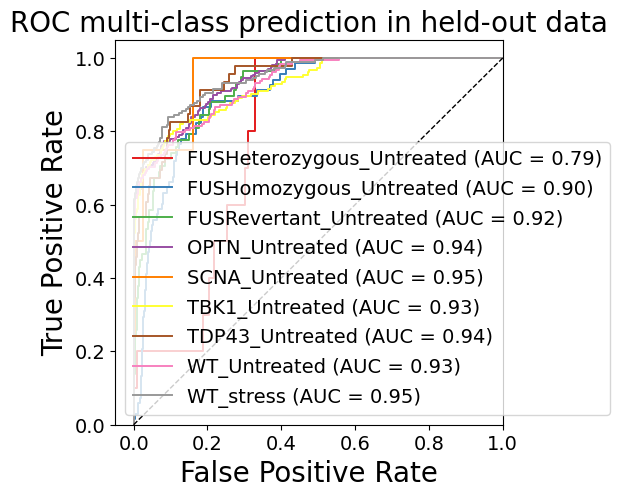

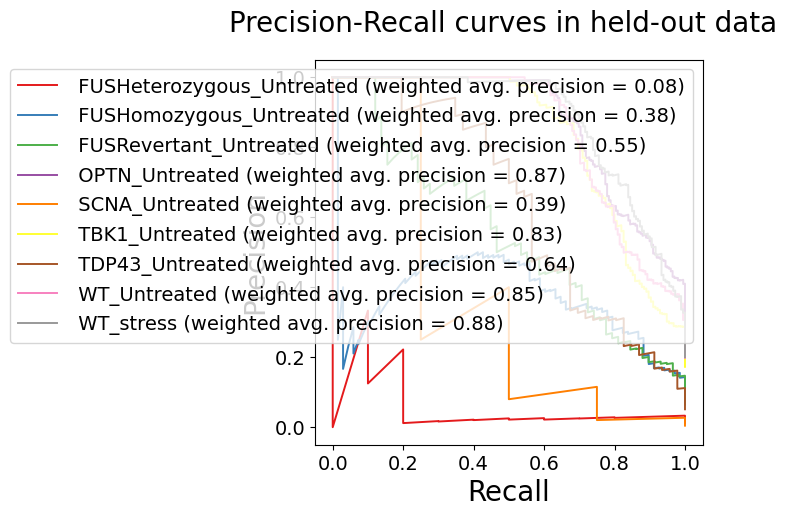

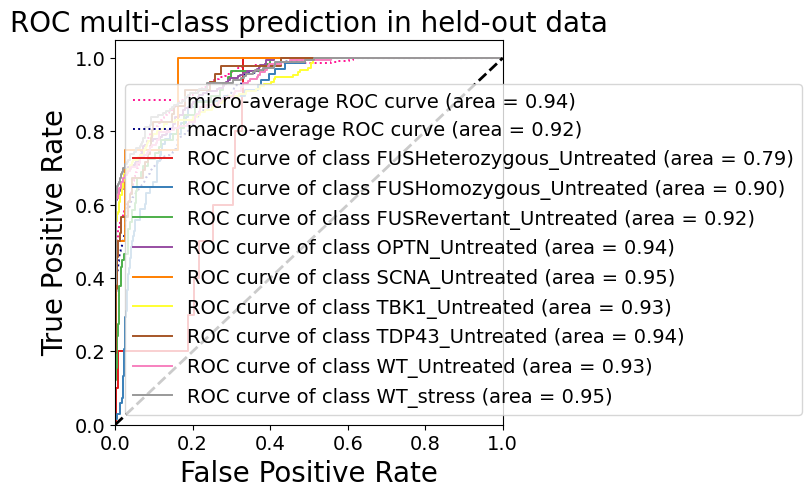


HELDOUT SET - AUC ROC scores of each class: {0: 0.7856981981981982, 1: 0.8986888731396173, 2: 0.922146962233169, 3: 0.9404677177015262, 4: 0.9524608501118568, 5: 0.9252203360395953, 6: 0.9400898142478057, 7: 0.9298064918851435, 8: 0.9474543484989166, 'micro': 0.9409377929672966, 'macro': 0.9161776342833099}
'nHELDOUT SET - Classification Report: 
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.00      0.00      0.00        10
  FUSHomozygous_Untreated       0.35      0.25      0.29        68
   FUSRevertant_Untreated       0.00      0.00      0.00        58
           OPTN_Untreated       0.58      0.86      0.69       199
           SCNA_Untreated       0.00      0.00      0.00         4
           TBK1_Untreated       0.72      0.74      0.73       155
          TDP43_Untreated       0.00      0.00      0.00        46
             WT_Untreated       0.76      0.74      0.75       178
                WT_stress       0.67      0.81

/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter t

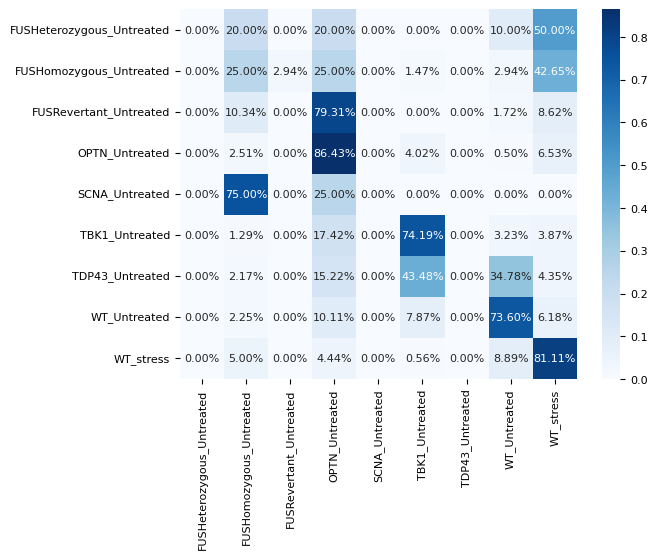


HELDOUT SET - One-vs-rest Confusion Matrix:
[[  0   2   0   2   0   0   0   1   5]
 [  0  17   2  17   0   1   0   2  29]
 [  0   6   0  46   0   0   0   1   5]
 [  0   5   0 172   0   8   0   1  13]
 [  0   3   0   1   0   0   0   0   0]
 [  0   2   0  27   0 115   0   5   6]
 [  0   1   0   7   0  20   0  16   2]
 [  0   4   0  18   0  14   0 131  11]
 [  0   9   0   8   0   1   0  16 146]]
Sensitivity, hit rate, recall, or true positive rate: [0.         0.25       0.         0.86432161 0.         0.74193548
 0.         0.73595506 0.81111111]
Specificity or true negative rate: [1.         0.96144578 0.99761905 0.81974249 1.         0.94078062
 1.         0.94166667 0.90111421]
Precision or positive predictive value: [       nan 0.34693878 0.         0.57718121        nan 0.72327044
        nan 0.75722543 0.67281106]
Negative predictive value: [0.98886414 0.93992933 0.93526786 0.955      0.99554566 0.9458728
 0.94877506 0.93517241 0.95007342]
Fall out or false positive rate: [0.    

/tmp/ipykernel_230495/846425149.py:208: RuntimeWarning: invalid value encountered in divide
  PPV = TP / (TP + FP)
/tmp/ipykernel_230495/846425149.py:220: RuntimeWarning: invalid value encountered in divide
  FDR = FP / (TP + FP)


In [31]:
print("b4")
print(mlp)
fit_eval(mlp, X, y)

b4
RandomForestClassifier(max_depth=3, n_estimators=10, random_state=1)
X_train shape (3588, 100), X_test shape: (898, 100), y_train shape: (3588,), y_test shape: (898,)
Using label binarize
(718, 9) (718, 9)
Using label binarize
(718, 9) (718, 9)
Using label binarize
(718, 9) (718, 9)
Using label binarize
(717, 9) (717, 9)
Using label binarize
(717, 9) (717, 9)


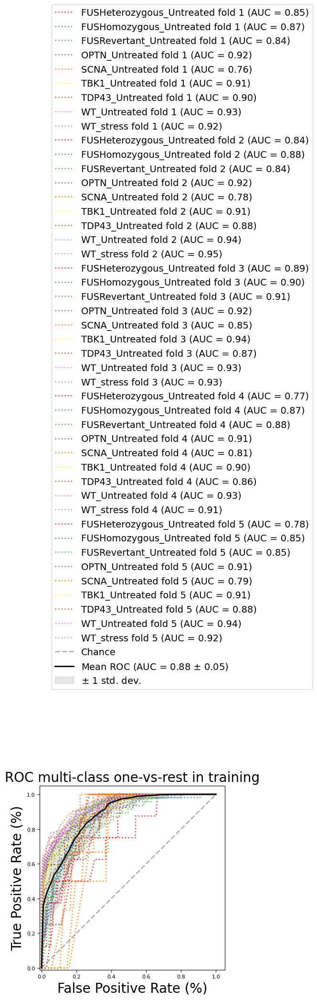



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.84709507 0.8654479  0.8440088  0.92488799 0.75710956 0.90572391
 0.90332182 0.93008485 0.92441565 0.84322183 0.8800898  0.84384705
 0.91751232 0.77762238 0.90786222 0.87841807 0.94385759 0.94670078
 0.8881162  0.90082552 0.91081904 0.91724328 0.84965035 0.94308678
 0.87226654 0.92685715 0.92985385 0.77468265 0.86780068 0.87945379
 0.9125696  0.81083916 0.90074389 0.85558426 0.92819351 0.90775281
 0.77547602 0.8516703  0.85241346 0.90990397 0.79160839 0.90892401
 0.87897456 0.93664421 0.92487153] Mean: 0.8810678474807231
Validating - Validate classifier

------------------

Balanced accuracy score: 0.3561397714824755. 
Balanced accuracy score (adjusted): 0.275657242917785


One-vs-One ROC AUC scores:
0.881382 (macro),
0.903521 (weighted by prevalence)


One-vs-Rest ROC AUC scores:
0.915289 (macro),
0.923390 (weighted by prevalence)


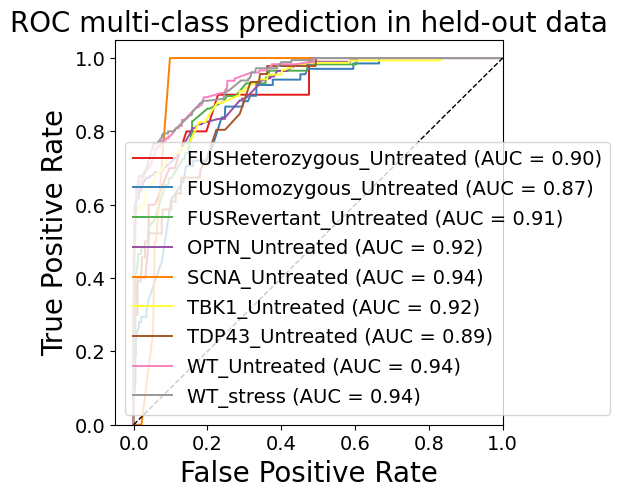

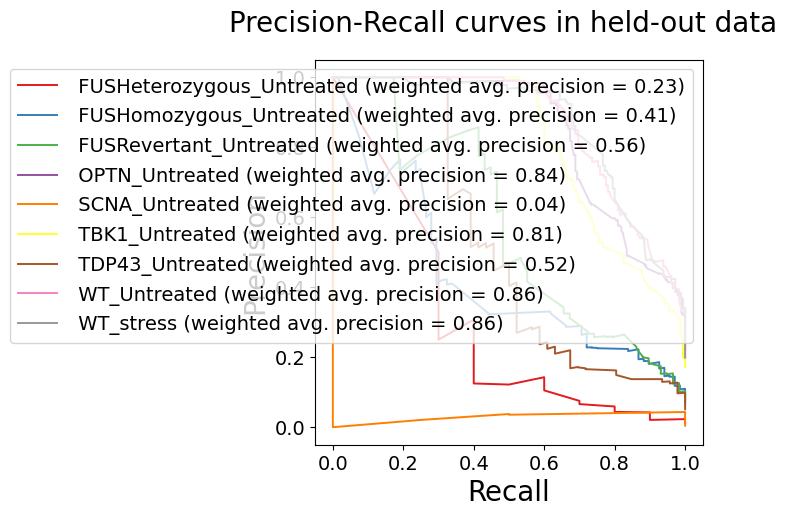

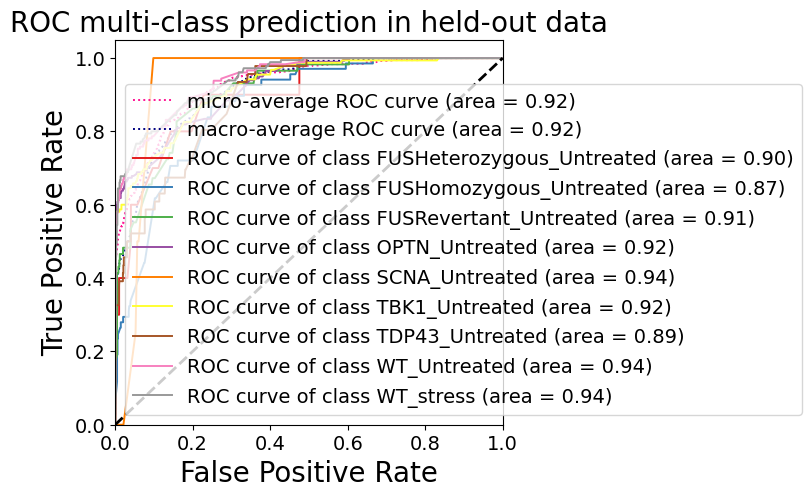


HELDOUT SET - AUC ROC scores of each class: {0: 0.9015765765765765, 1: 0.8720056697377746, 2: 0.9091748768472906, 3: 0.9200508982681649, 4: 0.9373601789709173, 5: 0.9208222984413666, 6: 0.8903857930189836, 7: 0.943188202247191, 8: 0.9430400804704426, 'micro': 0.9247325162077569, 'macro': 0.9153434228448518}
'nHELDOUT SET - Classification Report: 
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.00      0.00      0.00        10
  FUSHomozygous_Untreated       0.64      0.10      0.18        68
   FUSRevertant_Untreated       0.00      0.00      0.00        58
           OPTN_Untreated       0.50      0.87      0.64       199
           SCNA_Untreated       0.00      0.00      0.00         4
           TBK1_Untreated       0.71      0.70      0.71       155
          TDP43_Untreated       0.00      0.00      0.00        46
             WT_Untreated       0.79      0.72      0.76       178
                WT_stress       0.65      0.80

/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter t

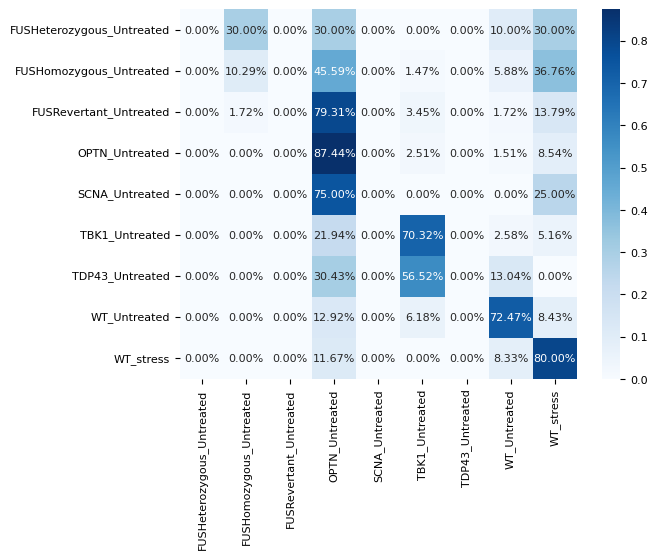


HELDOUT SET - One-vs-rest Confusion Matrix:
[[  0   3   0   3   0   0   0   1   3]
 [  0   7   0  31   0   1   0   4  25]
 [  0   1   0  46   0   2   0   1   8]
 [  0   0   0 174   0   5   0   3  17]
 [  0   0   0   3   0   0   0   0   1]
 [  0   0   0  34   0 109   0   4   8]
 [  0   0   0  14   0  26   0   6   0]
 [  0   0   0  23   0  11   0 129  15]
 [  0   0   0  21   0   0   0  15 144]]
Sensitivity, hit rate, recall, or true positive rate: [0.         0.10294118 0.         0.87437186 0.         0.70322581
 0.         0.7247191  0.8       ]
Specificity or true negative rate: [1.         0.99518072 1.         0.74964235 1.         0.93943472
 1.         0.95277778 0.89275766]
Precision or positive predictive value: [       nan 0.63636364        nan 0.49856734        nan 0.70779221
        nan 0.79141104 0.65158371]
Negative predictive value: [0.98886414 0.93122886 0.93541203 0.95446266 0.99554566 0.93817204
 0.94877506 0.93333333 0.94682422]
Fall out or false positive rate: [0.   

/tmp/ipykernel_230495/846425149.py:208: RuntimeWarning: invalid value encountered in divide
  PPV = TP / (TP + FP)
/tmp/ipykernel_230495/846425149.py:220: RuntimeWarning: invalid value encountered in divide
  FDR = FP / (TP + FP)


In [33]:
rfc = RandomForestClassifier(n_estimators=10, max_depth=3, random_state=1)

print("b4")
print(rfc)
fit_eval(rfc, X, y)

b4
KNeighborsClassifier()
X_train shape (3588, 100), X_test shape: (898, 100), y_train shape: (3588,), y_test shape: (898,)
Using label binarize
(718, 9) (718, 9)
Using label binarize
(718, 9) (718, 9)
Using label binarize
(718, 9) (718, 9)
Using label binarize
(717, 9) (717, 9)
Using label binarize
(717, 9) (717, 9)


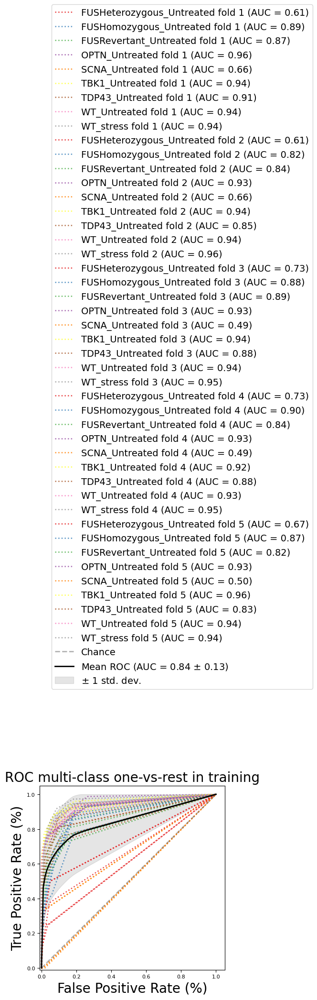



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.60933099 0.89492693 0.8657641  0.96048947 0.65897436 0.9388916
 0.9099496  0.93720657 0.94311363 0.6084507  0.82104808 0.83914014
 0.92682572 0.66037296 0.94016781 0.85168869 0.94073993 0.96319081
 0.72922535 0.88158188 0.89347433 0.92885994 0.49440559 0.93901379
 0.88129539 0.94377201 0.94617451 0.73025388 0.89778504 0.8426167
 0.93412006 0.49020979 0.91736931 0.88298887 0.92666871 0.94889228
 0.6666079  0.86801017 0.82027628 0.92790965 0.4958042  0.95877305
 0.83398251 0.93605021 0.94440203] Mean: 0.8429065673244536
Validating - Validate classifier

------------------

Balanced accuracy score: 0.6214479960812354. 
Balanced accuracy score (adjusted): 0.5741289955913897


One-vs-One ROC AUC scores:
0.888635 (macro),
0.910240 (weighted by prevalence)


One-vs-Rest ROC AUC scores:
0.900481 (macro),
0.931285 (weighted by prevalence)


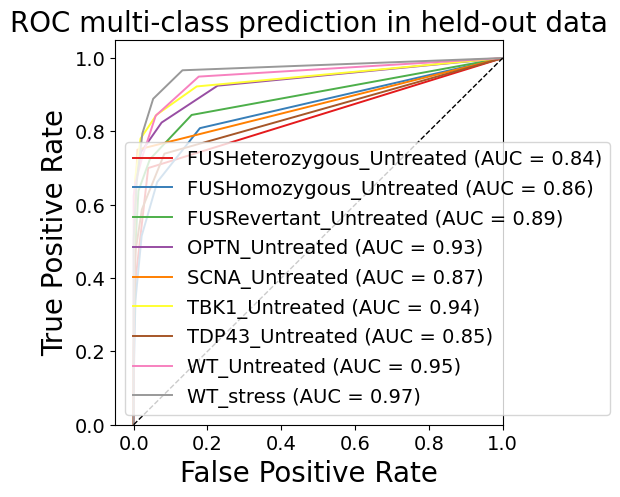

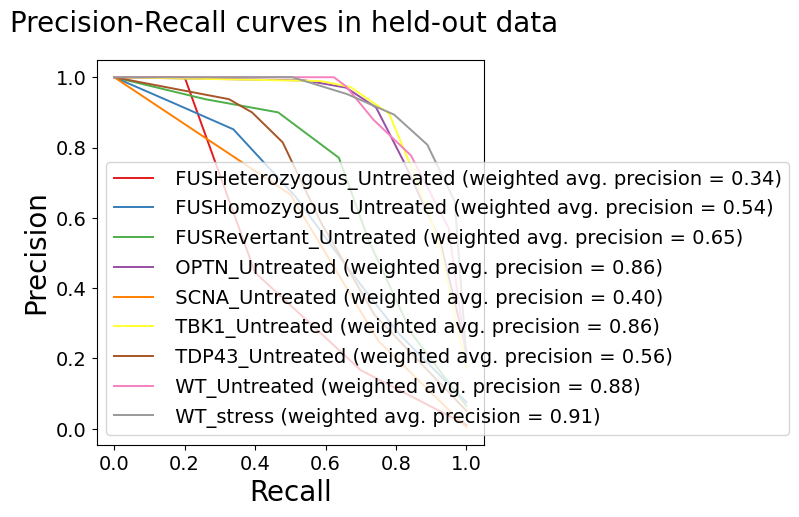

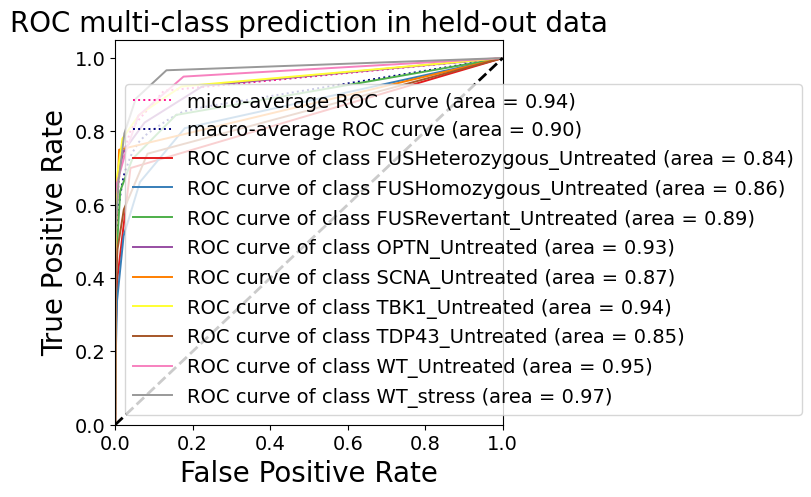


HELDOUT SET - AUC ROC scores of each class: {0: 0.836768018018018, 1: 0.8601346562721475, 2: 0.8935344827586207, 3: 0.932743114715207, 4: 0.8720637583892616, 5: 0.9411800460209265, 6: 0.8484639722392324, 7: 0.9519194756554307, 8: 0.9675216651191583, 'micro': 0.9372558605860091, 'macro': 0.9004810210208891}
'nHELDOUT SET - Classification Report: 
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.43      0.30      0.35        10
  FUSHomozygous_Untreated       0.44      0.68      0.53        68
   FUSRevertant_Untreated       0.60      0.67      0.63        58
           OPTN_Untreated       0.81      0.78      0.79       199
           SCNA_Untreated       1.00      0.25      0.40         4
           TBK1_Untreated       0.80      0.81      0.80       155
          TDP43_Untreated       0.70      0.50      0.58        46
             WT_Untreated       0.83      0.79      0.81       178
                WT_stress       0.86      0.82 

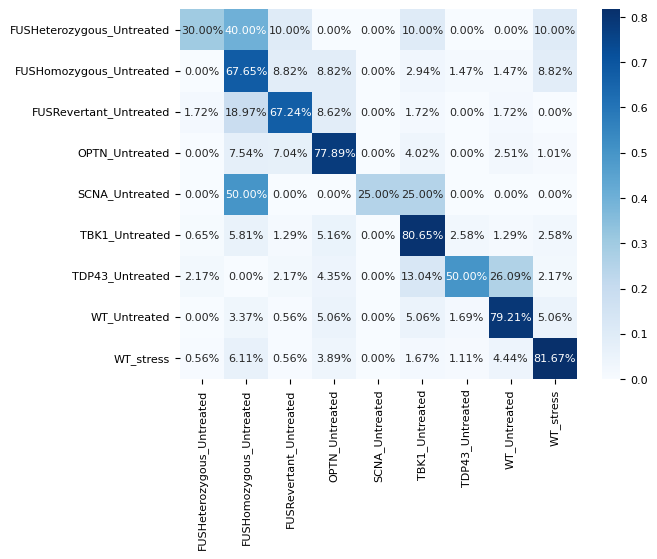


HELDOUT SET - One-vs-rest Confusion Matrix:
[[  3   4   1   0   0   1   0   0   1]
 [  0  46   6   6   0   2   1   1   6]
 [  1  11  39   5   0   1   0   1   0]
 [  0  15  14 155   0   8   0   5   2]
 [  0   2   0   0   1   1   0   0   0]
 [  1   9   2   8   0 125   4   2   4]
 [  1   0   1   2   0   6  23  12   1]
 [  0   6   1   9   0   9   3 141   9]
 [  1  11   1   7   0   3   2   8 147]]
Sensitivity, hit rate, recall, or true positive rate: [0.3        0.67647059 0.67241379 0.77889447 0.25       0.80645161
 0.5        0.79213483 0.81666667]
Specificity or true negative rate: [0.9954955  0.93012048 0.96904762 0.94706724 1.         0.95827725
 0.98826291 0.95972222 0.96796657]
Precision or positive predictive value: [0.42857143 0.44230769 0.6        0.80729167 1.         0.80128205
 0.6969697  0.82941176 0.86470588]
Negative predictive value: [0.99214366 0.97229219 0.97719088 0.93767705 0.99665552 0.95956873
 0.9734104  0.94917582 0.95467033]
Fall out or false positive rate: [0.004

In [32]:
from sklearn.neighbors import KNeighborsClassifier

knc = KNeighborsClassifier()
print("b4")
print(knc)
fit_eval(knc, X, y)

b4
X_train shape (3588, 100), X_test shape: (898, 100), y_train shape: (3588,), y_test shape: (898,)


/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


Using label binarize
(718, 9) (718, 9)


/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


Using label binarize
(718, 9) (718, 9)


/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


Using label binarize
(718, 9) (718, 9)


/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


Using label binarize
(717, 9) (717, 9)


/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


Using label binarize
(717, 9) (717, 9)


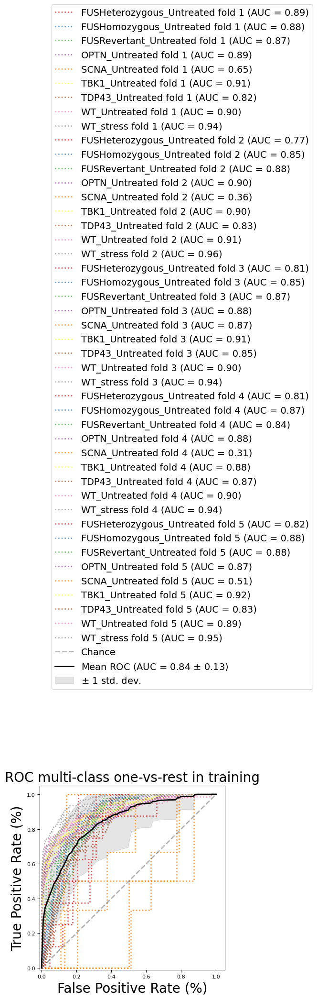



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.89066901 0.87904395 0.87014752 0.89081541 0.65221445 0.90501792
 0.81561297 0.89944004 0.94083914 0.7681338  0.847529   0.88282867
 0.90395385 0.35804196 0.89676333 0.82696353 0.9108348  0.96386227
 0.80897887 0.85003905 0.8672036  0.88009811 0.87365967 0.91463017
 0.85244275 0.9043305  0.94152875 0.81258815 0.87106866 0.83604319
 0.88434661 0.31188811 0.87988903 0.86613672 0.90169014 0.93614262
 0.8221086  0.87785599 0.88243887 0.87239918 0.51118881 0.91906925
 0.82547695 0.88650337 0.9468441 ] Mean: 0.840873365799482


/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


Validating - Validate classifier

------------------

Balanced accuracy score: 0.34968500083191867. 
Balanced accuracy score (adjusted): 0.26839562593590854


One-vs-One ROC AUC scores:
0.831594 (macro),
0.880452 (weighted by prevalence)


One-vs-Rest ROC AUC scores:
0.874716 (macro),
0.916727 (weighted by prevalence)


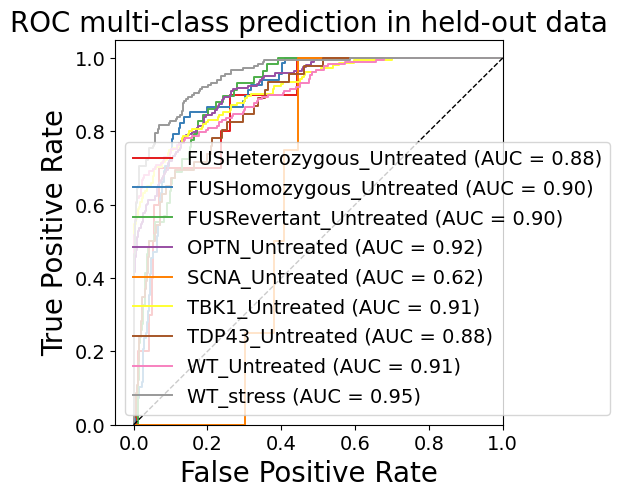

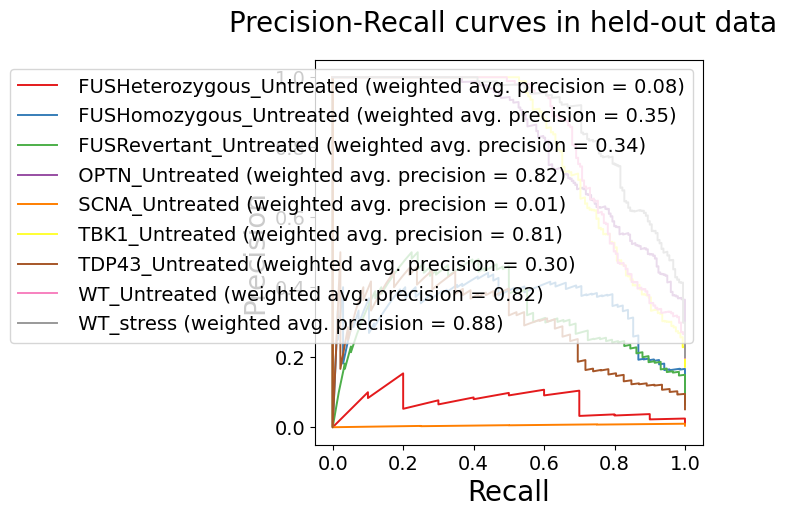

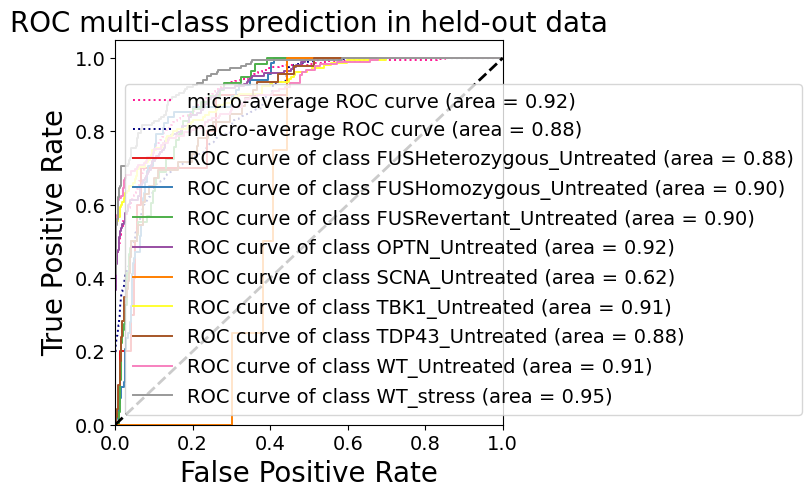


HELDOUT SET - AUC ROC scores of each class: {0: 0.8773648648648649, 1: 0.9019666902905741, 2: 0.902196223316913, 3: 0.9190588133802057, 4: 0.6166107382550335, 5: 0.9130291321147918, 6: 0.8796693202694428, 7: 0.907748127340824, 8: 0.9547972763850201, 'micro': 0.9239639808334285, 'macro': 0.8752499204849105}
'nHELDOUT SET - Classification Report: 
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.00      0.00      0.00        10
  FUSHomozygous_Untreated       0.22      0.07      0.11        68
   FUSRevertant_Untreated       0.00      0.00      0.00        58
           OPTN_Untreated       0.49      0.93      0.64       199
           SCNA_Untreated       0.00      0.00      0.00         4
           TBK1_Untreated       0.68      0.70      0.69       155
          TDP43_Untreated       0.00      0.00      0.00        46
             WT_Untreated       0.82      0.67      0.74       178
                WT_stress       0.77      0.77 

/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter t

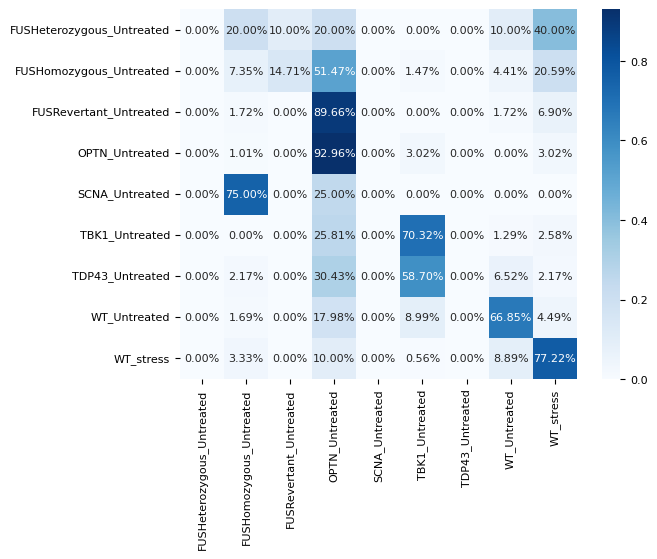


HELDOUT SET - One-vs-rest Confusion Matrix:
[[  0   2   1   2   0   0   0   1   4]
 [  0   5  10  35   0   1   0   3  14]
 [  0   1   0  52   0   0   0   1   4]
 [  0   2   0 185   0   6   0   0   6]
 [  0   3   0   1   0   0   0   0   0]
 [  0   0   0  40   0 109   0   2   4]
 [  0   1   0  14   0  27   0   3   1]
 [  0   3   0  32   0  16   0 119   8]
 [  0   6   0  18   0   1   0  16 139]]
Sensitivity, hit rate, recall, or true positive rate: [0.         0.07352941 0.         0.92964824 0.         0.70322581
 0.         0.66853933 0.77222222]
Specificity or true negative rate: [1.         0.97831325 0.98690476 0.72246066 1.         0.93135935
 1.         0.96388889 0.94289694]
Precision or positive predictive value: [       nan 0.2173913  0.         0.48812665        nan 0.68125
        nan 0.82068966 0.77222222]
Negative predictive value: [0.98886414 0.928      0.93461105 0.97302505 0.99554566 0.93766938
 0.94877506 0.92164675 0.94289694]
Fall out or false positive rate: [0.      

/tmp/ipykernel_230495/846425149.py:208: RuntimeWarning: invalid value encountered in divide
  PPV = TP / (TP + FP)
/tmp/ipykernel_230495/846425149.py:220: RuntimeWarning: invalid value encountered in divide
  FDR = FP / (TP + FP)


In [26]:
print("b4")
fit_eval(mlp, X, y)

X_train shape (7642, 2), X_test shape: (1911, 2), y_train shape: (7642,), y_test shape: (1911,)
Using label binarize
(1529, 9) (1529, 9)
Using label binarize
(1529, 9) (1529, 9)
Using label binarize
(1528, 9) (1528, 9)
Using label binarize
(1528, 9) (1528, 9)
Using label binarize
(1528, 9) (1528, 9)


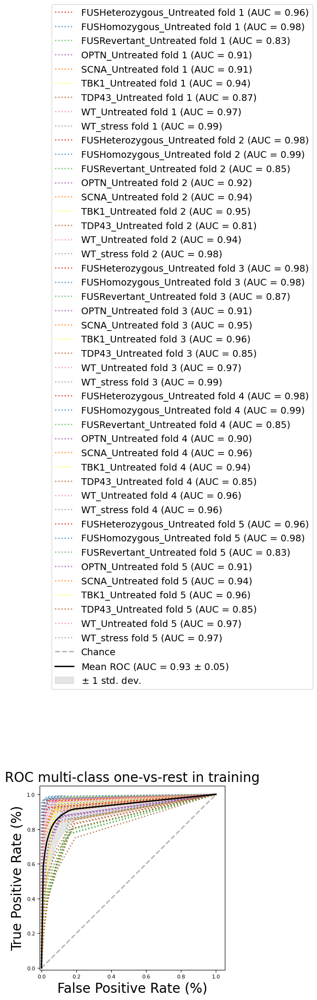



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.95730542 0.98252698 0.83180317 0.90606129 0.90611072 0.94053171
 0.87315349 0.97137261 0.98851401 0.97712654 0.99027849 0.84683897
 0.91961646 0.9388928  0.94920289 0.80865875 0.93700622 0.98437926
 0.97915979 0.98294336 0.87172915 0.90797467 0.94843894 0.9552264
 0.84769567 0.97077281 0.98537853 0.98074937 0.9882197  0.84585317
 0.89806971 0.9562523  0.93597604 0.85058309 0.96411366 0.95634885
 0.95555088 0.98000441 0.83105631 0.90688894 0.94422678 0.95696828
 0.85221135 0.97316511 0.96756081] Mean: 0.9311666192327652
Validating - Validate classifier

------------------

Balanced accuracy score: 0.758548842349188. 
Balanced accuracy score (adjusted): 0.7283674476428365


One-vs-One ROC AUC scores:
0.927851 (macro),
0.931703 (weighted by prevalence)


One-vs-Rest ROC AUC scores:
0.929070 (macro),
0.937049 (weighted by prevalence)


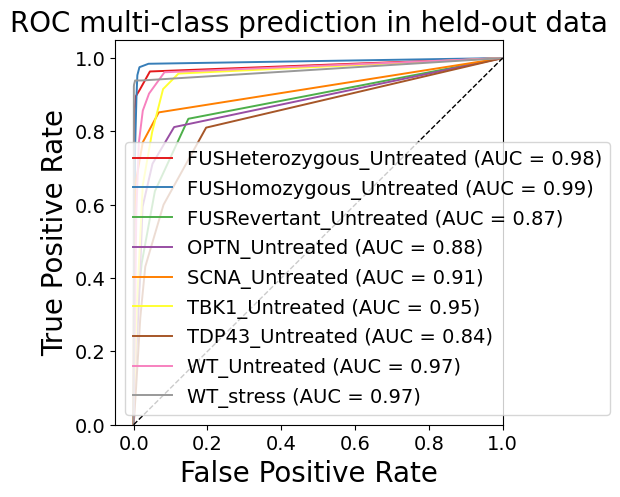

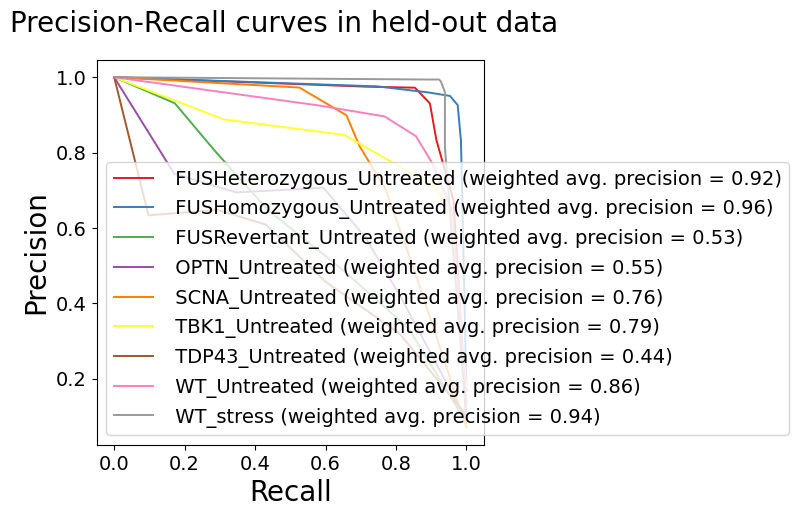

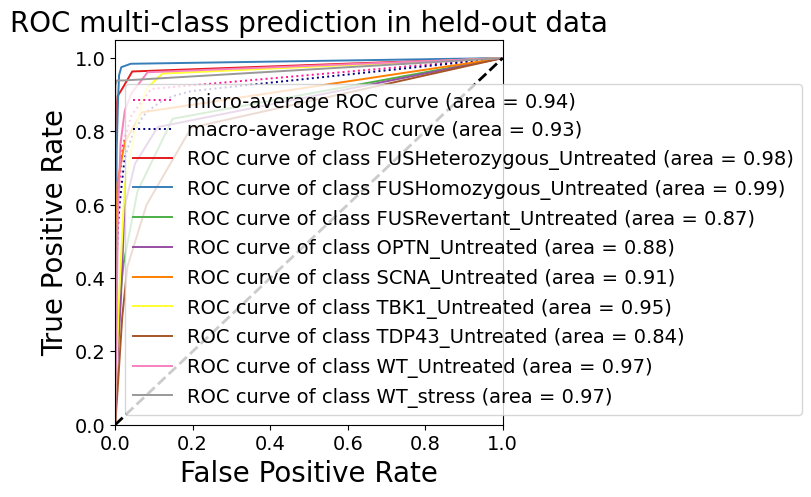


HELDOUT SET - AUC ROC scores of each class: {0: 0.9781157943233697, 1: 0.9885851995532828, 2: 0.8741221157826696, 3: 0.8759502652295841, 4: 0.9146688355021688, 5: 0.9520689127691309, 6: 0.8416920686151455, 7: 0.9679816354572611, 8: 0.9684479106489504, 'micro': 0.9427889801011577, 'macro': 0.9290711957225671}
'nHELDOUT SET - Classification Report: 
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.92      0.90      0.91       164
  FUSHomozygous_Untreated       0.94      0.95      0.94       321
   FUSRevertant_Untreated       0.55      0.50      0.52       157
           OPTN_Untreated       0.62      0.66      0.64       170
           SCNA_Untreated       0.73      0.73      0.73       135
           TBK1_Untreated       0.74      0.82      0.78       331
          TDP43_Untreated       0.57      0.47      0.52       195
             WT_Untreated       0.83      0.86      0.85       258
                WT_stress       0.98      0.9

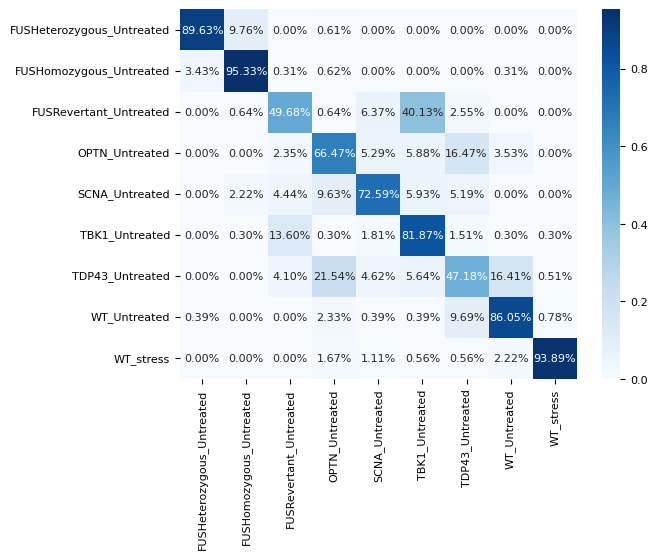


HELDOUT SET - One-vs-rest Confusion Matrix:
[[147  16   0   1   0   0   0   0   0]
 [ 11 306   1   2   0   0   0   1   0]
 [  0   1  78   1  10  63   4   0   0]
 [  0   0   4 113   9  10  28   6   0]
 [  0   3   6  13  98   8   7   0   0]
 [  0   1  45   1   6 271   5   1   1]
 [  0   0   8  42   9  11  92  32   1]
 [  1   0   0   6   1   1  25 222   2]
 [  0   0   0   3   2   1   1   4 169]]
Sensitivity, hit rate, recall, or true positive rate: [0.89634146 0.95327103 0.49681529 0.66470588 0.72592593 0.81873112
 0.47179487 0.86046512 0.93888889]
Specificity or true negative rate: [0.99313108 0.98679245 0.96351197 0.9603676  0.97916667 0.94050633
 0.95920746 0.97338173 0.9976892 ]
Precision or positive predictive value: [0.9245283  0.93577982 0.54929577 0.62087912 0.72592593 0.74246575
 0.56790123 0.83458647 0.97687861]
Negative predictive value: [0.9902968  0.9905303  0.955342   0.96703297 0.97916667 0.96119017
 0.94110921 0.9781155  0.99367089]
Fall out or false positive rate: [0.006

In [9]:
from sklearn.neighbors import KNeighborsClassifier

knc = KNeighborsClassifier()
fit_eval(knc, X, y)

################## 2 UMAPS ##################
X_train shape (4771, 2), X_test shape: (1193, 2), y_train shape: (4771,), y_test shape: (1193,)


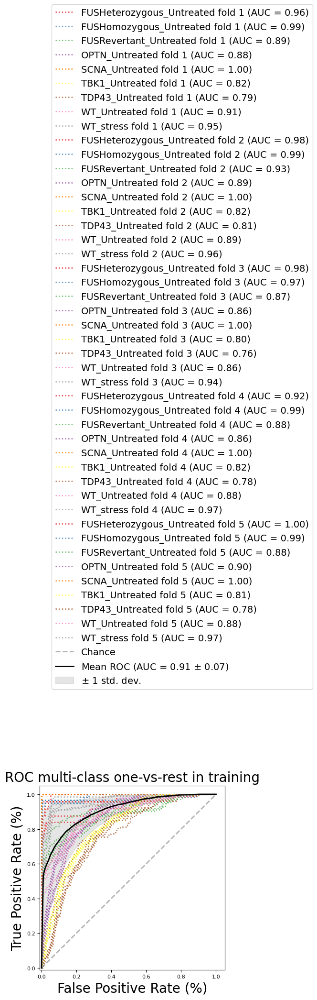



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.95743824 0.99171159 0.88938607 0.8756554  1.         0.81647029
 0.79055467 0.90960428 0.95126468 0.9797043  0.99111486 0.92820593
 0.88976765 1.         0.82109082 0.81165424 0.89165706 0.95749137
 0.97688172 0.97158225 0.86861406 0.85797531 1.         0.80347796
 0.7639004  0.86044521 0.94427765 0.921507   0.98674573 0.88457694
 0.86176027 1.         0.81574682 0.78445324 0.88296285 0.9689323
 0.99511649 0.99144727 0.88074353 0.89514566 1.         0.81183898
 0.78010052 0.87983182 0.97022566] Mean: 0.9069124685741498
Validating - Validate classifier

------------------

Balanced accuracy score: 0.6795039660132244. 
Balanced accuracy score (adjusted): 0.6394419617648776


One-vs-One ROC AUC scores:
0.934211 (macro),
0.915064 (weighted by prevalence)


One-vs-Rest ROC AUC scores:
0.911533 (macro),
0.882387 (weighted by prevalence)


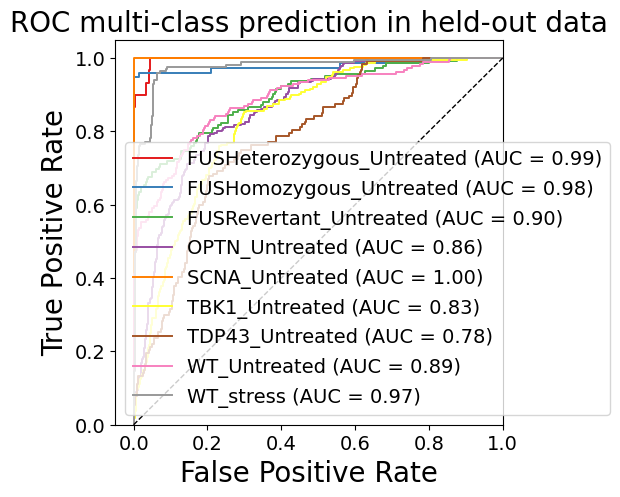

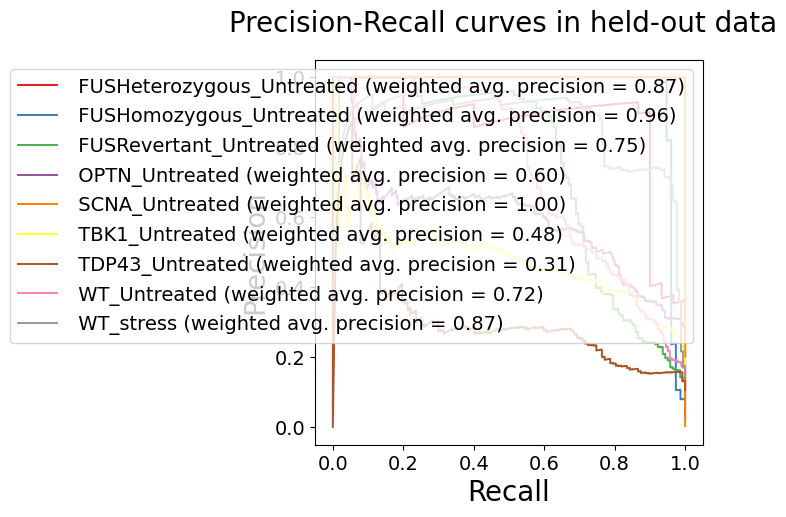

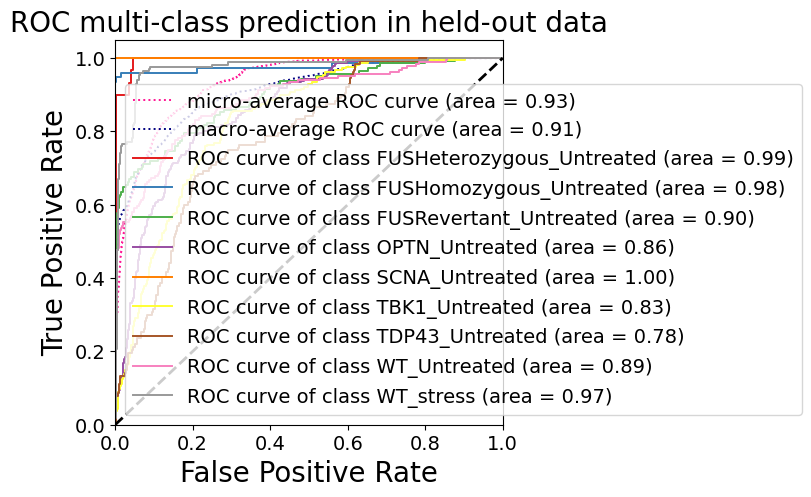


HELDOUT SET - AUC ROC scores of each class: {0: 0.9948982516480367, 1: 0.979468029967488, 2: 0.8967046809879258, 3: 0.859437699130285, 4: 1.0, 5: 0.8300826414951287, 6: 0.7829770575113383, 7: 0.8870205053292215, 8: 0.9732102811799207, 'micro': 0.9322436727515705, 'macro': 0.9119170065906983}
'nHELDOUT SET - Classification Report: 
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.92      0.73      0.81        30
  FUSHomozygous_Untreated       0.94      0.95      0.94        76
   FUSRevertant_Untreated       0.89      0.63      0.74       142
           OPTN_Untreated       0.51      0.75      0.61       245
           SCNA_Untreated       1.00      1.00      1.00         4
           TBK1_Untreated       0.43      0.64      0.51       216
          TDP43_Untreated       0.00      0.00      0.00       127
             WT_Untreated       0.95      0.47      0.63       183
                WT_stress       0.74      0.94      0.83      

/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter t

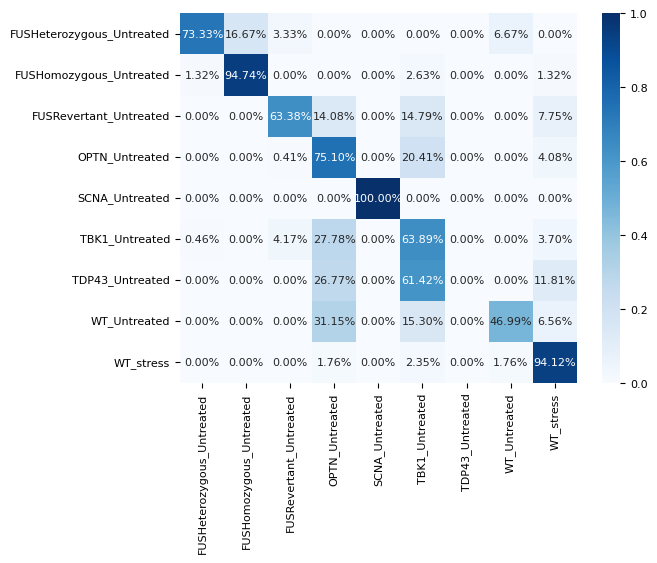


HELDOUT SET - One-vs-rest Confusion Matrix:
[[ 22   5   1   0   0   0   0   2   0]
 [  1  72   0   0   0   2   0   0   1]
 [  0   0  90  20   0  21   0   0  11]
 [  0   0   1 184   0  50   0   0  10]
 [  0   0   0   0   4   0   0   0   0]
 [  1   0   9  60   0 138   0   0   8]
 [  0   0   0  34   0  78   0   0  15]
 [  0   0   0  57   0  28   0  86  12]
 [  0   0   0   3   0   4   0   3 160]]
Sensitivity, hit rate, recall, or true positive rate: [0.73333333 0.94736842 0.63380282 0.75102041 1.         0.63888889
 0.         0.46994536 0.94117647]
Specificity or true negative rate: [0.99828031 0.99552372 0.98953378 0.8164557  1.         0.81269191
 1.         0.9950495  0.94428152]
Precision or positive predictive value: [0.91666667 0.93506494 0.89108911 0.51396648 1.         0.42990654
        nan 0.94505495 0.73732719]
Negative predictive value: [0.99315654 0.99641577 0.95238095 0.92694611 1.         0.91055046
 0.89354568 0.91197822 0.9897541 ]
Fall out or false positive rate: [0.001

/tmp/ipykernel_40869/3679406993.py:198: RuntimeWarning: invalid value encountered in divide
  PPV = TP / (TP + FP)
/tmp/ipykernel_40869/3679406993.py:210: RuntimeWarning: invalid value encountered in divide
  FDR = FP / (TP + FP)


Performance score roc_auc_ovr_weighted on the held-out test-set (25%): 0.633696563285834
################## 100 UMAPS ##################
X_train shape (4771, 100), X_test shape: (1193, 100), y_train shape: (4771,), y_test shape: (1193,)


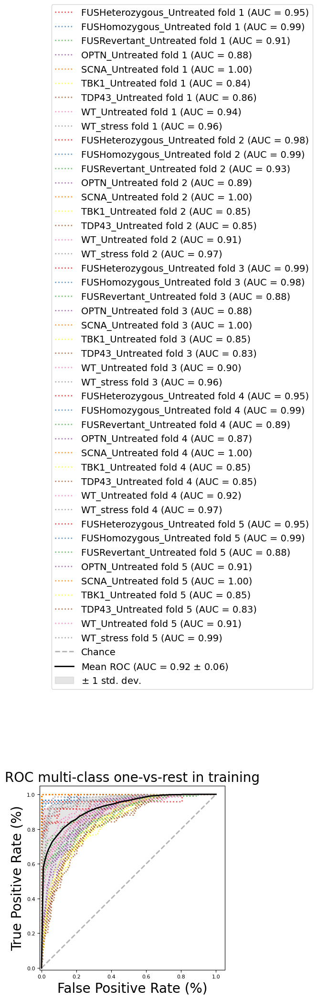



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.95251522 0.99416878 0.90967311 0.88220941 1.         0.83877859
 0.86299795 0.94432497 0.96355014 0.98181004 0.99208782 0.93092105
 0.89411583 1.         0.84770713 0.84623262 0.91067917 0.97071408
 0.99310036 0.97725479 0.87529595 0.87599997 1.         0.84599715
 0.82694698 0.89883697 0.96319035 0.94768568 0.99177574 0.89451033
 0.8721259  1.         0.85319695 0.85143872 0.92424281 0.97148284
 0.95403226 0.99298423 0.88390769 0.90724786 1.         0.85318955
 0.83366801 0.90606775 0.98553792] Mean: 0.9244933921204972
Validating - Validate classifier

------------------

Balanced accuracy score: 0.6042112070418421. 
Balanced accuracy score (adjusted): 0.5547376079220724


One-vs-One ROC AUC scores:
0.946553 (macro),
0.933477 (weighted by prevalence)


One-vs-Rest ROC AUC scores:
0.930603 (macro),
0.909841 (weighted by prevalence)


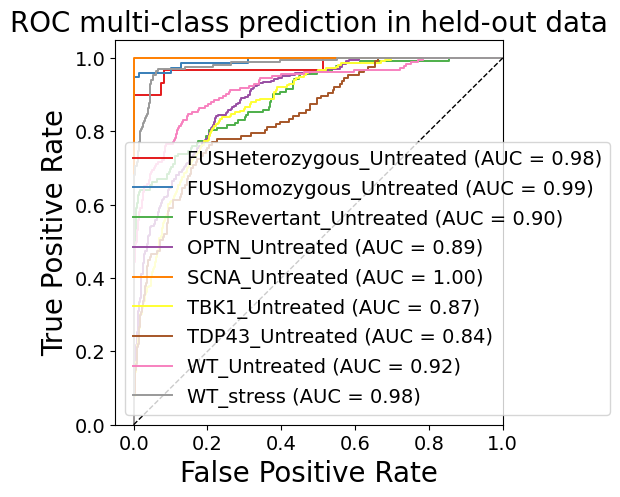

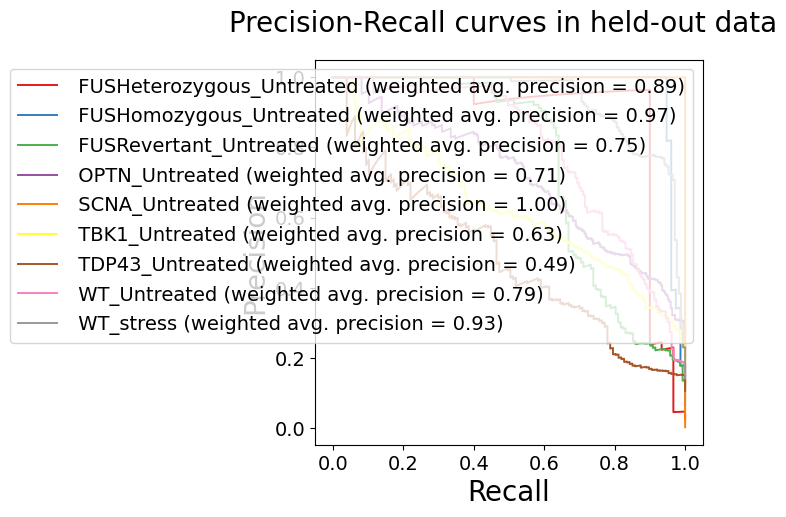

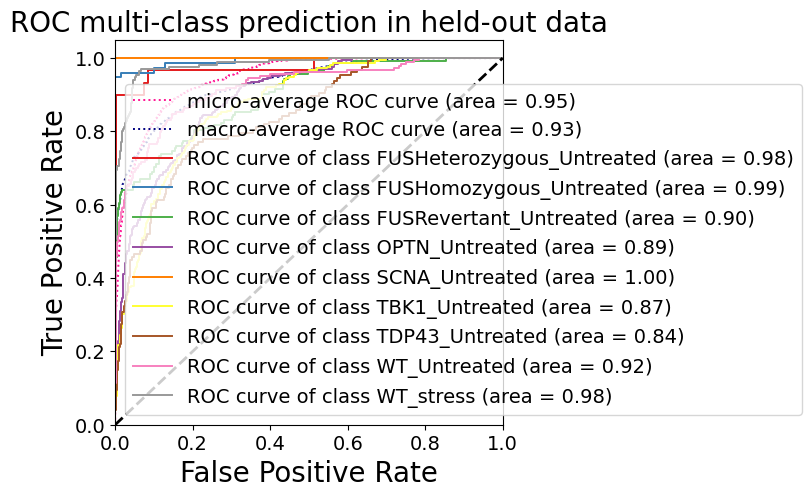


HELDOUT SET - AUC ROC scores of each class: {0: 0.9772141014617369, 1: 0.9927201620883004, 2: 0.8968587931011378, 3: 0.8918970119693447, 4: 1.0, 5: 0.8734931195268965, 6: 0.8412861384822208, 7: 0.9198290320835362, 8: 0.982128687252027, 'micro': 0.9453056000741964, 'macro': 0.9309659486768614}
'nHELDOUT SET - Classification Report: 
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.00      0.00      0.00        30
  FUSHomozygous_Untreated       0.73      0.96      0.83        76
   FUSRevertant_Untreated       0.92      0.54      0.68       142
           OPTN_Untreated       0.51      0.76      0.61       245
           SCNA_Untreated       1.00      1.00      1.00         4
           TBK1_Untreated       0.46      0.67      0.54       216
          TDP43_Untreated       0.65      0.10      0.18       127
             WT_Untreated       0.95      0.47      0.63       183
                WT_stress       0.76      0.94      0.84     

/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter t

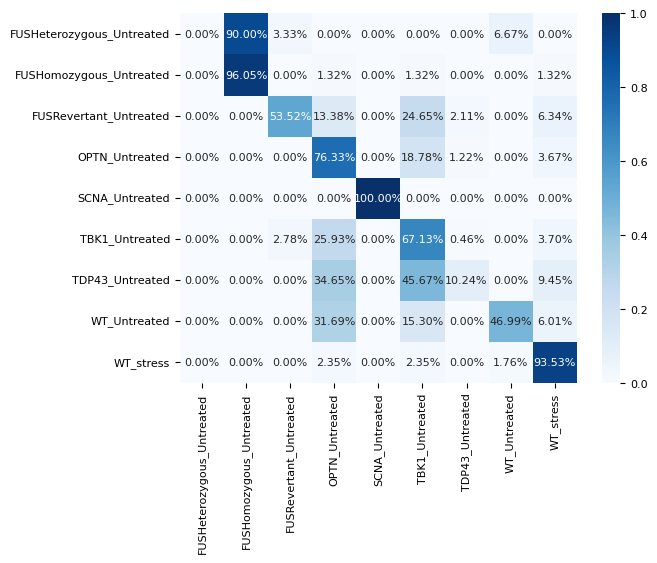


HELDOUT SET - One-vs-rest Confusion Matrix:
[[  0  27   1   0   0   0   0   2   0]
 [  0  73   0   1   0   1   0   0   1]
 [  0   0  76  19   0  35   3   0   9]
 [  0   0   0 187   0  46   3   0   9]
 [  0   0   0   0   4   0   0   0   0]
 [  0   0   6  56   0 145   1   0   8]
 [  0   0   0  44   0  58  13   0  12]
 [  0   0   0  58   0  28   0  86  11]
 [  0   0   0   4   0   4   0   3 159]]
Sensitivity, hit rate, recall, or true positive rate: [0.         0.96052632 0.53521127 0.76326531 1.         0.6712963
 0.1023622  0.46994536 0.93529412]
Specificity or true negative rate: [1.         0.97582811 0.99333968 0.80801688 1.         0.82395087
 0.9934334  0.9950495  0.95112414]
Precision or positive predictive value: [       nan 0.73       0.91566265 0.50677507 1.         0.45741325
 0.65       0.94505495 0.76076555]
Negative predictive value: [0.97485331 0.99725526 0.94054054 0.92961165 1.         0.91894977
 0.9028133  0.91197822 0.98882114]
Fall out or false positive rate: [0.    

/tmp/ipykernel_40869/3679406993.py:198: RuntimeWarning: invalid value encountered in divide
  PPV = TP / (TP + FP)
/tmp/ipykernel_40869/3679406993.py:210: RuntimeWarning: invalid value encountered in divide
  FDR = FP / (TP + FP)


Performance score roc_auc_ovr_weighted on the held-out test-set (25%): 0.622799664710813
!!!! MLP !!!
X_train shape (4771, 100), X_test shape: (1193, 100), y_train shape: (4771,), y_test shape: (1193,)


/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochas

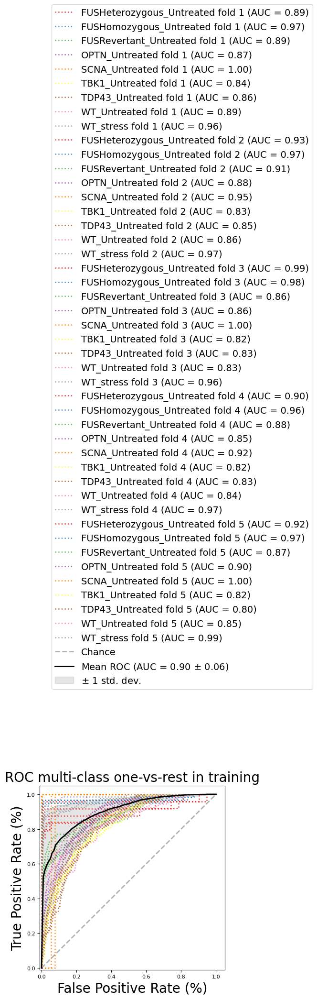



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.89263337 0.97165071 0.88940693 0.86834853 0.99763407 0.84200878
 0.86237731 0.89369592 0.96117435 0.93346774 0.97167404 0.90743525
 0.88191939 0.94567122 0.83154404 0.84637071 0.86018242 0.97331188
 0.98570789 0.97541901 0.85737586 0.86077155 1.         0.81841432
 0.82804014 0.82914858 0.96106896 0.89752422 0.96102656 0.88346153
 0.85483415 0.9232387  0.81781916 0.83419034 0.84040159 0.96743092
 0.925      0.97421525 0.86678154 0.89752167 1.         0.82487992
 0.80478915 0.84797572 0.98513092] Mean: 0.9011705402876967


/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


Validating - Validate classifier

------------------

Balanced accuracy score: 0.5034304217155368. 
Balanced accuracy score (adjusted): 0.4413592244299789


One-vs-One ROC AUC scores:
0.921724 (macro),
0.919429 (weighted by prevalence)


One-vs-Rest ROC AUC scores:
0.921182 (macro),
0.899030 (weighted by prevalence)


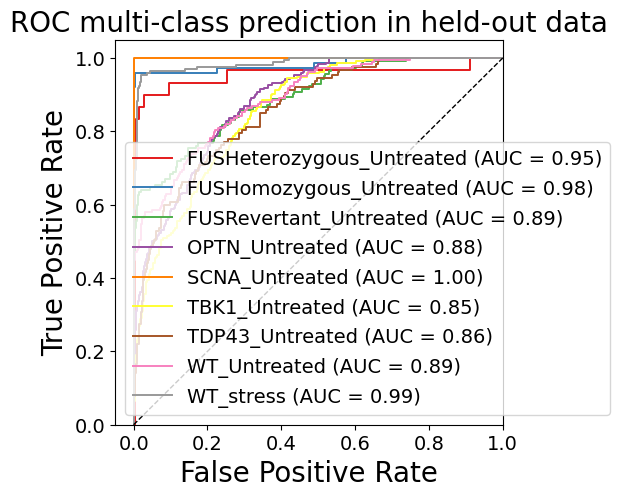

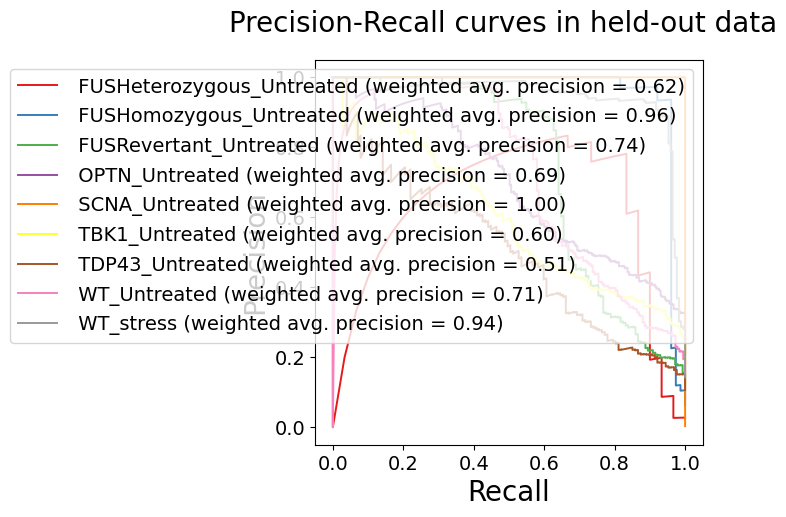

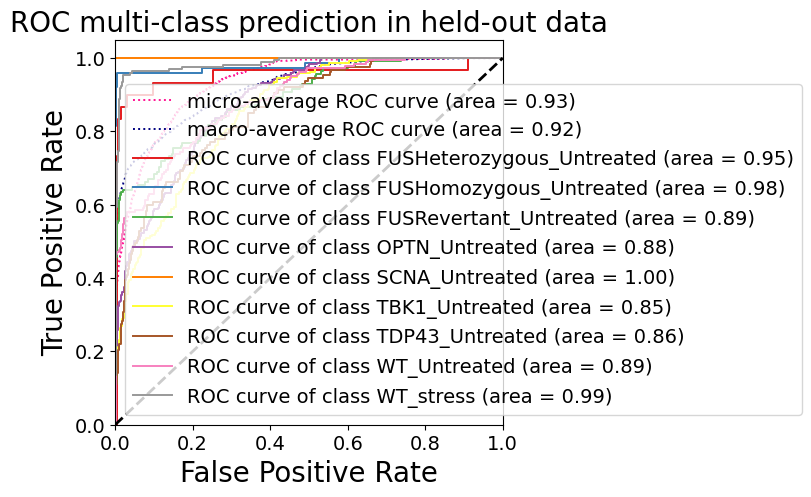


HELDOUT SET - AUC ROC scores of each class: {0: 0.9533104041272571, 1: 0.982648541676483, 2: 0.8916524838852334, 3: 0.8793808662705589, 4: 1.0, 5: 0.8545623412563024, 6: 0.8571228080542466, 7: 0.886630958177785, 8: 0.9853257432005059, 'micro': 0.931210122051728, 'macro': 0.9218025594337866}
'nHELDOUT SET - Classification Report: 
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.00      0.00      0.00        30
  FUSHomozygous_Untreated       0.73      0.96      0.83        76
   FUSRevertant_Untreated       0.72      0.64      0.68       142
           OPTN_Untreated       0.51      0.72      0.60       245
           SCNA_Untreated       0.00      0.00      0.00         4
           TBK1_Untreated       0.48      0.48      0.48       216
          TDP43_Untreated       0.61      0.29      0.39       127
             WT_Untreated       0.86      0.48      0.61       183
                WT_stress       0.70      0.96      0.81       

/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter t

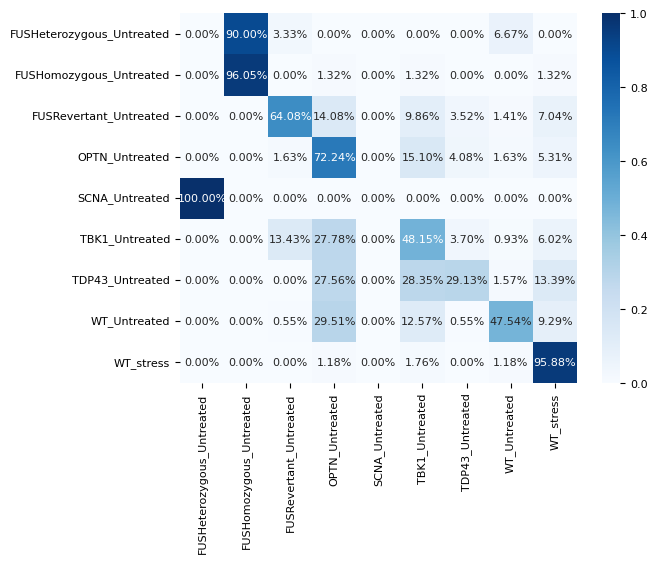


HELDOUT SET - One-vs-rest Confusion Matrix:
[[  0  27   1   0   0   0   0   2   0]
 [  0  73   0   1   0   1   0   0   1]
 [  0   0  91  20   0  14   5   2  10]
 [  0   0   4 177   0  37  10   4  13]
 [  4   0   0   0   0   0   0   0   0]
 [  0   0  29  60   0 104   8   2  13]
 [  0   0   0  35   0  36  37   2  17]
 [  0   0   1  54   0  23   1  87  17]
 [  0   0   0   2   0   3   0   2 163]]
Sensitivity, hit rate, recall, or true positive rate: [0.         0.96052632 0.64084507 0.72244898 0.         0.48148148
 0.29133858 0.47540984 0.95882353]
Specificity or true negative rate: [0.99656062 0.97582811 0.96669838 0.8185654  1.         0.88331627
 0.97748593 0.98613861 0.93059629]
Precision or positive predictive value: [0.         0.73       0.72222222 0.50716332        nan 0.47706422
 0.60655738 0.86138614 0.6965812 ]
Negative predictive value: [0.97476871 0.99725526 0.95220244 0.91943128 0.99664711 0.88512821
 0.9204947  0.91208791 0.99270073]
Fall out or false positive rate: [0.003

/tmp/ipykernel_40869/3679406993.py:198: RuntimeWarning: invalid value encountered in divide
  PPV = TP / (TP + FP)
/tmp/ipykernel_40869/3679406993.py:210: RuntimeWarning: invalid value encountered in divide
  FDR = FP / (TP + FP)


In [18]:
X100 = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_embeddings_batch5_16bit_no_downsample_vqvec2_UMAP100.npy")
X.shape, y.shape


print("################## 2 UMAPS ##################")

svc = SVC(kernel='rbf', random_state=1, probability=True)
fit_eval(svc, X, y)

print("################## 100 UMAPS ##################") # Might be worse since SVC isn't strong enough for 100 features?
svc = SVC(kernel='rbf', random_state=1, probability=True)
fit_eval(svc, X100, y)

print("!!!! MLP !!!")
fit_eval(mlp, X100, y)


################## 100 UMAPS ##################
X_train shape (7642, 100), X_test shape: (1911, 100), y_train shape: (7642,), y_test shape: (1911,)


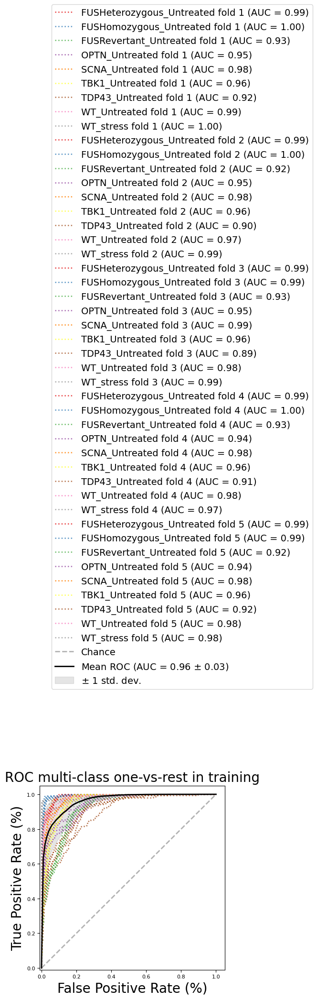



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.98866975 0.99558892 0.92769462 0.94944259 0.9799437  0.96120731
 0.91831008 0.98518202 0.99564577 0.99232273 0.9956501  0.92164183
 0.95076749 0.97882295 0.96384643 0.89624535 0.96662574 0.9924419
 0.99135028 0.99442824 0.92696793 0.94753106 0.98646805 0.9641136
 0.89224041 0.98222023 0.98942277 0.99073806 0.99582118 0.92558232
 0.94392598 0.98069451 0.95716996 0.91229349 0.98372942 0.97441494
 0.98796221 0.99379759 0.91880257 0.93862966 0.97738425 0.95798264
 0.91857292 0.97563636 0.98418935] Mean: 0.9633804275133867
Validating - Validate classifier

------------------

Balanced accuracy score: 0.6978330185971143. 
Balanced accuracy score (adjusted): 0.6600621459217537


One-vs-One ROC AUC scores:
0.966627 (macro),
0.968369 (weighted by prevalence)


One-vs-Rest ROC AUC scores:
0.968326 (macro),
0.970917 (weighted by prevalence)


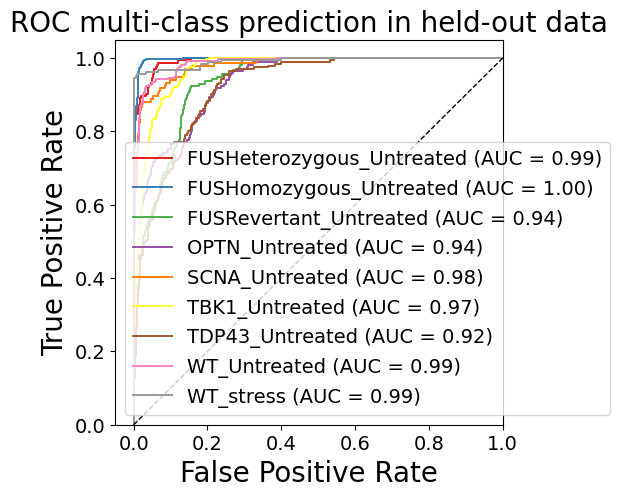

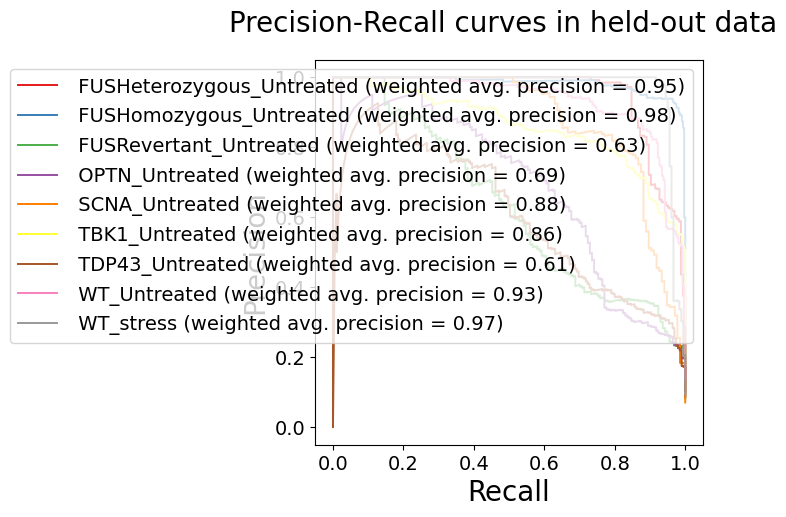

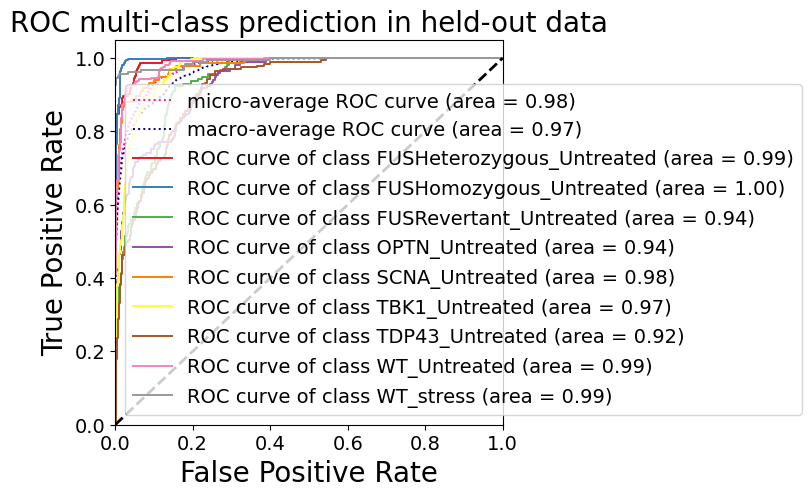


HELDOUT SET - AUC ROC scores of each class: {0: 0.9929740181775029, 1: 0.996800485902937, 2: 0.9378599597643965, 3: 0.9365442443490894, 4: 0.9807474140807474, 5: 0.969486404833837, 6: 0.9228617536309844, 7: 0.9860014912984145, 8: 0.9916586430451249, 'micro': 0.9763409449437707, 'macro': 0.968513649976333}
'nHELDOUT SET - Classification Report: 
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.97      0.85      0.91       164
  FUSHomozygous_Untreated       0.92      0.96      0.94       321
   FUSRevertant_Untreated       0.50      0.02      0.04       157
           OPTN_Untreated       0.65      0.66      0.65       170
           SCNA_Untreated       0.93      0.64      0.76       135
           TBK1_Untreated       0.52      0.99      0.68       331
          TDP43_Untreated       0.80      0.31      0.45       195
             WT_Untreated       0.83      0.91      0.87       258
                WT_stress       0.99      0.93  

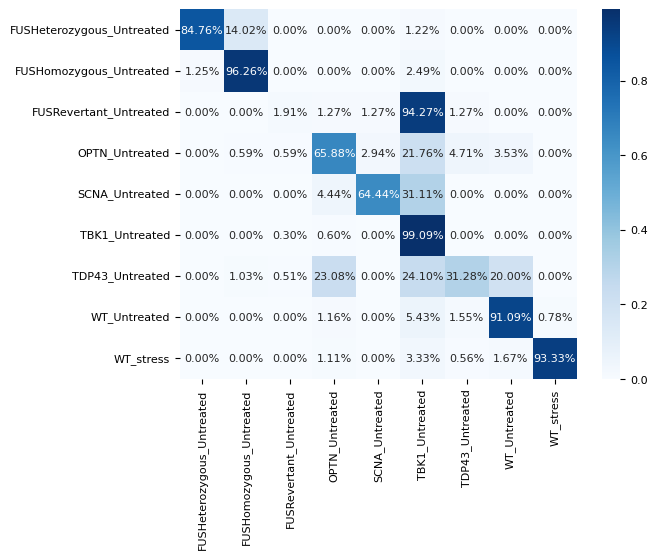


HELDOUT SET - One-vs-rest Confusion Matrix:
[[139  23   0   0   0   2   0   0   0]
 [  4 309   0   0   0   8   0   0   0]
 [  0   0   3   2   2 148   2   0   0]
 [  0   1   1 112   5  37   8   6   0]
 [  0   0   0   6  87  42   0   0   0]
 [  0   0   1   2   0 328   0   0   0]
 [  0   2   1  45   0  47  61  39   0]
 [  0   0   0   3   0  14   4 235   2]
 [  0   0   0   2   0   6   1   3 168]]
Sensitivity, hit rate, recall, or true positive rate: [0.84756098 0.96261682 0.01910828 0.65882353 0.64444444 0.99093656
 0.31282051 0.91085271 0.93333333]
Specificity or true negative rate: [0.99771036 0.9836478  0.99828962 0.96553705 0.99605856 0.80759494
 0.99125874 0.97096189 0.9988446 ]
Precision or positive predictive value: [0.97202797 0.92238806 0.5        0.65116279 0.92553191 0.51898734
 0.80263158 0.83038869 0.98823529]
Negative predictive value: [0.98585973 0.99238579 0.9191601  0.9666475  0.97358283 0.99765442
 0.92697548 0.98587224 0.99310741]
Fall out or false positive rate: [0.002

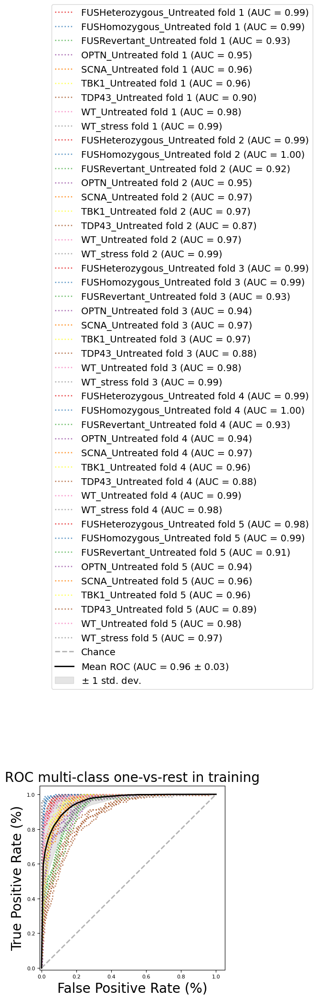



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.9897236  0.99241979 0.92509249 0.94500338 0.96382959 0.95839503
 0.89963957 0.98206494 0.98832481 0.99245378 0.99629249 0.9229429
 0.94790127 0.97024787 0.96966205 0.86977328 0.96981955 0.99356199
 0.99217564 0.9944864  0.92733286 0.94140889 0.96686515 0.96886718
 0.87626149 0.98470617 0.99059188 0.99260138 0.99611201 0.93032644
 0.93808194 0.96888234 0.96163671 0.88488637 0.98533041 0.98236794
 0.98451425 0.99283936 0.91244476 0.93969317 0.95898391 0.96097342
 0.89095556 0.97945522 0.97459558] Mean: 0.958989440721618
Validating - Validate classifier

------------------

Balanced accuracy score: 0.719418775146096. 
Balanced accuracy score (adjusted): 0.6843461220393581


One-vs-One ROC AUC scores:
0.962393 (macro),
0.964788 (weighted by prevalence)


One-vs-Rest ROC AUC scores:
0.964086 (macro),
0.968156 (weighted by prevalence)


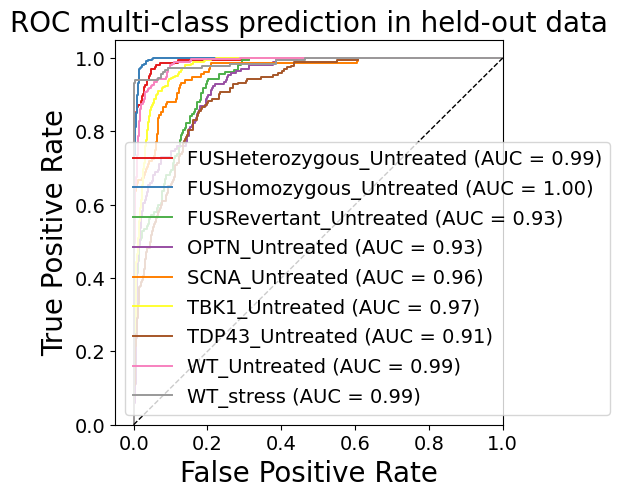

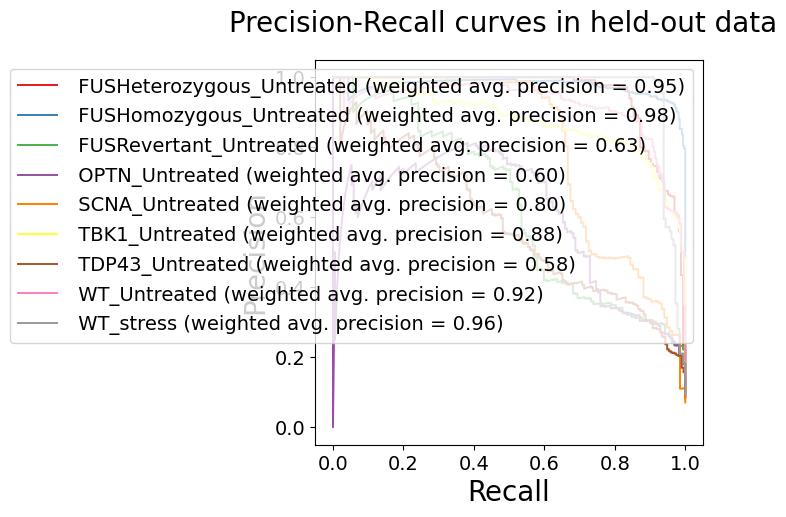

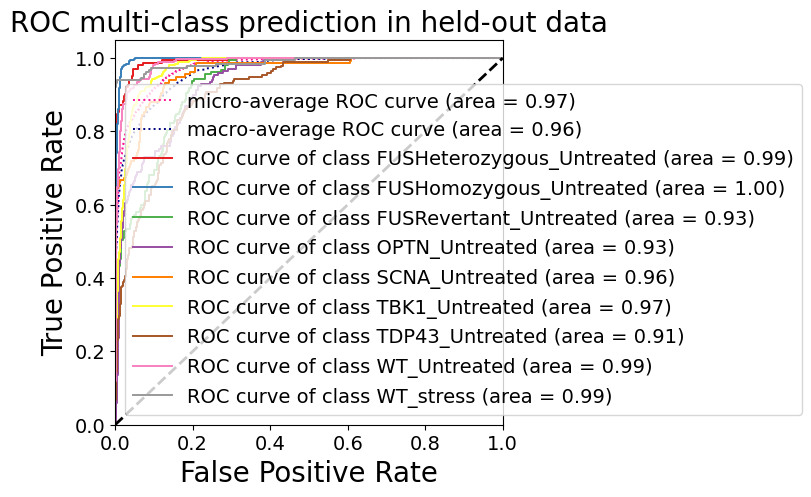


HELDOUT SET - AUC ROC scores of each class: {0: 0.9925167883619306, 1: 0.9964732851348969, 2: 0.9330229720602227, 3: 0.9330911916748319, 4: 0.9620036703370036, 5: 0.9745879383532832, 6: 0.9103490526567449, 7: 0.9867565197409455, 8: 0.9879741960331214, 'micro': 0.9749135112725603, 'macro': 0.9643075539422727}
'nHELDOUT SET - Classification Report: 
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.97      0.84      0.90       164
  FUSHomozygous_Untreated       0.91      0.97      0.94       321
   FUSRevertant_Untreated       0.77      0.32      0.46       157
           OPTN_Untreated       0.60      0.66      0.63       170
           SCNA_Untreated       0.91      0.65      0.76       135
           TBK1_Untreated       0.56      0.96      0.71       331
          TDP43_Untreated       0.74      0.25      0.38       195
             WT_Untreated       0.83      0.90      0.86       258
                WT_stress       0.99      0.9

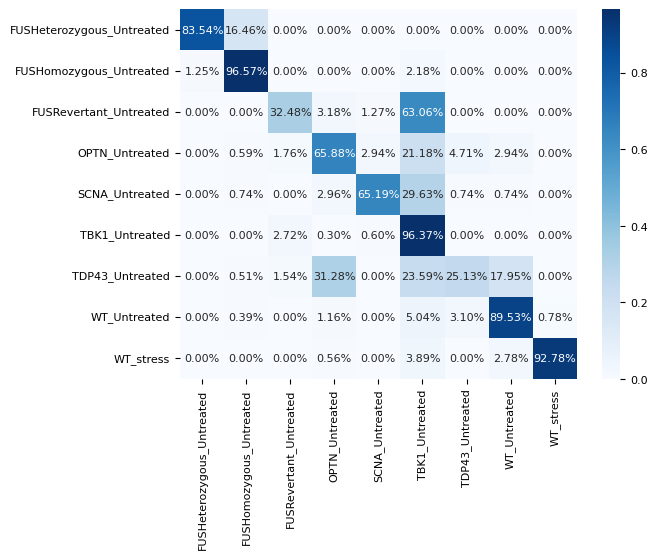


HELDOUT SET - One-vs-rest Confusion Matrix:
[[137  27   0   0   0   0   0   0   0]
 [  4 310   0   0   0   7   0   0   0]
 [  0   0  51   5   2  99   0   0   0]
 [  0   1   3 112   5  36   8   5   0]
 [  0   1   0   4  88  40   1   1   0]
 [  0   0   9   1   2 319   0   0   0]
 [  0   1   3  61   0  46  49  35   0]
 [  0   1   0   3   0  13   8 231   2]
 [  0   0   0   1   0   7   0   5 167]]
Sensitivity, hit rate, recall, or true positive rate: [0.83536585 0.96573209 0.32484076 0.65882353 0.65185185 0.96374622
 0.25128205 0.89534884 0.92777778]
Specificity or true negative rate: [0.99771036 0.98050314 0.99144812 0.95692131 0.99493243 0.84303797
 0.99009324 0.97217181 0.9988446 ]
Precision or positive predictive value: [0.97163121 0.90909091 0.77272727 0.59893048 0.90721649 0.56261023
 0.74242424 0.83393502 0.98816568]
Negative predictive value: [0.98474576 0.99299363 0.94254743 0.96635731 0.97409041 0.99107143
 0.92086721 0.98347613 0.99253731]
Fall out or false positive rate: [0.002

In [11]:
X100 = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_embeddings_batch9_16bit_no_downsample_vqvec2_UMAP100.npy")
X.shape, y.shape

print("################## 100 UMAPS ##################") # Might be worse since SVC isn't strong enough for 100 features?
svc = SVC(kernel='rbf', random_state=1, probability=True)
fit_eval(svc, X100, y)


print("################## 2 UMAPS ##################")

fit_eval(svc, X, y)

X_train shape (7642, 100), X_test shape: (1911, 100), y_train shape: (7642,), y_test shape: (1911,)


/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


Using label binarize
(1529, 9) (1529, 9)


/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


Using label binarize
(1529, 9) (1529, 9)


/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


Using label binarize
(1528, 9) (1528, 9)


/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


Using label binarize
(1528, 9) (1528, 9)


/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


Using label binarize
(1528, 9) (1528, 9)


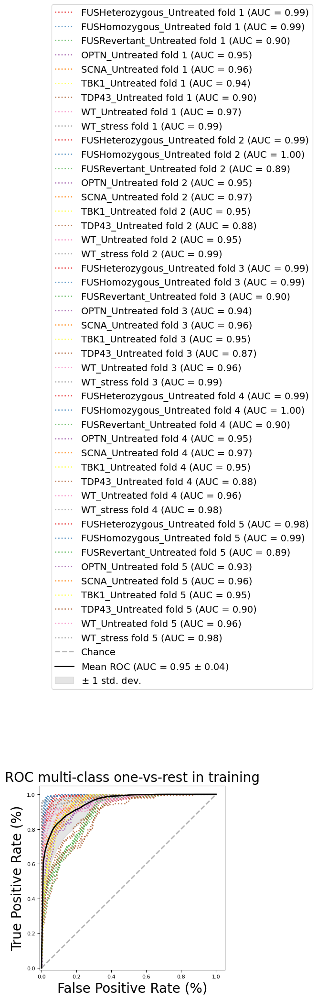



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.99061364 0.99489453 0.89755513 0.94866665 0.95948341 0.93853594
 0.90122229 0.9663334  0.99093835 0.99267765 0.9955308  0.89142314
 0.9511581  0.97051503 0.95340041 0.87745812 0.95283826 0.99232586
 0.99239573 0.99445579 0.90064148 0.941018   0.96311526 0.95395808
 0.87263587 0.95635842 0.990908   0.99078724 0.99652836 0.89834355
 0.94500013 0.9716689  0.95335156 0.88094304 0.96458734 0.98400871
 0.98423011 0.99184135 0.88829081 0.93417883 0.9561133  0.94794066
 0.89775828 0.95889209 0.98433486] Mean: 0.952441253885995


/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


Validating - Validate classifier

------------------

Balanced accuracy score: 0.6999914974165105. 
Balanced accuracy score (adjusted): 0.6624904345935743


One-vs-One ROC AUC scores:
0.957088 (macro),
0.959070 (weighted by prevalence)


One-vs-Rest ROC AUC scores:
0.958610 (macro),
0.962168 (weighted by prevalence)


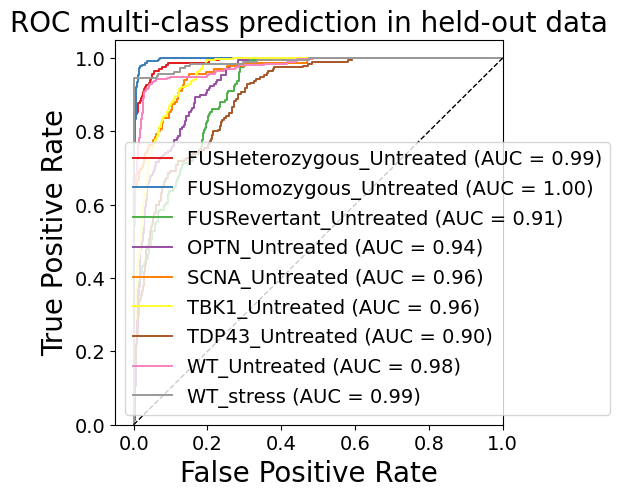

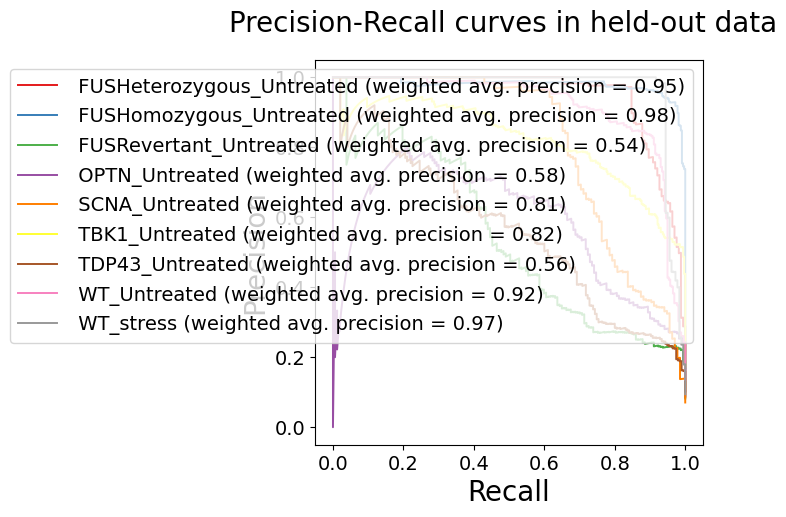

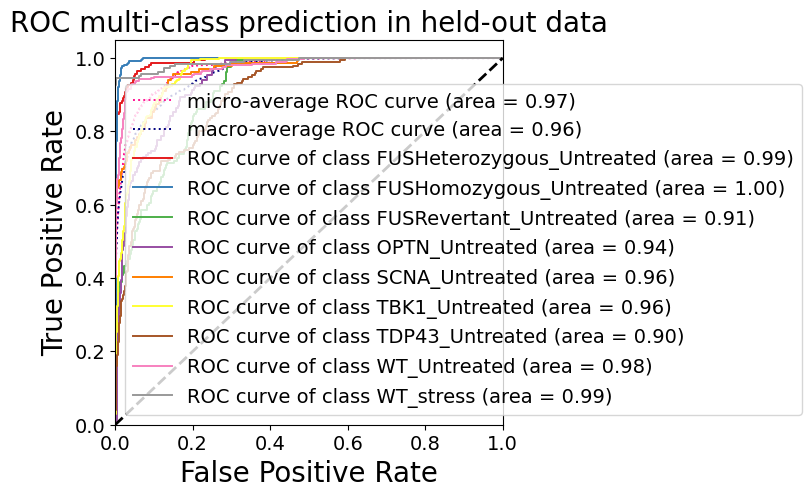


HELDOUT SET - AUC ROC scores of each class: {0: 0.9917070378488558, 1: 0.9965790865808499, 2: 0.9098475549971312, 3: 0.9396830759874312, 4: 0.9635301968635303, 5: 0.9608168572411947, 6: 0.8986342717111948, 7: 0.9772225270473698, 8: 0.9894730085371334, 'micro': 0.970608619408799, 'macro': 0.9588109518455404}
'nHELDOUT SET - Classification Report: 
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.90      0.85      0.88       164
  FUSHomozygous_Untreated       0.93      0.93      0.93       321
   FUSRevertant_Untreated       0.55      0.14      0.22       157
           OPTN_Untreated       0.63      0.66      0.64       170
           SCNA_Untreated       0.84      0.66      0.74       135
           TBK1_Untreated       0.54      0.96      0.69       331
          TDP43_Untreated       0.77      0.26      0.38       195
             WT_Untreated       0.82      0.90      0.86       258
                WT_stress       0.99      0.93

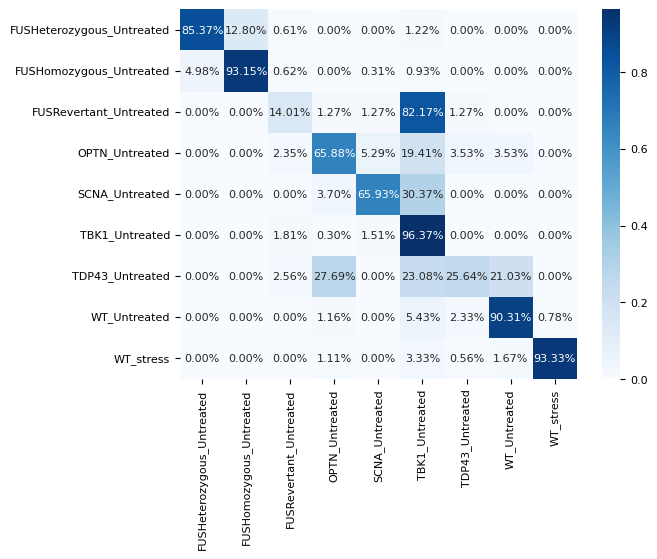


HELDOUT SET - One-vs-rest Confusion Matrix:
[[140  21   1   0   0   2   0   0   0]
 [ 16 299   2   0   1   3   0   0   0]
 [  0   0  22   2   2 129   2   0   0]
 [  0   0   4 112   9  33   6   6   0]
 [  0   0   0   5  89  41   0   0   0]
 [  0   0   6   1   5 319   0   0   0]
 [  0   0   5  54   0  45  50  41   0]
 [  0   0   0   3   0  14   6 233   2]
 [  0   0   0   2   0   6   1   3 168]]
Sensitivity, hit rate, recall, or true positive rate: [0.85365854 0.93146417 0.14012739 0.65882353 0.65925926 0.96374622
 0.25641026 0.90310078 0.93333333]
Specificity or true negative rate: [0.99084144 0.98679245 0.98973774 0.96151637 0.99042793 0.82721519
 0.99125874 0.96975197 0.9988446 ]
Precision or positive predictive value: [0.8974359  0.934375   0.55       0.62569832 0.83962264 0.53885135
 0.76923077 0.82332155 0.98823529]
Negative predictive value: [0.98632479 0.98617222 0.92784607 0.9665127  0.97451524 0.9909022
 0.92145179 0.98464373 0.99310741]
Fall out or false positive rate: [0.0091

In [94]:
X100 = np.load("/home/labs/hornsteinlab/Collaboration/MOmaps_Sagy/MOmaps/outputs/models_outputs_batch78_nods_tl_ep23/features/sm_embeddings_batch9_16bit_no_downsample_vqvec2_UMAP100.npy")
X.shape, y.shape

fit_eval(mlp, X100, y)

---------------------- Kernel = linear ---------------------
X_train shape (7642, 2), X_test shape: (1911, 2), y_train shape: (7642,), y_test shape: (1911,)


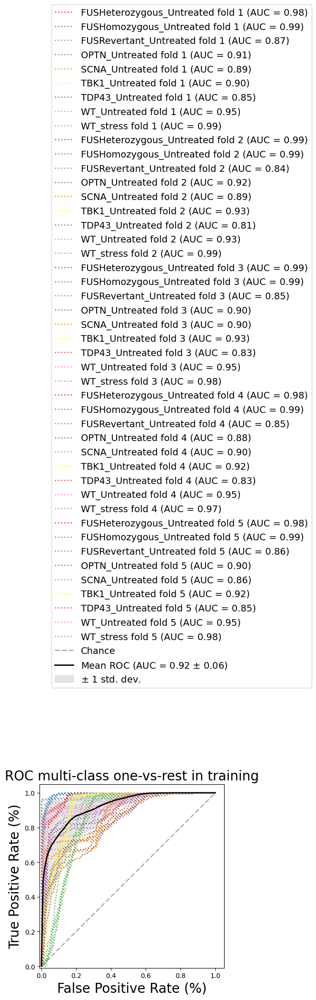



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.98043552 0.99146233 0.87049859 0.90933132 0.88961868 0.90472892
 0.84839487 0.95322926 0.99165481 0.98523518 0.99354856 0.8380002
 0.92368354 0.89339797 0.92852579 0.80901358 0.93177882 0.98895549
 0.9851271  0.99102395 0.84769209 0.89875444 0.90392511 0.92789256
 0.82931057 0.95074027 0.98499217 0.98048709 0.99277201 0.85333713
 0.88139108 0.895365   0.92229642 0.82935262 0.95031065 0.96598025
 0.97735059 0.99006267 0.85837776 0.90027917 0.86489387 0.92330032
 0.85443765 0.94776596 0.97722483] Mean: 0.922576373043151
Validating - Validate classifier

------------------

Balanced accuracy score: 0.6844433537953791. 
Balanced accuracy score (adjusted): 0.6449987730198015


One-vs-One ROC AUC scores:
0.922911 (macro),
0.926905 (weighted by prevalence)


One-vs-Rest ROC AUC scores:
0.924776 (macro),
0.933408 (weighted by prevalence)


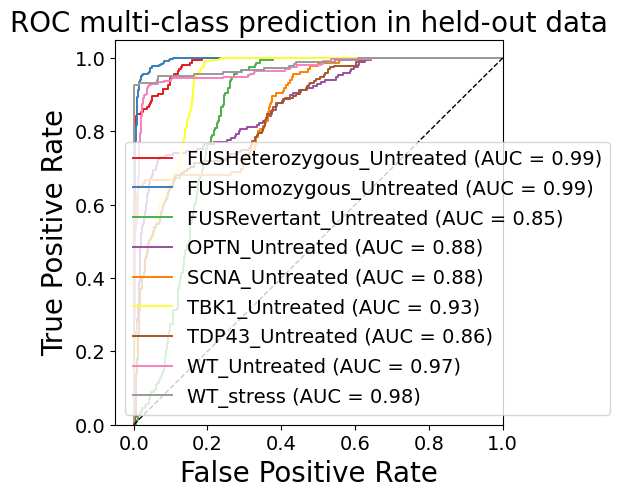

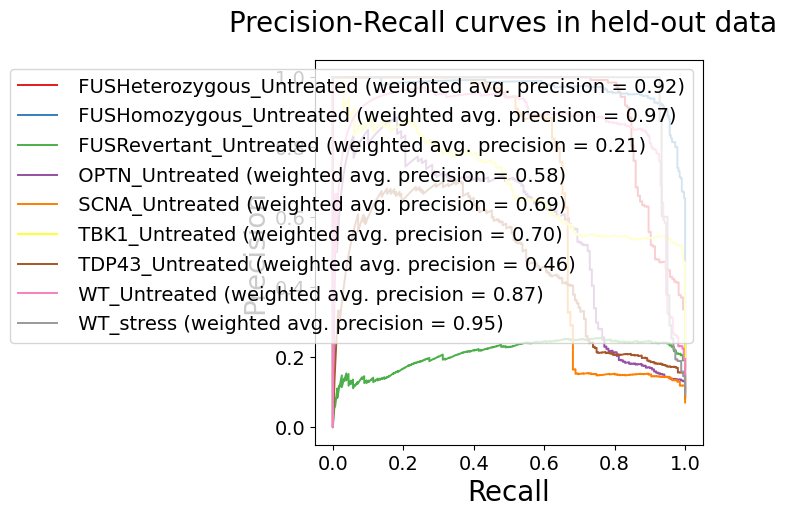

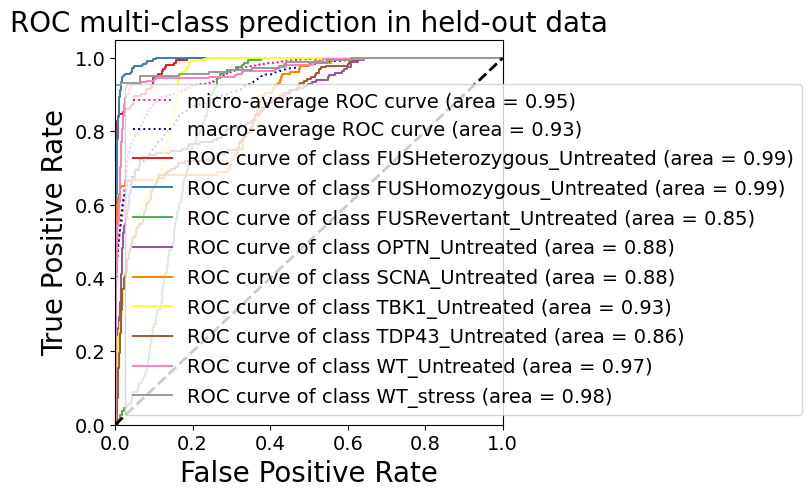


HELDOUT SET - AUC ROC scores of each class: {0: 0.9860597260809472, 1: 0.9941045083171692, 2: 0.8479834990449492, 3: 0.8807176403013819, 4: 0.8777861194527862, 5: 0.9316761635244178, 6: 0.8576474807244039, 7: 0.9676486726037227, 8: 0.9793600359458244, 'micro': 0.953948894294263, 'macro': 0.9250118207597742}
'nHELDOUT SET - Classification Report: 
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.91      0.83      0.87       164
  FUSHomozygous_Untreated       0.90      0.94      0.92       321
   FUSRevertant_Untreated       0.00      0.00      0.00       157
           OPTN_Untreated       0.66      0.61      0.64       170
           SCNA_Untreated       0.83      0.64      0.72       135
           TBK1_Untreated       0.52      0.99      0.68       331
          TDP43_Untreated       0.72      0.32      0.45       195
             WT_Untreated       0.82      0.90      0.86       258
                WT_stress       1.00      0.93

/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter t

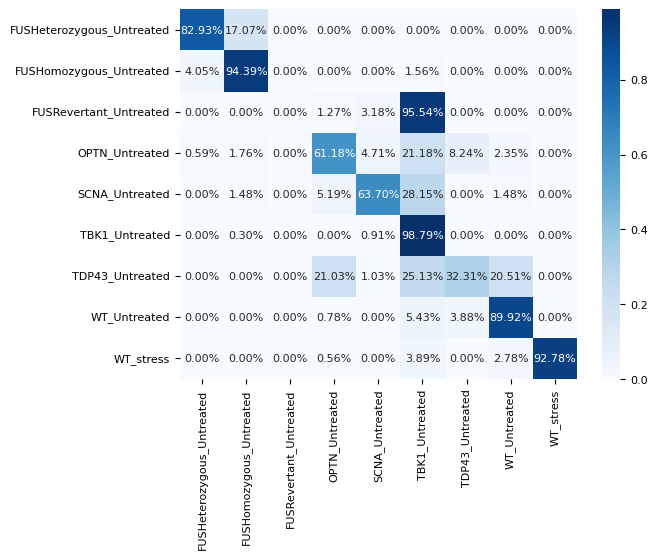


HELDOUT SET - One-vs-rest Confusion Matrix:
[[136  28   0   0   0   0   0   0   0]
 [ 13 303   0   0   0   5   0   0   0]
 [  0   0   0   2   5 150   0   0   0]
 [  1   3   0 104   8  36  14   4   0]
 [  0   2   0   7  86  38   0   2   0]
 [  0   1   0   0   3 327   0   0   0]
 [  0   0   0  41   2  49  63  40   0]
 [  0   0   0   2   0  14  10 232   0]
 [  0   0   0   1   0   7   0   5 167]]
Sensitivity, hit rate, recall, or true positive rate: [0.82926829 0.94392523 0.         0.61176471 0.63703704 0.98791541
 0.32307692 0.89922481 0.92777778]
Specificity or true negative rate: [0.99198626 0.97861635 1.         0.96955773 0.98986486 0.81075949
 0.98601399 0.96914701 1.        ]
Precision or positive predictive value: [0.90666667 0.89910979        nan 0.66242038 0.82692308 0.52236422
 0.72413793 0.81978799 1.        ]
Negative predictive value: [0.98409994 0.98856417 0.91784406 0.96237172 0.97288323 0.99688716
 0.92763158 0.98402948 0.99254587]
Fall out or false positive rate: [0.008

/tmp/ipykernel_40869/3679406993.py:198: RuntimeWarning: invalid value encountered in divide
  PPV = TP / (TP + FP)
/tmp/ipykernel_40869/3679406993.py:210: RuntimeWarning: invalid value encountered in divide
  FDR = FP / (TP + FP)


Performance score roc_auc_ovr_weighted on the held-out test-set (25%): 0.7420198848770277
---------------------- Kernel = poly ---------------------
X_train shape (7642, 2), X_test shape: (1911, 2), y_train shape: (7642,), y_test shape: (1911,)


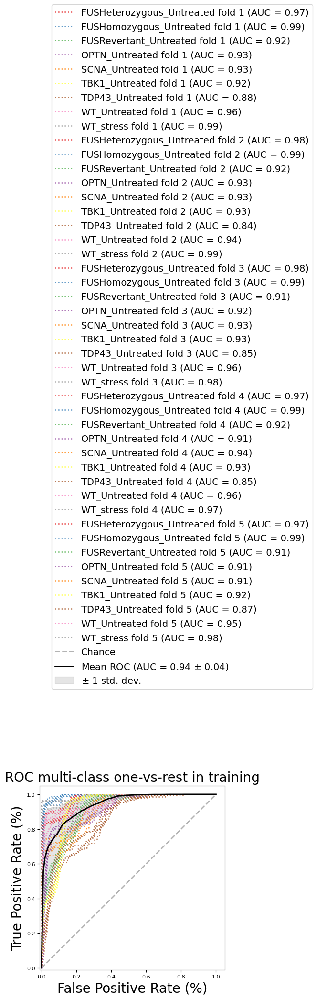



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.97168256 0.98713384 0.91966761 0.92752629 0.92989418 0.92467459
 0.87517975 0.96419201 0.99060535 0.98281624 0.99195177 0.91825906
 0.93262531 0.9270141  0.93236506 0.84120492 0.94073173 0.98860231
 0.98457687 0.98852278 0.91431504 0.91706812 0.93381435 0.9318962
 0.84826568 0.95766197 0.98460079 0.97064047 0.99012083 0.91655025
 0.91349871 0.93596085 0.92682592 0.85250336 0.96275502 0.97069685
 0.97319228 0.99081577 0.90600713 0.91473771 0.90837326 0.92218587
 0.8717902  0.95472805 0.97701911] Mean: 0.939227780116865
Validating - Validate classifier

------------------

Balanced accuracy score: 0.6151151274160848. 
Balanced accuracy score (adjusted): 0.5670045183430955


One-vs-One ROC AUC scores:
0.941644 (macro),
0.944336 (weighted by prevalence)


One-vs-Rest ROC AUC scores:
0.943955 (macro),
0.948604 (weighted by prevalence)


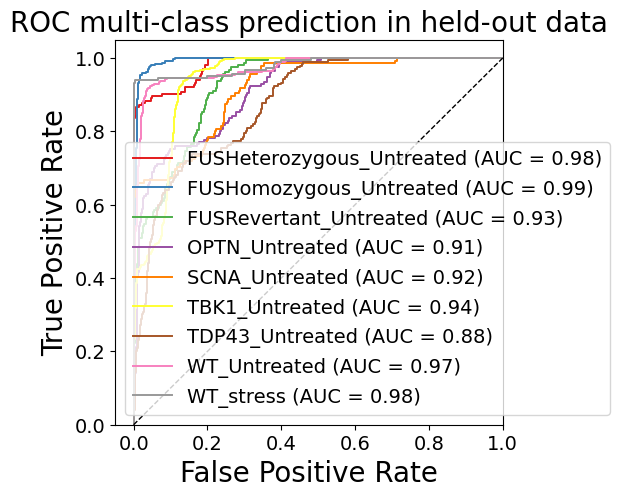

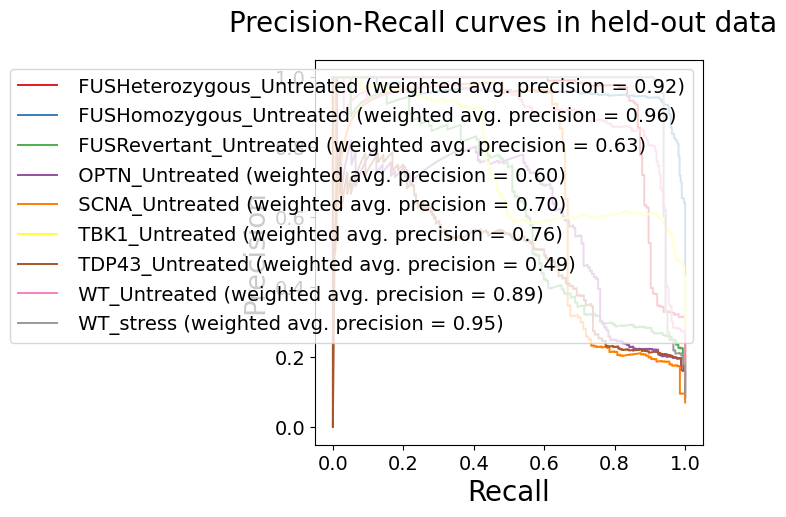

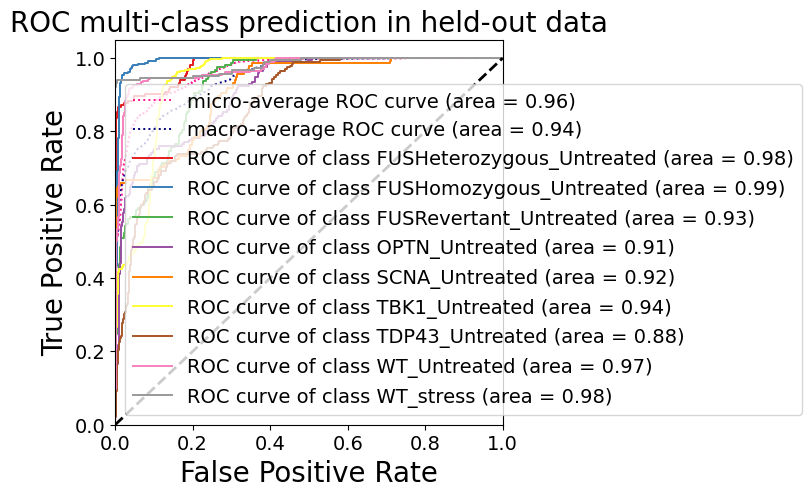


HELDOUT SET - AUC ROC scores of each class: {0: 0.9809254889915814, 1: 0.9929171809792512, 2: 0.9260180551823312, 3: 0.9120045950603102, 4: 0.9152944611277946, 5: 0.9398409116983442, 6: 0.8761759607913453, 7: 0.9720053274056567, 8: 0.9804095256434944, 'micro': 0.961624683283127, 'macro': 0.9442359849249815}
'nHELDOUT SET - Classification Report: 
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.00      0.00      0.00       164
  FUSHomozygous_Untreated       0.64      0.99      0.78       321
   FUSRevertant_Untreated       0.73      0.14      0.24       157
           OPTN_Untreated       0.66      0.61      0.64       170
           SCNA_Untreated       0.92      0.65      0.76       135
           TBK1_Untreated       0.55      0.96      0.70       331
          TDP43_Untreated       0.74      0.36      0.49       195
             WT_Untreated       0.82      0.89      0.86       258
                WT_stress       0.99      0.92

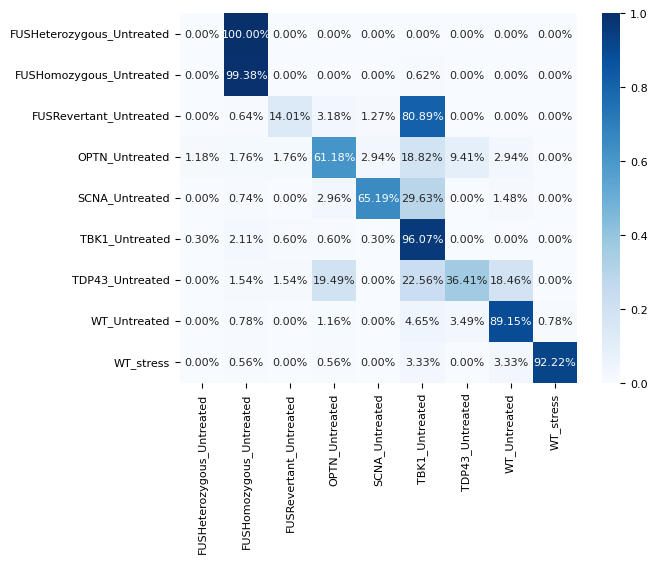


HELDOUT SET - One-vs-rest Confusion Matrix:
[[  0 164   0   0   0   0   0   0   0]
 [  0 319   0   0   0   2   0   0   0]
 [  0   1  22   5   2 127   0   0   0]
 [  2   3   3 104   5  32  16   5   0]
 [  0   1   0   4  88  40   0   2   0]
 [  1   7   2   2   1 318   0   0   0]
 [  0   3   3  38   0  44  71  36   0]
 [  0   2   0   3   0  12   9 230   2]
 [  0   1   0   1   0   6   0   6 166]]
Sensitivity, hit rate, recall, or true positive rate: [0.         0.99376947 0.14012739 0.61176471 0.65185185 0.96072508
 0.36410256 0.89147287 0.92222222]
Specificity or true negative rate: [0.99828277 0.88553459 0.995439   0.96955773 0.9954955  0.8335443
 0.98543124 0.97035693 0.9988446 ]
Precision or positive predictive value: [0.         0.63672655 0.73333333 0.66242038 0.91666667 0.54733219
 0.73958333 0.82437276 0.98809524]
Negative predictive value: [0.91404612 0.99858156 0.92822967 0.96237172 0.97410468 0.99022556
 0.93168044 0.98284314 0.99196787]
Fall out or false positive rate: [0.0017

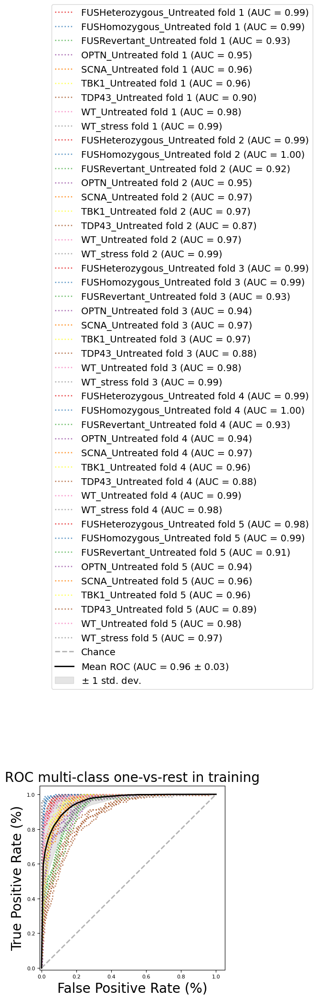



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.9897236  0.99241979 0.92509249 0.94500338 0.96382959 0.95839503
 0.89963957 0.98206494 0.98832481 0.99245378 0.99629249 0.9229429
 0.94790127 0.97024787 0.96966205 0.86977328 0.96981955 0.99356199
 0.99217564 0.9944864  0.92733286 0.94140889 0.96686515 0.96886718
 0.87626149 0.98470617 0.99059188 0.99260138 0.99611201 0.93032644
 0.93808194 0.96888234 0.96163671 0.88488637 0.98533041 0.98236794
 0.98451425 0.99283936 0.91244476 0.93969317 0.95898391 0.96097342
 0.89095556 0.97945522 0.97459558] Mean: 0.958989440721618
Validating - Validate classifier

------------------

Balanced accuracy score: 0.719418775146096. 
Balanced accuracy score (adjusted): 0.6843461220393581


One-vs-One ROC AUC scores:
0.962393 (macro),
0.964788 (weighted by prevalence)


One-vs-Rest ROC AUC scores:
0.964086 (macro),
0.968156 (weighted by prevalence)


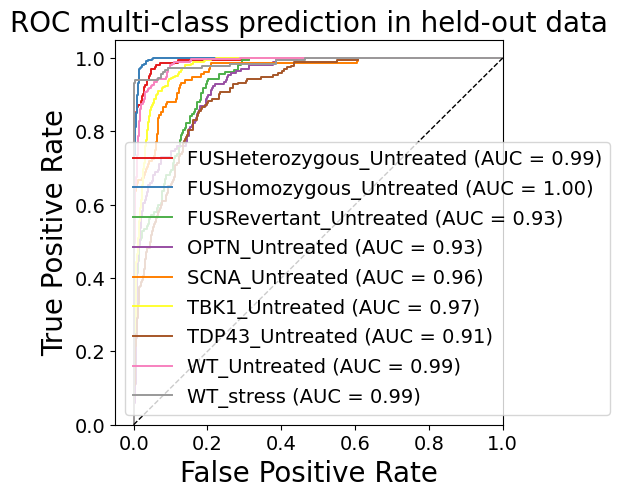

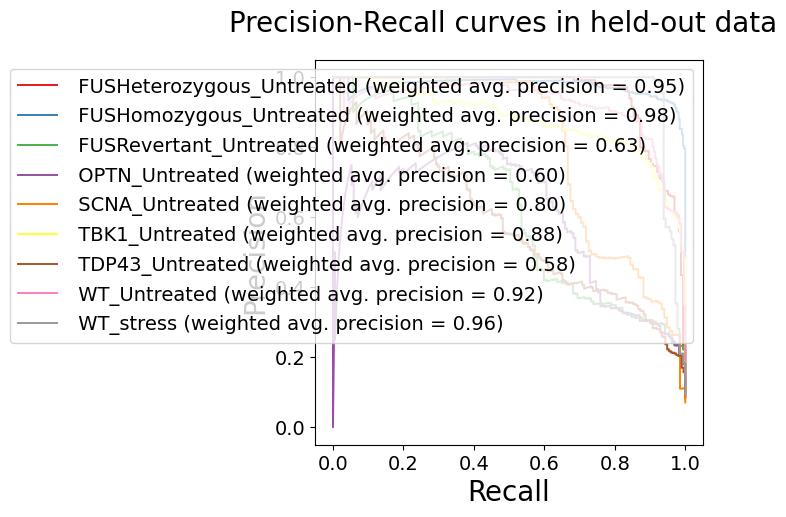

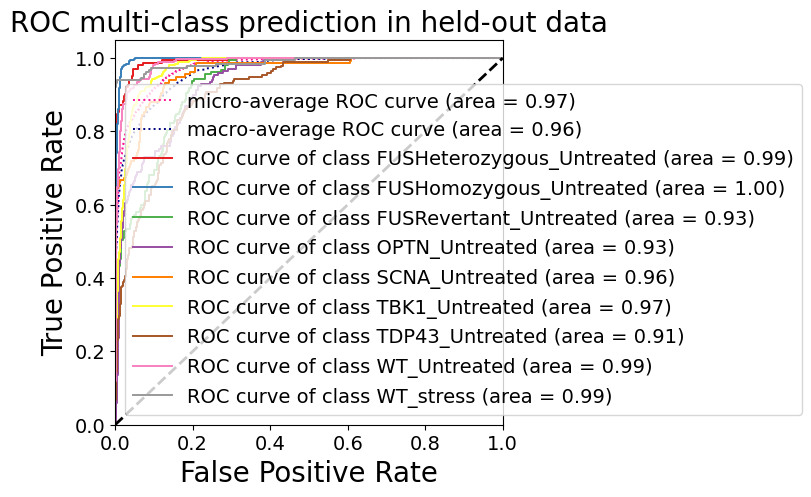


HELDOUT SET - AUC ROC scores of each class: {0: 0.9925167883619306, 1: 0.9964732851348969, 2: 0.9330229720602227, 3: 0.9330911916748319, 4: 0.9620036703370036, 5: 0.9745879383532832, 6: 0.9103490526567449, 7: 0.9867565197409455, 8: 0.9879741960331214, 'micro': 0.9749135112725603, 'macro': 0.9643075539422727}
'nHELDOUT SET - Classification Report: 
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.97      0.84      0.90       164
  FUSHomozygous_Untreated       0.91      0.97      0.94       321
   FUSRevertant_Untreated       0.77      0.32      0.46       157
           OPTN_Untreated       0.60      0.66      0.63       170
           SCNA_Untreated       0.91      0.65      0.76       135
           TBK1_Untreated       0.56      0.96      0.71       331
          TDP43_Untreated       0.74      0.25      0.38       195
             WT_Untreated       0.83      0.90      0.86       258
                WT_stress       0.99      0.9

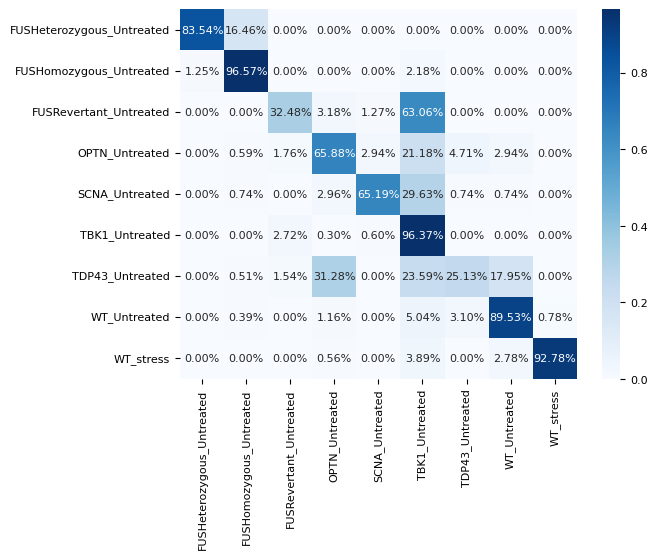


HELDOUT SET - One-vs-rest Confusion Matrix:
[[137  27   0   0   0   0   0   0   0]
 [  4 310   0   0   0   7   0   0   0]
 [  0   0  51   5   2  99   0   0   0]
 [  0   1   3 112   5  36   8   5   0]
 [  0   1   0   4  88  40   1   1   0]
 [  0   0   9   1   2 319   0   0   0]
 [  0   1   3  61   0  46  49  35   0]
 [  0   1   0   3   0  13   8 231   2]
 [  0   0   0   1   0   7   0   5 167]]
Sensitivity, hit rate, recall, or true positive rate: [0.83536585 0.96573209 0.32484076 0.65882353 0.65185185 0.96374622
 0.25128205 0.89534884 0.92777778]
Specificity or true negative rate: [0.99771036 0.98050314 0.99144812 0.95692131 0.99493243 0.84303797
 0.99009324 0.97217181 0.9988446 ]
Precision or positive predictive value: [0.97163121 0.90909091 0.77272727 0.59893048 0.90721649 0.56261023
 0.74242424 0.83393502 0.98816568]
Negative predictive value: [0.98474576 0.99299363 0.94254743 0.96635731 0.97409041 0.99107143
 0.92086721 0.98347613 0.99253731]
Fall out or false positive rate: [0.002

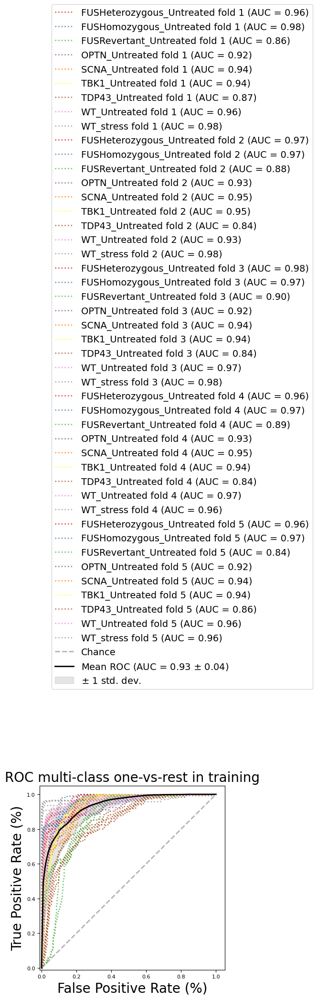



Training dataset (80%): K-Fold Cross Validation score: roc_auc_ovr_weighted [0.95960423 0.97960257 0.85609069 0.92466534 0.93878203 0.93623119
 0.86919902 0.96356713 0.98360226 0.97410696 0.96766329 0.88043195
 0.92847114 0.95041312 0.94908049 0.83823557 0.93358401 0.9818868
 0.97655442 0.96858995 0.90247185 0.92138375 0.94058356 0.94472878
 0.83858488 0.96720914 0.98065691 0.96258067 0.96934305 0.89251033
 0.92599505 0.94814154 0.93677826 0.8358423  0.9706498  0.96016478
 0.96399591 0.96929407 0.84236066 0.91535987 0.93683367 0.94227282
 0.85716155 0.95996064 0.96298972] Mean: 0.9335159047909124
Validating - Validate classifier

------------------

Balanced accuracy score: 0.2150553716256627. 
Balanced accuracy score (adjusted): 0.11693729307887056


One-vs-One ROC AUC scores:
0.933102 (macro),
0.935407 (weighted by prevalence)


One-vs-Rest ROC AUC scores:
0.933584 (macro),
0.940007 (weighted by prevalence)


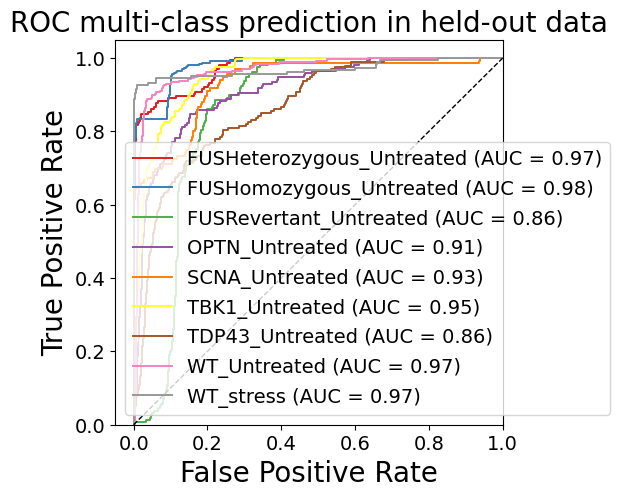

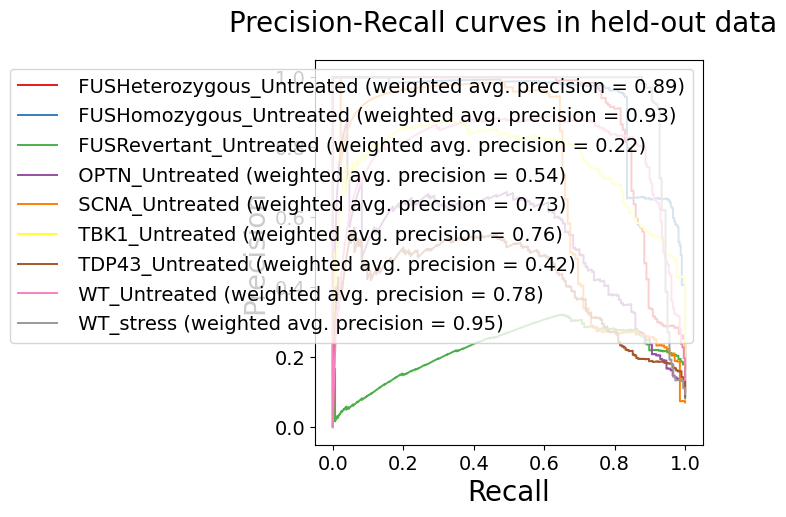

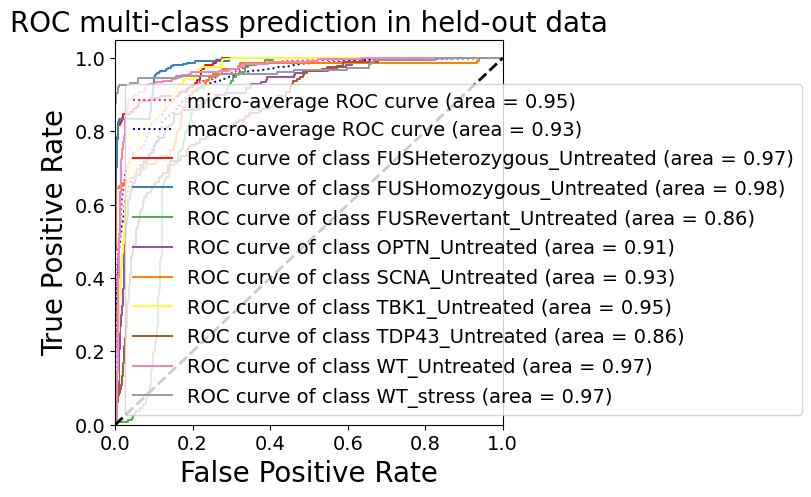


HELDOUT SET - AUC ROC scores of each class: {0: 0.9733131361078922, 1: 0.9793079801720254, 2: 0.8555948550719376, 3: 0.9108794810284826, 4: 0.9308808808808808, 5: 0.9520172855558529, 6: 0.86463152232383, 7: 0.9665466124546866, 8: 0.9690833814750626, 'micro': 0.9478958813731184, 'macro': 0.9339418160172563}
'nHELDOUT SET - Classification Report: 
                           precision    recall  f1-score   support

FUSHeterozygous_Untreated       0.87      0.75      0.81       164
  FUSHomozygous_Untreated       0.76      0.79      0.77       321
   FUSRevertant_Untreated       0.00      0.00      0.00       157
           OPTN_Untreated       0.00      0.00      0.00       170
           SCNA_Untreated       0.00      0.00      0.00       135
           TBK1_Untreated       0.10      0.37      0.16       331
          TDP43_Untreated       0.11      0.03      0.04       195
             WT_Untreated       0.00      0.00      0.00       258
                WT_stress       0.00      0.00 

/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/labs/hornsteinlab/sagyk/anaconda3/envs/cytoself_torch/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter t

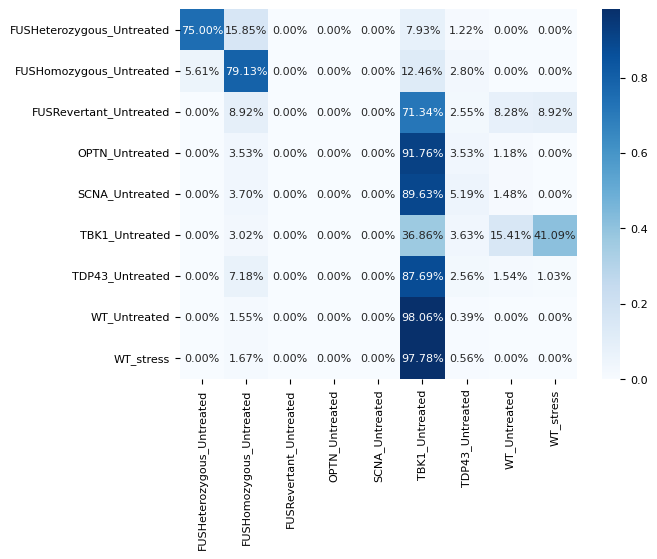


HELDOUT SET - One-vs-rest Confusion Matrix:
[[123  26   0   0   0  13   2   0   0]
 [ 18 254   0   0   0  40   9   0   0]
 [  0  14   0   0   0 112   4  13  14]
 [  0   6   0   0   0 156   6   2   0]
 [  0   5   0   0   0 121   7   2   0]
 [  0  10   0   0   0 122  12  51 136]
 [  0  14   0   0   0 171   5   3   2]
 [  0   4   0   0   0 253   1   0   0]
 [  0   3   0   0   0 176   1   0   0]]
Sensitivity, hit rate, recall, or true positive rate: [0.75       0.79127726 0.         0.         0.         0.36858006
 0.02564103 0.         0.        ]
Specificity or true negative rate: [0.98969662 0.94842767 1.         1.         1.         0.34050633
 0.97552448 0.95704779 0.91218949]
Precision or positive predictive value: [0.87234043 0.75595238        nan        nan        nan 0.104811
 0.10638298 0.         0.        ]
Negative predictive value: [0.97683616 0.95746032 0.91784406 0.91104134 0.92935636 0.72021419
 0.89806867 0.85978261 0.89766913]
Fall out or false positive rate: [0.01030

/tmp/ipykernel_40869/3679406993.py:198: RuntimeWarning: invalid value encountered in divide
  PPV = TP / (TP + FP)
/tmp/ipykernel_40869/3679406993.py:210: RuntimeWarning: invalid value encountered in divide
  FDR = FP / (TP + FP)


Performance score roc_auc_ovr_weighted on the held-out test-set (25%): 0.26373626373626374


In [8]:
# SVC
kernels = ['linear', 'poly', 'rbf', 'sigmoid']



for kernel in kernels:
    print(f"---------------------- Kernel = {kernel} ---------------------")
    svc = SVC(kernel=kernel, random_state=1, probability=True)
    fit_eval(svc, X, y)

---------------

### Eval

In [ ]:
mlp = mlp.fit(X9, y9)

In [ ]:

val_classifier(mlp, X5, y5.reshape(-1,), np.unique(y5.reshape(-1,)))

### Fit & Eval

#### vqvec1

In [ ]:
fit_eval(mlp, X, y)

#### vqvec2

In [ ]:
fit_eval(mlp, X, y)

#### y shuffled

##### vqvec1

In [ ]:
y_shuffled = np.copy(y)
np.random.shuffle(y_shuffled)
fit_eval(rfc, X, y_shuffled)

##### vqvec2

In [ ]:
y_shuffled = np.copy(y)
np.random.shuffle(y_shuffled)
fit_eval(mlp, X, y_shuffled)